# **Exploring Biomass with GEDI Level 4A - Footprint Level Aboveground Biomass Density, Version 2 & GEDI L4B Gridded Aboveground Biomass Density, Version 2.1**


<figure>
  <img src="https://earthdata.nasa.gov/s3fs-public/styles/hds_hero_half/public/2024-08/gedi-agbd-us-cloudfree--2-07-2023.jpg?VersionId=E_Zx.ti84WTiK8GB2XWD5VqrwZi7QNDl&itok=cjabduMn" alt="Trulli" style="width:100%">
  <figcaption align="center"> Fig.1. "GEDI Level 4A - Footprint Level agbd over the eastern United States of America, 2/07/2023." -
    <a href="https://earthdata.nasa.gov/s3fs-public/styles/hds_hero_half/public/2024-08/gedi-agbd-us-cloudfree--2-07-2023.jpg?VersionId=E_Zx.ti84WTiK8GB2XWD5VqrwZi7QNDl&itok=cjabduMn" target="_blank">
       Earthdata.
    </a>
  </figcaption>
</figure>



## Contact Info

**Email**: timothy.j.mayer@nasa.gov | stephanie.a.jimenez@nasa.gov | cae4297@gmail.com

**Organization**: EarthRISE

**Website**: XXXXXXXX

**For additional scientific background, examples, and resources on GEDI and its applications**: https://servir.github.io/GEDI_Earthhub_ARSET_Training/

**Date last modified**: 08-29-2025

Funding for this work was provided through the cooperative agreement 80MSFC22N0004 between NASA and UAH. SERVIR was a joint NASA- and USAID-led program.

# What this multi-regional data exploration demonstration offers you:

💻 **Easing access** to GEDI data:

*   **Automated** spatial, temporal, and variable selection for desired GEDI product levels as opposed to bulk or manual downloads with limited specifications.
*   Local and Google colab/temporary **on-the-fly** processing, storage, data exploration, and processing before final formatting and download.
*   **Singular platform** (Google colab) **for multi-technical and scientific process handling** such access to data center platforms, APIs, and within script mapping, statistics, and visualizations.


🧮 **Demonstration** of data exploration and processing techniques


*   Walk-through a suggested process for **taking key data charactersitics into account for your application**.
*   **Explore data availability** potentially impacted by spatial, temporal, data attribute, and location or use case contextual characteristics.
* **Investigate** several *currently* **recommended processing techniques** with statistics and visualizations.

💡 **Exemplifying real-world challenges** over selected locations:


*   Walk-through a suggested process for **scrutinizing your application and the viability of GEDI for your purposes**.
*   Investigate **GEDI availability and characteristic variations** across study areas.
*   **Compare study area characteristics and the relationships** to GEDI sensor capabilities.
*   Consider potential advantages or challenges to using GEDI over the study area **under given contexts**.

🪄 Detailed coding **documentation**


*  **Learn how** the code, libraries, and APIs function.
*  **Understand where** specifications and adjustments can be made for your application.



---

## Tutorial Overview
<ol>
  <li>Setup your environment and directories</li>
  <li>Access, filter and download the raw GEDI L4A HDF5 files and L4B TIF:
    <ol type="a">
      <li>Authenticate your EarthData Access login</li>
      <li>Create the Harmony API data product, spatial, and temporal request parameters and download the GEDI files</li>
    </ol>
  </li>
  <li>Subset the desired GEDI variables and convert the data to GeoDataFrame and CSV formats</li>
  </li>
  <li>Explore data quality filtering techniques</li>
  </li>
  <li>Generate the final dataset</li>
  </li>
  <li>Plot and explore the data</li>
  </li>
  </li>
</ol>


> ***Search for question marks "?" with "cmd + f" or "ctrl + f" to find places in the code where manual changes would need to be when adapting this script to your own study areas, or changing selections in GEDI products or data variables.***
---



## Data Access and Processing Workflow
Link to editable workflow (to be removed at the end) https://docs.google.com/drawings/d/1q49Oa-y9W5X25_Qijg0IuSczzcVrcOX5mVfiyIO_UmE/edit

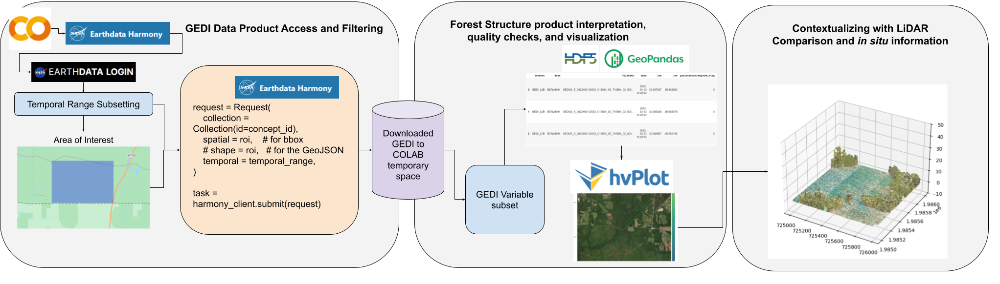

# **Let's start with GEDI Level 4A - Footprint Level Aboveground Biomass Density, Version 2**



---


# Step 1) Setup your environment, and directories
## Tutorial Overview
<ol>
  <li><strong>Setup your environment and directories</strong></li>
  <li>Access, filter and download the raw GEDI HDF5 files:
    <ol type="a">
      <li>Authenticate your EarthData Access login</li>
      <li>Create the Harmony API data product, spatial, and temporal request parameters and download the files</li>
    </ol>
  </li>
  <li>Subset the desired GEDI variables and convert the data to GeoDataFrame and CSV formats
  </li>
  <li>Explore data quality filtering techniques
  </li>
  <li>Generate the final filtered dataset</li>
  </li>
  <li>Plot and explore the data
  </li>
</ol>

**Colab Setup**

![alt text](https://colab.research.google.com/img/colab_favicon.ico)

Google colab is a free, Jupyter notebook style python interface.

Here are some resources on colab:


*   [Welcome to colab](https://colab.research.google.com/)
*   [Beginner's guide to colab](https://www.marqo.ai/blog/getting-started-with-google-colab-a-beginners-guide)
*   [Complete Beginner's Tutorial to Google Colab](https://www.youtube.com/watch?v=JJYZ3OE_lGo)



**Run the pip install to load the required packages**

You may need to re-run the cell if/when the restart prompt is given. Sometimes a re-run is not necessary even if it prompts you to "restart session" if the ✅ shows after the cell runs, you can hit cancel.

▶️Cell needed for plot generation

In [ ]:
!pip install earthaccess harmony-py hvplot folium geopandas geoviews

**Connect to your Google Drive**

This is a relevant step if you are trying to import data hosted on your drive, or to save results from this script to your drive. Importing the final CSV's imported from drive may allow for faster figure generation, if necessary.


▶️Cell needed for plot generation

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


**Make new folders for your colab temporary working space**

Change the folder names here if you are working with other products.

In [ ]:
#? Change the folder names here If you are working with non-L2B products such.
!mkdir GEDI_L4a

#? If you are plugging in AOIs not from this tutorial, change the sub-folder names here.
!mkdir GEDI_L4a/SPB_AOI #?
# !mkdir GEDI_L4a/Prescribed_Burn_AOI #?
!mkdir GEDI_L4a/Sewanee_Domain #?
# !mkdir GEDI_L4a/PaintRock_AOI #?
# !mkdir GEDI_L4a/CentralValley_Almonds #? # very large, may cause timeout issues (better to run as a single aoi)
# !mkdir GEDI_L4a/NewMexico_Pinyon #?
# !mkdir GEDI_L4a/Nepal_Chitwan #? # very large, may cause timeout issues (better to run as a single aoi)
# !mkdir GEDI_L4a/Guatemala_SanBartolo_Flooded #?
# !mkdir GEDI_L4a/Midwest_corn #?

**Change directory to that new folder**

If you are working with other products, change the folder name here.

▶️Cell needed for plot generation

In [ ]:
#? If you are working with non-L2B products, change the folder name here.
%cd /content/GEDI_L4a

/content/GEDI_L4a


**Load the required packages**

▶️Cell needed for plot generation

In [ ]:
# ---------------------------
# Core libraries
# ---------------------------
import os
import json
import ast
from io import StringIO
from datetime import datetime

# ---------------------------
# Data / Analysis
# ---------------------------
import numpy as np
import pandas as pd
import geopandas as gp
import shapely
from shapely.geometry import shape, Point, Polygon, mapping, box
from scipy.stats import pearsonr
import h5py

# ---------------------------
# Visualization
# ---------------------------
import matplotlib as mpl
import matplotlib.pyplot as plt
from matplotlib import cm, colors
from matplotlib.cm import ScalarMappable, get_cmap
from matplotlib.colors import to_hex, Normalize, to_rgba
from mpl_toolkits.mplot3d import Axes3D
import seaborn as sns
import textwrap
import hvplot.pandas
import holoviews as hv
from holoviews import opts

# ---------------------------
# Mapping
# ---------------------------
import folium
from folium import GeoJson
from folium.raster_layers import ImageOverlay

# ---------------------------
# Panel / Widgets
# ---------------------------
import panel as pn
from IPython.display import display, clear_output, JSON, HTML
import ipywidgets as widgets

# ---------------------------
# Remote data access
# ---------------------------
import requests
import earthaccess
from harmony import BBox, Client, Collection, Request, CapabilitiesRequest

# ---------------------------
# Raster / Geo
# ---------------------------
!pip install rasterio
!pip install rioxarray
import rasterio
from rasterio.mask import mask
from rasterio.windows import from_bounds
import rioxarray

os.chdir('../../') #correct the current working directory.



---


# Step 2) Access, filter, and download the raw GEDI HDF5 files


## Tutorial Overview
<ol>
  <li>Setup your environment and directories</li>
  <li><strong>Access, filter and download the raw GEDI HDF5 files:
    <ol type="a">
      <li>Authenticate your EarthData Access login</li>
      <li>Create the Harmony API data product, spatial, and temporal request parameters and download the files</strong></li>
    </ol>
  </li>
  <li>Subset the desired GEDI variables and convert the data to GeoDataFrame and CSV formats</li>
  </li>
  <li>Explore data quality filtering techniques</li>
  </li>
  <li>Generate the final filtered dataset</li>
  </li>
  <li>Plot and explore the data</li>
  </li>
</ol>

## 2.1) Authenticate your EarthData Access login

> Pause here: have your username and password ready.

See the [EarthData Login](https://urs.earthdata.nasa.gov/) if you do not have an account yet.

`earthaccess.login()` is used here to access NASA Earthdata Login (EDL) credentials stored in a .netrc file and allows users to type their credentials and persist them to a .netrc file if one does not exist.

In [ ]:
auth = earthaccess.login(persist=True)
#auth.token

## 2.2) Create a Harmony Request

[NASA's Harmony Services](https://harmony.earthdata.nasa.gov/) provide access to services that can transform data from NASA's [Earth Observing Systems Data and Information System (EOSDIS)](https://www.earthdata.nasa.gov/eosdis) Distributed Active Archive Centers (DAAC). This notebook shows customized query and access of selected GEDI data products housed under the respective NASA DAAC. Visit the [GEDI mission webpage](https://gedi.umd.edu/data/download/) to view which data products are under [NASA's LP DAAC](https://lpdaac.usgs.gov/) or [ORNL DAAC](https://www.earthdata.nasa.gov/centers/ornl-daac).


The [`harmony-py`](https://github.com/nasa/harmony-py) Python package is the recommended way of interacting with Harmony API service. There are several parameters that can be used for the Harmony request. See [the documentation](https://harmony-py.readthedocs.io/en/latest/) and [the introductory Harmony tutorial ](https://github.com/nasa/harmony-py/blob/main/examples/intro_tutorial.ipynb) for more details.


**To access data through Harmony service, create a Harmony Client object using either your EDL token or your Earthdata Login credentials.**

Below, `username` and `password` are directly provided to `Client` function. See [here](https://github.com/nasa/harmony-py/blob/main/examples/intro_tutorial.ipynb) for other options you can create Harmony Client object.

In [ ]:
harmony_client = Client(auth=(auth.username, auth.password))

### 2.2.1) Select the GEDI data product

#### 2.2.1.a) Get the GEDI Collections Harmony API Capabilities

First lets investigate what capabilites Harmony has to request data and choose the dataset.

To investigate GEDI's canopy cover and vegetation metrics, we will use `short_name` = `'GEDI02_B'`.


*   If you are accessing the footprint level raw geolocated waveforms, use `'GEDI01_B'`
*   If you are accessing the footprint level elevation and relative height metrics, use `'GEDI02_A'`
*   If you are accessing the footprint level above ground biomass estimations, adjust to ORNL DAAC & select appropriate DOI for 'GEDI04_A' or 'GEDI04_B'

▶️Cell needed for plot generation

In [ ]:
#gedi_product = 'GEDI02_B' #? Change this variable to select the product level
# GEDI L4A DOI: 10.3334/ORNLDAAC/2056; L4B DOI: 10.3334/ORNLDAAC/2017
DOI = '10.3334/ORNLDAAC/2056'
gedi_product = 'GEDI_L4A' #? Change this variable to select the product level
def get_concept_id(doi):
    """get concept id from DOI using earthaccess"""
    col = earthaccess.search_datasets(doi=doi)
    for ds in col:
        # check if Harmony trajectory service exists
        if 'S2836723123-XYZ_PROV' in ds.services().keys():
            return(ds.concept_id())

concept_id = get_concept_id(DOI)

In the `print()` statement, you can review information such as
`  "conceptId",
  "shortName",
  "variableSubset",
  "bboxSubset",
  "shapeSubset",
  "temporalSubset",
  "concatenate",
  "reproject",
  "outputFormats"`

In [ ]:
#capabilities = harmony_client.submit(CapabilitiesRequest(short_name=gedi_product))
#print(json.dumps(capabilities, indent=2))

#### 2.2.1.b) Get the GEDI Collection Concept ID

`collection` is a required parameter in the Harmony Request function. This collection is determined by the `conceptId`, which is the NASA EOSDIS collection ID.

The concept ID is provided in the Common Metadata Repository [(CMR)](https://cmr.earthdata.nasa.gov/search/site/docs/search/api.html) metadata **OR** a product short name (e.g. 'C2142776747-LPCLOUD') can be provided to search for collections.

▶️Cell needed for plot generation

In [ ]:
# print(capabilities['shortName'], ',', capabilities['conceptId'])

# Save the desired data collection concept ID to a variable
# concept_id = capabilities['conceptId']
print("concept_id:", concept_id)

concept_id: C2237824918-ORNL_CLOUD


### 2.2.2) Establish the spatial filter based on the Areas of Interest (AOIs)



---


**Southern Pine Beetle**

<figure>
  <img src = "https://: alt="Trulli" style="width:100%">
  <figcaption align = "center">Fig.X - .</
figcaption>
</figure>

**Prescribed Burn Area**

<figure style="text-align: center;">
  <video width="960" height="540" controls>
    <source src="https://storage.googleapis.com/planet-t2/prescribed-burn-in-southern-al-1a_Qly-NR/movie.mp4" type="video/mp4">
    Your browser does not support the video tag.
  </video>
  <figcaption>Fig. X – This prescribed burn happened on February 19, 2023 as part of a longleaf pine restoration initiative in Conecuh National Forest close to the town of Wing, Alabama. Approximately 137 acres were estimated to have been treated by broadcast burn with a drip torch to reduce fuels. </figcaption>
</figure>

Prescribed fire (Rx fire) has deep roots in the Southeast, first practiced by Indigenous communities and later by foresters in the 20th century to sustain longleaf pine ecosystems, while much of the West still suppressed fire. Today, agencies such as the [U.S. Forest Service](https://www.fs.usda.gov/managing-land/prescribed-fire) (USFS), [The Nature Conservancy](https://www.nature.org/en-us/) (TNC), the [Alabama Forestry Commission](https://www.forestry.alabama.gov/Pages/Fire/Prescribed_Burning.aspx), and the [Alabama Forestry Foundation](https://alabamaforestryfoundation.org/) continue to use and promote Rx fire, with support from initiatives like the [USDA Longleaf Pine Initiative](https://longleafalliance.org/) and [The Longleaf Alliance](https://longleafalliance.org/).

In Alabama, burns must follow strict protocols that are supervised by certified managers and require permits. The burns are guided by detailed decision making processes that account for weather, fire breaks, and ignition methods. Longleaf ecosystems typically require fire every 2-3 years, and in [Conecuh National Forest](https://www.fs.usda.gov/r08/alabama), Rx burns have been carried out regularly as part of longleaf restoration projects, including the most recent on February 19, 2023.

Despite Conecuh’s success, staffing shortages and limited resources constrain the frequency of Rx fire in other forests and on private lands, where many landowners rely on agencies or contractors. Monitoring also demands significant time for site visits and follow-up surveys. Satellite remote sensing tools like GEDI lidar can help close these gaps by providing data on fuels, structure, and canopy conditions. Metrics such as biomass, plant area index, canopy height, and structural complexity can improve data-driven burn planning, assess fuel loads, and track post-burn recovery, offering broader coverage than field monitoring alone. By supplementing limited staff capacity, GEDI data can strengthen prescribed fire programs and support the long-term health of Alabama’s longleaf pine ecosystems.


**Paint Rock**

<figure>
  <img src = "https://: alt="Trulli" style="width:100%">
  <figcaption align = "center">Fig.X - .</
figcaption>
</figure>

**Sewanee**

<figure>
  <img src = "https://: alt="Trulli" style="width:100%">
  <figcaption align = "center">Fig.X - .</
figcaption>
</figure>



---


#### 2.2.2.a) Setup your AOI specific directories and names.
If you are plugging in your own AOI, change the paths to the subfolders in this variable for folder directory paths used in the data downloaded and variable subsetting steps.

▶️Cell needed for plot generation

In [ ]:
# Create a variable for a list of the output directories where the Harmony Request will handle the files for each AOI
#? If you are plugging in your own AOI, change the paths to the subfolders here.
output_dirs = [
    '/content/GEDI_L4a/SPB_AOI', #?
   # '/content/GEDI_L4a/Prescribed_Burn_AOI', #?
    '/content/GEDI_L4a/PaintRock_AOI', #?
   # '/content/GEDI_L4a/Sewanee_Domain', #?
   # '/content/GEDI_L4a/CentralValley_Almonds', #?
   # '/content/GEDI_L4a/NewMexico_Pinyon', #?
   # '/content/GEDI_L4a/Guatemala_SanBartolo_Flooded', #?
   # '/content/GEDI_L4a/Nepal_Chitwan', #?
   # '/content/GEDI_L4a/Midwest_corn' #?

]

#### 2.2.2.b) Import the AOI data

##### **Option 1**: Access your geojson files uploaded to Github.
Instructions:

For this tutorial, the geojsons are hosted in github and accessed with urls. If you are plugging in your own AOIs, change the name and url path.

▶️Cell needed for plot generation

In [ ]:
# Bring in the AOIs by creating a dictionary for the geojson urls
#? If plugging in your own AOI(s), change the name and url/location path.
geojson_urls = {
    "SPB_AOI": "https://raw.githubusercontent.com/SERVIR/Explore_GEDI_EarthRISE_Training/main/AOIs/SPB_AOI.geojson", #?
   # "Prescribed_Burn_AOI": "https://raw.githubusercontent.com/SERVIR/Explore_GEDI_EarthRISE_Training/main/AOIs/prescribed_burn_aoi.geojson", #?
    "PaintRock_AOI": "https://raw.githubusercontent.com/SERVIR/Explore_GEDI_EarthRISE_Training/main/AOIs/PaintRockAOI.geojson", #?
   # "Sewanee_Domain": "https://raw.githubusercontent.com/SERVIR/Explore_GEDI_EarthRISE_Training/main/AOIs/Sewanee_Domain.geojson", #?
   # "CentralValley_Almonds": 'https://raw.githubusercontent.com/SERVIR/Explore_GEDI_EarthRISE_Training/refs/heads/main/AOIs/CAarea_almonds.geojson', #?
   # "NewMexico_Pinyon": 'https://raw.githubusercontent.com/SERVIR/Explore_GEDI_EarthRISE_Training/refs/heads/main/AOIs/SandiaMtns_North.geojson', #?
   # "Nepal_Chitwan": 'https://raw.githubusercontent.com/SERVIR/Explore_GEDI_EarthRISE_Training/refs/heads/main/AOIs/chitwan.geojson', #?
   # "Guatemala_SanBartolo_Flooded": 'https://raw.githubusercontent.com/SERVIR/Explore_GEDI_EarthRISE_Training/refs/heads/main/AOIs/SanBartolo_FloodedForest.geojson',
   # "Midwest_corn": 'https://raw.githubusercontent.com/SERVIR/Explore_GEDI_EarthRISE_Training/refs/heads/main/AOIs/CornField.geojson'
}

**Convert the geojsons to geodataframes and display the maps**

▶️Cells needed for plot generation

In [ ]:
# Dictionary to store loaded GeoDataFrames (key = name, value = GeoDataFrame)
geojson_url_gdfs = {}

# List to store rendered HTML map strings for embedding in web pages or notebooks
maps_html = []

def create_map_and_gdf(name, url):
    """
    Downloads a GeoJSON file from a given URL, converts it to a GeoDataFrame,
    calculates the centroid of the geometry using Shapely, creates an interactive
    Folium map centered on that centroid, and returns the rendered HTML for display.

    Parameters
    ---
    name : str
        A label or identifier for the dataset (used as the map layer name).
    url : str
        The URL where the GeoJSON data is hosted.

    Returns
    ---
    str
        HTML representation of the Folium map that can be rendered in Jupyter Notebooks
        or embedded into web applications.

    Side Effects
    ---
    Adds the created GeoDataFrame to the global dictionary `geojson_gdfs` with `name` as the key.
    """

    # Download GeoJSON data from the provided URL
    geojson_data = requests.get(url).json()

    # Convert the GeoJSON into a GeoDataFrame
    gdf = gp.GeoDataFrame.from_features(geojson_data["features"])
    geojson_url_gdfs[name] = gdf  # Store in the global dictionary for later use

    # Use Shapely to find the centroid of the first feature
    # Convert the first feature geometry into a Shapely object
    geom = shape(geojson_data['features'][0]['geometry'])
    centroid = geom.centroid
    lat, lon = centroid.y, centroid.x  # Shapely stores coordinates as (x, y) = (lon, lat)

    # Create a Folium map centered on the centroid
    fmap = folium.Map(location=[lat, lon], zoom_start=13, tiles="OpenStreetMap")

    # Add the GeoJSON layer to the map
    folium.GeoJson(geojson_data, name=name).add_to(fmap)

    # Return HTML string of the rendered map
    return fmap._repr_html_()


# Now, generate maps and GeoDataFrames for all URLs
# `geojson_urls` is a dictionary with keys = dataset names, values = GeoJSON URLs
for name, url in geojson_urls.items():
    html_map = create_map_and_gdf(name, url)
    maps_html.append(html_map)

In [ ]:
# Display the maps side by side and add the aoi name to the display
html = f"""
<div style="display: flex; flex-wrap: wrap;">
    {''.join([f'''<div style="flex: 1; min-width: 400px; margin: 5px;">
            <h3 style="text-align: center; margin-bottom: 5px;">{name}</h3>
            {m}</div>''' for name, m in zip(geojson_url_gdfs.keys(), maps_html)])}
</div>
"""

# Display the HTML in the notebook
display(HTML(html))


**Create bounding box objects for each AOI to be used in the Harmony API data request**

▶️Cell needed for plot generation

In [ ]:
# Create a dictionary to store bounding box objects for each dataset for later use
bbox_dict = {}

for name, url in geojson_urls.items():
    # Load the GeoJSON file directly into a GeoDataFrame
    gdf = gp.read_file(url)

    # Extract bounding box coordinates: (min longitude, min latitude, max longitude, max latitude)
    minx, miny, maxx, maxy = gdf.total_bounds

    # Create a BBox object from the extracted coordinates
    bbox = BBox(minx, miny, maxx, maxy)

    # Store the BBox in the dictionary with a key formatted as "<dataset_name>_roi"
    bbox_dict[f"{name}_roi"] = bbox # the _roi suffix helps distinguish the bounding box from the imported geojsons

bbox_dict

{'SPB_AOI_roi': BBox: West:-87.41249365706668, South:34.14940566292299, East:-87.35970778365359, North:34.1864759501938,
 'PaintRock_AOI_roi': BBox: West:-86.31006140840377, South:34.769532701151896, East:-86.30307836070996, North:34.77524552146644}

Ensure your AOI falls within the extents covered by the Internation Space Station:

**Latitude Range:** -51.6° to +51.6° (103.2° total latitudinal coverage)

**Longitude Range:** -180° to +180° (full global coverage)

##### **Option 2:** Access your geojson files located in Google Drive
Uncomment these code blocks to import files from your drive.

Access your data from google drive by connecting to the folder path `'/content/drive/MyDrive/folder-location'`.

Click on the three dots found to the right of the file or folder to find and copy the file or folder path. Access your drives under the folder icon to the left of your colab webpage as shown here:

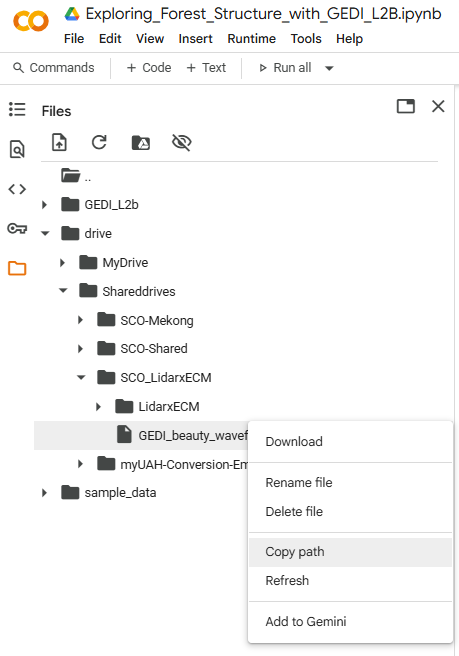


#### 2.2.2.c) Assign the correct directory for each AOI bounding box
This next code block configures the AOI bounding box names (established in the cells above with the suffix `_roi`) and `output_dir` (subfolder) paths. Explicitly naming pairs reduces errors and overall manual checks across all dependent code lines.

▶️Cell needed for plot generation

In [ ]:
#? Define AOI configurations with explicit pairing to ensure correct matching
# The name suffix '_roi' references the AOI bounding box variable, not the geojsons.
# Be sure the 'output_dir' path matches the paths established in the previously defined variable 'output_dirs'
aoi_configs = [
    {'name': 'SPB_AOI_roi', 'output_dir': '/content/GEDI_L4a/SPB_AOI'},
   # {'name': 'Prescribed_Burn_AOI_roi', 'output_dir': '/content/GEDI_L4a/Prescribed_Burn_AOI'},
    {'name': 'PaintRock_AOI_roi', 'output_dir': '/content/GEDI_L4a/PaintRock_AOI'},
   # {'name': 'Sewanee_Domain_roi', 'output_dir': '/content/GEDI_L4a/Sewanee_Domain'},
   # {'name': 'CentralValley_Almonds_roi', 'output_dir': '/content/GEDI_L4a/CentralValley_Almonds'}, # very large, may cause timeout issues (better to run as a single aoi)
   # {'name': 'Guatemala_SanBartolo_Flooded_roi', 'output_dir': '/content/GEDI_L4a/Guatemala_SanBartolo_Flooded'},
   # {'name': 'Nepal_Chitwan_roi', 'output_dir': '/content/GEDI_L4a/Nepal_Chitwan'}, # very large, may cause timeout issues (better to run as a single aoi)
   # {'name': 'NewMexico_Pinyon_roi', 'output_dir': '/content/GEDI_L4a/NewMexico_Pinyon'},
   # {'name': 'Midwest_corn_roi', 'output_dir': '/content/GEDI_L4a/Midwest_corn'}
]

### 2.2.3) Establish the temporal filter based on the application

The GEDI Mission timeline for its launch and data collection periods from the International Space Station [can be found here](https://gedi.umd.edu/mission/timeline/).

> **Important note: there are periods of no data between parts of 2023 and 2024**
> *   ✔  April 4, 2019 - March 16, 2023
> *   ❌ **No data** March 16, 2023 - April 26, 2024
> *   ✔  April 26, 2024 - **Present**

The temporal filter should encompass the period for which your target analysis occurs, with the goal of investigating GEDI availability, capability, or sensitivity to such targets. *For example, if you are investigating plant area (which highly correlates to leaf area) in a deciduous forest experiencing seasonal leaf loss, your results could be skewed by selecting data from leaf-off time period/season.*

> Note: Large temporal ranges may take long to process.

▶️Cell needed for plot generation

In [ ]:
#? Define temporal range to only select data files from this time period
temporal_range = {'start': datetime(2019, 4, 4),
                  'stop': datetime(2025, 8, 14)}

For this tutorial, the most relevant time periods for each AOI relate to the application and purpose of the AOI:

**Southern Pine Beetle (SPB_AOI):** The first evident beetle infestation over this area started in August 2024 and can be seen via Sentinel-2 imagery interpretation (from median composities between August 1 - September 30 for each year 2019-2024).


**Prescribed Burn area (Prescribed_Burn_AOI)**: This area was treated by prescribed burn on February 19, 2023.
*   It is expected that vegetation regrowth was present up until February, 2023
*   It is expected that the burned area will have vegetation regrowth beginning within the first few months after the burn date.

**Paint Rock conservation and research forest (PaintRock_AOI)**
*   Largely left alone. Some large trees all due to storms.

**Sewanee forest (Sewanee_Domain)**
*   

### 2.2.4) Create the Harmony Request task and download spatially and temporally filtered HDF5 files
**Define data tracking functions**


For reference: Some AOIs are quite large and will take up a lot of space and time to download. Keep that in mind incase you'd like to reduce how many or which files to download.

   SPB_AOI_roi/

     └── raw_downloads/ (64 complete files, 151.9 MB)
   Prescribed_Burn_AOI_roi/

     └── raw_downloads/ (24 complete files, 46.96 MB)
   PaintRock_AOI_roi/

     └── raw_downloads/ (12 complete files, 9.39 MB)
   Sewanee_Domain_roi/

     └── raw_downloads/ (68 complete files, 263.33 MB)
   CentralValley_Almonds_roi/

     └── raw_downloads/ (558 complete files, 3.66 GB)
   Guatemala_SanBartolo_Flooded_roi/

     └── raw_downloads/ (30 complete files, 92.03 MB)
   Nepal_Chitwan_roi/
   
     └── raw_downloads/ (214 complete files, 1.21 GB)
   
   NewMexico_Pinyon_roi/

     └── raw_downloads/ (101 complete files, 481.62 MB)

   Midwest_corn_roi/

     └── raw_downloads/ (134 complete files, 695.05 MB)

In [ ]:
def get_file_size(file_path):
    """
    Get the size of a file in bytes.

    Args:
        file_path (str): Path to the file to check

    Returns:
        int: File size in bytes, or 0 if file doesn't exist or cannot be accessed

    Note:
        This function handles common file access errors gracefully by returning 0
        instead of raising exceptions, allowing the download process to continue
    """
    try:
        return os.path.getsize(file_path)
    except (OSError, FileNotFoundError):
        return 0

def format_file_size(size_bytes):
    """
    Convert a file size in bytes to human-readable format.

    Args:
        size_bytes (int): File size in bytes

    Returns:
        str: Formatted file size with appropriate unit (B, KB, MB, GB, TB)

    Examples:
        format_file_size(1024) returns "1.0 KB"
        format_file_size(1048576) returns "1.0 MB"
        format_file_size(0) returns "0 B"
    """
    if size_bytes == 0:
        return "0 B"
    size_names = ["B", "KB", "MB", "GB", "TB"]
    import math
    i = int(math.floor(math.log(size_bytes, 1024)))
    p = math.pow(1024, i)
    s = round(size_bytes / p, 2)
    return f"{s} {size_names[i]}"

Create the request tasks via Harmony and download each file to the respective directories in the temporary colab space.

**The AOI, time period, and GEDI data product level are used to create the request.**

> Note: This step may take a while to finish processing.

In [ ]:
# GEDI HDF5 DATA DOWNLOAD SCRIPT
# Downloads raw GEDI HDF5 files for multiple Areas of Interest (AOI) using Harmony API
# Supports spatial and temporal filtering with complete file downloads

# Global counters for tracking download progress across all AOIs
total_files_downloaded = 0
total_size_bytes = 0

# Display initial download information
print(f"\nStarting data download...")
print(f"Temporal range: {temporal_range['start']} to {temporal_range['stop']}")
print(f"{'='*80}")

# Main download loop - process each AOI configuration sequentially
# Expected variables: aoi_configs (list of dict with 'name' and 'output_dir' keys)
for i, aoi_config in enumerate(aoi_configs):
    spatial_key = aoi_config['name']
    out_dir = aoi_config['output_dir']

    # Display download information
    print(f"\n{'='*60}")
    print(f"Downloading AOI {i+1}/{len(aoi_configs)}: {spatial_key}")
    print(f"Output directory: {out_dir}")
    print(f"{'='*60}")

    # Create main AOI directory structure
    # Each AOI gets its own directory with a raw_downloads subdirectory
    raw_download_dir = os.path.join(out_dir, "raw_downloads")
    print(f"Creating raw downloads directory: {raw_download_dir}")

    try:
        os.makedirs(raw_download_dir, exist_ok=True)
        print(f" ✅ Raw downloads directory created successfully: {raw_download_dir}")

    except Exception as dir_error:
        print(f" ⚠️ Error creating directory {raw_download_dir}: {str(dir_error)}")
        continue  # Skip this AOI if directory creation fails

    # Download complete GEDI HDF5 files using Harmony API
    try:
        # Create Harmony request for complete file download
        # No variables parameter means all variables and beams are included
        # Expected variables: concept_id, bbox_dict, temporal_range
        request = Request(
            collection=Collection(id=concept_id),
            spatial=bbox_dict[spatial_key],
            temporal=temporal_range
        )

        print(f"Request validation: {request.is_valid()}")

        if request.is_valid():
            # Submit the request for complete files
            # Expected variable: harmony_client (initialized Harmony client)
            print(f"Submitting Harmony request for complete files...")
            task = harmony_client.submit(request)
            print(f"Harmony request ID: {task}")

            # Process the request with progress tracking
            # This step waits for Harmony to prepare the files for download
            print(f"Processing Harmony request...")
            task_json = harmony_client.result_json(task, show_progress=True)

            # Download all files from the completed Harmony job
            # Files are saved to raw_download_dir with overwrite enabled
            print(f"Downloading complete files to {raw_download_dir}...")
            results = harmony_client.download_all(task, directory=raw_download_dir, overwrite=True)
            file_names = [f.result() for f in results]

            # Calculate download statistics for this AOI (number of files and size counts)
            raw_files_count = len(file_names)
            raw_size_bytes = 0

            # Sum the file sizes for this AOI
            for file_path in file_names:
                file_size = get_file_size(file_path)
                raw_size_bytes += file_size

            # Update global download counters
            total_files_downloaded += raw_files_count
            total_size_bytes += raw_size_bytes

            # Display AOI-specific download results
            print(f" ✅ Raw download completed")
            print(f"  Files downloaded: {raw_files_count}")
            print(f"  Size: {format_file_size(raw_size_bytes)}")
            print(f"  Running totals - Files: {total_files_downloaded}, Size: {format_file_size(total_size_bytes)}")

        else:
            print(f" Request validation failed for {spatial_key}")

    except Exception as harmony_error:
        # Handle Harmony API errors and continue to the next AOI
        print(f" ⚠️ Harmony processing error for {spatial_key}:")
        print(f" ⚠️ Error: {str(harmony_error)}")
        print(f" ⚠️ Error type: {type(harmony_error).__name__}")
        import traceback
        traceback.print_exc()
        continue  # Continue with next AOI even if one fails

# Display comprehensive download summary
print(f"\n{'='*80}")
print(f" Download Summary:")
print(f"   Total AOIs processed: {len(aoi_configs)}")
print(f"   Total requests submitted: {len(aoi_configs)}")
print(f"   Total raw files downloaded: {total_files_downloaded}")
print(f"   Total data size: {format_file_size(total_size_bytes)}")
print(f"   Average files per AOI: {total_files_downloaded / len(aoi_configs):.1f}")
print(f"   Average size per file: {format_file_size(total_size_bytes / max(total_files_downloaded, 1))}")
print(f"{'='*80}")

print(f"\n Directory Structure:")
for aoi_config in aoi_configs:
    aoi_name = aoi_config['name']
    aoi_dir = aoi_config['output_dir']
    print(f"   {aoi_name}/")

    # Check raw downloads
    raw_dir = os.path.join(aoi_dir, "raw_downloads")
    try:
        raw_files = len([f for f in os.listdir(raw_dir) if os.path.isfile(os.path.join(raw_dir, f))])
        raw_size = sum(get_file_size(os.path.join(raw_dir, f)) for f in os.listdir(raw_dir) if os.path.isfile(os.path.join(raw_dir, f)))
        print(f"     └── raw_downloads/ ({raw_files} complete files, {format_file_size(raw_size)})")
    except OSError:
        print(f"     └── raw_downloads/ (directory not accessible)")

print("✅ Harmony download complete")


Starting data download...
Temporal range: 2019-04-04 00:00:00 to 2025-08-14 00:00:00

Output directory: /content/GEDI_L4a/SPB_AOI
Creating raw downloads directory: /content/GEDI_L4a/SPB_AOI/raw_downloads
 ✅ Raw downloads directory created successfully: /content/GEDI_L4a/SPB_AOI/raw_downloads
Request validation: True
Submitting Harmony request for complete files...
Harmony request ID: fc23aa08-a2b2-4114-b3d8-ac631f64cddb
Processing Harmony request...


 [ Processing: 100% ] |###################################################| [|]


/content/GEDI_L4a/SPB_AOI/raw_downloads/108133155_GEDI04_A_2019216020716_O03637_03_T00051_02_002_02_V002_subsetted.h5
/content/GEDI_L4a/SPB_AOI/raw_downloads/108133157_GEDI04_A_2019263001316_O04365_02_T03688_02_002_02_V002_subsetted.h5
/content/GEDI_L4a/SPB_AOI/raw_downloads/108133158_GEDI04_A_2019298172214_O04919_03_T01627_02_002_02_V002_subsetted.h5
/content/GEDI_L4a/SPB_AOI/raw_downloads/108133156_GEDI04_A_2019230201557_O03866_03_T02897_02_002_02_V002_subsetted.h5
/content/GEDI_L4a/SPB_AOI/raw_downloads/108133159_GEDI04_A_2020068120206_O07009_03_T00051_02_002_02_V002_subsetted.h5
/content/GEDI_L4a/SPB_AOI/raw_downloads/108133160_GEDI04_A_2020084054801_O07253_03_T01627_02_002_02_V002_subsetted.h5
/content/GEDI_L4a/SPB_AOI/raw_downloads/108133161_GEDI04_A_2020088041519_O07314_03_T02897_02_002_02_V002_subsetted.h5
/content/GEDI_L4a/SPB_AOI/raw_downloads/108133162_GEDI04_A_2020196021509_O08987_02_T05264_02_002_02_V002_subsetted.h5
/content/GEDI_L4a/SPB_AOI/raw_downloads/108133164_GEDI04

 [ Processing:   0% ] |                                                   | [/]

Harmony request ID: 6b4dfa20-7cbd-47b5-8fa8-d1dd724694dc
Processing Harmony request...


 [ Processing: 100% ] |###################################################| [|]


/content/GEDI_L4a/PaintRock_AOI/raw_downloads/108133188_GEDI04_A_2019289134028_O04777_02_T05417_02_002_02_V002_subsetted.h5
/content/GEDI_L4a/PaintRock_AOI/raw_downloads/108133187_GEDI04_A_2019168204100_O02904_03_T04427_02_002_02_V002_subsetted.h5
/content/GEDI_L4a/PaintRock_AOI/raw_downloads/108133191_GEDI04_A_2021162214800_O14146_03_T11236_02_002_02_V002_subsetted.h5
/content/GEDI_L4a/PaintRock_AOI/raw_downloads/108133190_GEDI04_A_2021158232053_O14085_03_T02698_02_002_02_V002_subsetted.h5
/content/GEDI_L4a/PaintRock_AOI/raw_downloads/108133199_GEDI04_A_2022348194735_O22688_03_T11236_02_003_01_V002_subsetted.h5
/content/GEDI_L4a/PaintRock_AOI/raw_downloads/108133196_GEDI04_A_2022183060859_O20120_02_T05417_02_003_02_V002_subsetted.h5
 ✅ Raw download completed
  Files downloaded: 6
  Size: 4.69 MB
  Running totals - Files: 30, Size: 55.35 MB

 Download Summary:
   Total AOIs processed: 2
   Total requests submitted: 2
   Total raw files downloaded: 30
   Total data size: 55.35 MB
   Ave



---


# Step 3) Subset the desired GEDI variables from the downloaded files and convert the data to GeoDataFrames and CSVs

## Tutorial Overview
<ol>
  <li>Setup your environment and directories</li>
  <li>Access, filter and download the raw GEDI HDF5 files:
    <ol type="a">
      <li>Authenticate your EarthData Access login</li>
      <li>Create the Harmony API data product, spatial, and temporal request parameters and download the files</li>
    </ol>
  </li>
  <li><strong>Subset the desired GEDI variables and convert the data to GeoDataFrame and CSV formats</strong></li>
  </li>
  <li>Explore data quality filtering techniques</li>
  </li>
  <li>Generate the final filtered dataset</li>
  </li>
  <li>Plot and explore the data</li>
  </li>
</ol>

## 3.1) Subset GEDI by selected variables
The NASA data centers (DAACs) host data product dictionaries with all the necessary formatting, metadata, datatype, unit, and general description information. The exact label is listed for navigating the datasets in each data file.


Take time to explore GEDI variables of importance via the [GEDI L2B dictionary](https://lpdaac.usgs.gov/documents/980/gedi_l2b_dictionary_P003_v2.html) or the [GEDI L4A dictionary](https://www.earthdata.nasa.gov/data/catalog/ornl-cloud-gedi-l4a-agb-density-v2-1-2056-2.1).

▶️Cell needed for plot generation

In [ ]:
# See the append_field.txt url link. This is a long dictionary of the fields for 'GEDI01_B','GEDI02_A','GEDI02_B', and 'GEDI04_A'.
# This dictionary will be used to create the list of variables that will be used to subset the downloaded files.
#? Link to or duplicate this dictionary in your own github or file space to access.
#? If you are accessing GEDI products that are not 1B, 2A, 2B, or 4A, you will need to update the txt file with the corresponding dictionary items.

# Fetch and parse dictionary from remote text file
append_url = "https://raw.githubusercontent.com/SERVIR/Explore_GEDI_EarthRISE_Training/main/append_field.txt"
append_text = requests.get(append_url).text

# Extract dictionary string from text content
start_index = append_text.find("{")
end_index = append_text.rfind("}") + 1
dict_str = append_text[start_index:end_index]

# Convert string representation to actual dictionary object
append_dict = eval(dict_str)

#Display the dictionary we will use to subset later
append_dict

{'GEDI_L1B': ['geolocation/altitude_instrument',
  'geolocation/local_beam_elevation',
  'tx_sample_start_index',
  'nsemean_odd',
  'ancillary/master_time_epoch',
  'noise_stddev_corrected',
  'tx_pulseflag',
  'geolocation/longitude_bin0_error',
  'selection_stretchers_x',
  'nsemean_even',
  'geolocation/latitude_instrument',
  'geolocation/digital_elevation_model',
  'geolocation/longitude_instrument_error',
  'geolocation/longitude_lastbin_error',
  'tx_egsigma',
  'geolocation/neutat_delay_total_bin0',
  'rx_energy',
  'master_frac',
  'rx_sample_count',
  'rxwaveform',
  'tx_gloc',
  'ancillary/mean_samples',
  'geolocation/longitude_instrument',
  'tx_eggamma_error',
  'rx_offset',
  'tx_egbias_error',
  'geolocation/bounce_time_offset_lastbin',
  'all_samples_sum',
  'geophys_corr/tide_load',
  'geolocation/solar_azimuth',
  'geolocation/mean_sea_surface',
  'geolocation/neutat_delay_total_lastbin',
  'th_left_used',
  'rx_sample_start_index',
  'geophys_corr/tide_ocean',
  'g

The prefixes such as 'geolocation/', 'rx_processing/', 'land_cover_data/' are examples of where that dataset is located in the HDF5 group structure as summarized in the product dictionary. Each GEDI product level has its own unique set of groups, datasets, and formats, though some datasets are in fact shared/replicated across the product levels. Refer to the product data dictionaries for more details.

The variable for `level` corresponds to the product name found in the `.txt` file: 'GEDI_L1B', 'GEDI_L2A', 'GEDI_L2B', 'GEDI_L4A.' If you are trying to accessing other products such as GEDI_L3, GEDI_L4B, or GEDI_L4C, you will need to ensure the `.txt` file has those data dictionaries included.

▶️Cell needed for plot generation

In [ ]:
# Print only the dictionary of available the desired product to explore
#? If selecting for a different product, change the variable name and dictionary key.
level = 'GEDI_L4A'
gedi_product_level = append_dict.get(level, {}) #?

print("Items under " + level) #?
# Iterate over every item in the dictionary to print
for item in gedi_product_level: #?
    print(item)

Items under GEDI_L4A
agbd
agbd_pi_lower
agbd_pi_upper
agbd_se
agbd_t
agbd_t_se
algorithm_run_flag
beam
channel
degrade_flag
delta_time
elev_lowestmode
l2_quality_flag
l4_quality_flag
lat_lowestmode
lon_lowestmode
master_frac
master_int
predict_stratum
predictor_limit_flag
response_limit_flag
selected_algorithm
selected_mode
selected_mode_flag
sensitivity
shot_number
solar_elevation
surface_flag
xvar
geolocation/elev_lowestmode_aN
geolocation/lat_lowestmode_aN
geolocation/lon_lowestmode_aN
geolocation/sensitivity_aN
geolocation/shot_number
geolocation/stale_return_flag
agbd_prediction/agbd_aN
agbd_prediction/agbd_pi_lower_aN
agbd_prediction/agbd_pi_upper_aN
agbd_prediction/agbd_se_aN
agbd_prediction/agbd_t_aN
agbd_prediction/agbd_t_pi_lower_aN
agbd_prediction/agbd_t_pi_upper_aN
agbd_prediction/agbd_t_se_aN
agbd_prediction/algorithm_run_flag_aN
agbd_prediction/l2_quality_flag_aN
agbd_prediction/l4_quality_flag_aN
agbd_prediction/predictor_limit_flag_aN
agbd_prediction/response_limit_flag

### 3.1.1) Select the variables of interest
> Note: potential time-out or long waiting times for larger AOIs or number of variables to subset.

▶️Cell needed for plot generation

In [ ]:
# List the variables of interest
#? Update the list of variables when using different product levels.
subset_vars = ['agbd', 'agbd_se', 'elev_lowestmode', 'l2_quality_flag', 'l4_quality_flag', 'sensitivity', 'shot_number', 'land_cover_data/landsat_treecover',
               'lat_lowestmode', 'lon_lowestmode', 'selected_algorithm', 'predict_stratum', 'land_cover_data/pft_class', 'land_cover_data/leaf_off_flag', 'degrade_flag', 'solar_elevation']

In [ ]:
# Define function to get the selected variable paths from the product level dictionary list.
# These paths help execute the variables search in the HDF5 file

def create_variable_selection(subset_vars, gedi_variables):
    """
    Args:
        subset_vars: List of desired variable patterns
        gedi_variables: List of all available variables in the selected GEDI product level

    Returns:
        List of selected variables
    """
    selected = []

    for s in subset_vars:
        # Find all variables ending with current subset variable name
        my_var = [v for v in gedi_variables if v.endswith(f'{s}')]

        # If exactly one match, add it directly
        if len(my_var) == 1:
            selected.append(my_var[0])

        # If multiple matches, further filter by variables that start with the subset name
        elif len(my_var) > 1:
            my_var = [v for v in my_var if v.startswith(f'{s}')]

            # Add unique variables to selected list
            for l in my_var:
                if l not in selected:
                    selected.append(l)
    return selected

### 3.1.2) Select the beams of interest
**Ensure the desired beams are included in the subset**

Depending on the application, using only the power or coverage beams may be a pre-established recommendation.

**Coverage:** `'BEAM0000','BEAM0001', 'BEAM0010', 'BEAM0011'`

**Power:** `'BEAM0101', 'BEAM0110', 'BEAM1000', 'BEAM1011'`

This tutorial investigates all 8 available beams.

**For GEDI L4A:**

Best Practice Recommendations:
*   For Dense Vegetation/High Biomass Areas: Use power beams only
*   For Open Canopy/Low Biomass Areas: Use both power and coverage beams
*   For Maximum Spatial Coverage: Use both beam types but apply quality filters

2. Data Quality Considerations:
*   Always check the quality flags in GEDI L4A data
*   Filter out low-quality shots regardless of beam type
*   Consider the prediction_standard_error field when using coverage beams

▶️Cell needed for plot generation


In [ ]:
# Depending on the application, power or coverage may be a pre-established recommendation.
#? Replace with either the power or coverage only beam configurations, or create your own configuration.

# Define selected beams
#select_beams = ['BEAM0101', 'BEAM0110', 'BEAM1000', 'BEAM1011']  # power beams only
#select_beams = ['BEAM0000', 'BEAM0001', 'BEAM0010', 'BEAM0011']  # coverage beams only
select_beams = ['BEAM0000', 'BEAM0001', 'BEAM0010', 'BEAM0011', 'BEAM0101', 'BEAM0110', 'BEAM1000', 'BEAM1011'] # all 8 beams

### 3.1.3) Execute subsetting the HDF5 files
**Define helper functions for subsetting**

▶️Cell needed for plot generation


In [ ]:
# Define functions for the file subsetting

def get_available_variables_in_file(input_file, selected_beams, selected_variables):
    """
    Pre-scan file to determine which variables exist in which beams.
    This reduces repeated file access and improves performance.
    """
    available_vars = {}
    try:
        with h5py.File(input_file, 'r') as f:
            for beam in selected_beams:
                if beam in f:
                    beam_vars = []
                    for var in selected_variables:
                        if var in f[beam]:
                            beam_vars.append(var)
                    available_vars[beam] = beam_vars
                else:
                    available_vars[beam] = []
    except Exception as e:
        print(f"    ⚠️ Error scanning file structure: {e}")
        # Return empty dict if scanning fails
        available_vars = {beam: [] for beam in selected_beams}

    return available_vars

def copy_dataset(src_dataset, dst_group, var_name):
    try:
        dst_dataset = dst_group.create_dataset(
            var_name,
            data=src_dataset[...],
            compression=src_dataset.compression,
            compression_opts=src_dataset.compression_opts,
            shuffle=src_dataset.shuffle,
            fletcher32=src_dataset.fletcher32
        )

        # Copy attributes
        for attr_name, attr_value in src_dataset.attrs.items():
            dst_dataset.attrs[attr_name] = attr_value

        return True

    except Exception as e:
        print(f"    ⚠️ Error copying dataset {var_name}: {e}")
        return False

def copy_group_recursively(src_group, dst_group, group_name=""):
    copied_items = 0
    try:
        for attr_name, attr_value in src_group.attrs.items():
            dst_group.attrs[attr_name] = attr_value

        for key in src_group.keys():
            src_item = src_group[key]
            try:
                if isinstance(src_item, h5py.Dataset):
                    if copy_dataset(src_item, dst_group, key):
                        copied_items += 1
                elif isinstance(src_item, h5py.Group):
                    dst_subgroup = dst_group.create_group(key)
                    for attr_name, attr_value in src_item.attrs.items():
                        dst_subgroup.attrs[attr_name] = attr_value
                    sub_items = copy_group_recursively(
                        src_item, dst_subgroup, f"{group_name}/{key}"
                    )
                    copied_items += sub_items
            except Exception as e:
                print(f"     ⚠️ Error copying item {key}: {e}")
                continue
    except Exception as e:
        print(f"    ⚠️ Error in group copying: {e}")

    return copied_items

# Main subsetting funtion
def subset_hdf5_file(input_file, output_file, selected_beams, selected_variables):
    """
    Args:
        input_file (str): Path to input HDF5 file
        output_file (str): Path to output subset HDF5 file
        selected_beams (list): Beam names to include
        selected_variables (list): Variable names to include (without beam prefix)

    Returns:
        bool: True if successful, False if an error occurred
    """

    try:
        # Pre-scan file to get available variables per beam
        print(f"     Scanning file structure...")
        available_vars = get_available_variables_in_file(input_file, selected_beams, selected_variables)

        # Check if any variables are available
        total_available = sum(len(vars_list) for vars_list in available_vars.values())
        if total_available == 0:
            print(f"     ⚠️ No selected variables found in any beam")
            return False

        print(f"     Found {total_available} variable instances across {len(available_vars)} beams")

        with h5py.File(input_file, 'r') as src_f, h5py.File(output_file, 'w') as dst_f:

            # Copy root-level attributes
            for attr_name, attr_value in src_f.attrs.items():
                dst_f.attrs[attr_name] = attr_value

            # Copy global metadata groups (non-beam specific data)
            global_groups = [k for k in src_f.keys() if not k.startswith("BEAM")]
            for group_name in global_groups:
                print(f"       Copying global group: {group_name}")
                try:
                    src_f.copy(group_name, dst_f)
                except Exception as e:
                    print(f"     ⚠️  Warning: Could not copy global group {group_name}: {e}")

            # Process only selected beams with available variables
            beams_processed = 0
            total_variables_copied = 0

            for beam in selected_beams:
                beam_vars_available = available_vars.get(beam, [])

                if not beam_vars_available:
                    print(f"     ⚠️  {beam}: No selected variables available, skipping")
                    continue

                if beam not in src_f:
                    print(f"     ⚠️  {beam}: Beam not found in file, skipping")
                    continue

                print(f"       Processing {beam} ({len(beam_vars_available)} variables)...")

                # Create beam group in output file
                dst_beam_group = dst_f.create_group(beam)
                src_beam = src_f[beam]

                # Copy beam-level attributes
                for attr_name, attr_value in src_beam.attrs.items():
                    dst_beam_group.attrs[attr_name] = attr_value

                # Copy only available variables for this beam
                variables_copied = 0
                for var in beam_vars_available:
                    try:
                        obj = src_beam[var]

                        if isinstance(obj, h5py.Dataset):
                            if copy_dataset(obj, dst_beam_group, var):
                                variables_copied += 1

                        elif isinstance(obj, h5py.Group):
                            dst_var_group = dst_beam_group.create_group(var)
                            # Copy group-level attributes
                            for attr_name, attr_value in obj.attrs.items():
                                dst_var_group.attrs[attr_name] = attr_value
                            # Recursively copy all items in the group
                            items_in_group = copy_group_recursively(
                                obj, dst_var_group, var
                            )
                            if items_in_group > 0:
                                variables_copied += 1
                                print(f"         Copied group {var} with {items_in_group} items")

                    except Exception as e:
                        print(f"     ⚠️ Error copying variable {var}: {e}")
                        continue

                beams_processed += 1
                total_variables_copied += variables_copied
                print(f"        ✅ {beam}: copied {variables_copied}/{len(beam_vars_available)} available variables")

        print(f"   ✅ Created subset file: {os.path.basename(output_file)}")
        print(f"     ✅ {beams_processed} beams, {total_variables_copied} total variables copied")

        return True

    except Exception as e:
        print(f"   ⚠️ Error subsetting {os.path.basename(input_file)}: {e}")

**Define the subsetting function**

In [ ]:
# Define the function that subsets the files for each AOI
def process_aoi_directory(aoi_config, subset_configs):
    """
    Args:
        aoi_config (dict): AOI configuration containing 'name' and 'output_dir'
        subset_configs (list): List of subset configurations with 'name', 'variables', and 'beams'
    """
    aoi_name = aoi_config['name']
    raw_download_dir = os.path.join(aoi_config['output_dir'], "raw_downloads")

    print(f"\n{'='*70}")
    print(f" Processing subsets for AOI: {aoi_name}")
    print(f" Raw downloads directory: {raw_download_dir}")
    print(f"{'='*70}")

    # Find all HDF5 files to process
    downloaded_files = [f for f in os.listdir(raw_download_dir)
                       if f.endswith(('.h5')) and os.path.isfile(os.path.join(raw_download_dir, f))]

    if not downloaded_files:
        print(f" ⚠️ No HDF5 files found in {raw_download_dir}")
        return

    print(f" Found {len(downloaded_files)} files to process")

    # Process each subset configuration
    for subset_config in subset_configs:
        subset_name = subset_config['name']
        subset_variables = subset_config['variables']
        subset_beams = subset_config.get('beams', select_beams)

        print(f"\n  Creating {subset_name} subset...")
        print(f"    Variables: {len(subset_variables)} variables")
        print(f"    Beams: {len(subset_beams)} beams")
        print(f"    First 5 variables: {', '.join(subset_variables[:5])}{'...' if len(subset_variables) > 5 else ''}")

        # Create subset output directory
        aoi_base_dir = aoi_config['output_dir']
        subset_dir = os.path.join(aoi_base_dir, f"{subset_name}_subset")
        os.makedirs(subset_dir, exist_ok=True)

        # Track processing statistics
        files_processed = 0
        files_failed = 0
        total_subset_size = 0

        # Process each downloaded file
        for i, filename in enumerate(downloaded_files, 1):
            input_path = os.path.join(raw_download_dir, filename)
            output_filename = f"{subset_name}_{filename}"
            output_path = os.path.join(subset_dir, output_filename)

            print(f"   Processing [{i}/{len(downloaded_files)}]: {filename}")

            # Create subset file with variable filtering
            success = subset_hdf5_file(input_path, output_path, subset_beams, subset_variables)

            if success:
                files_processed += 1
                subset_size = get_file_size(output_path)
                total_subset_size += subset_size
                original_size = get_file_size(input_path)
                reduction = (1 - subset_size/max(original_size, 1)) * 100
                print(f"     → {output_filename}")
                print(f"        Size: {format_file_size(subset_size)} ({reduction:.1f}% reduction)")
            else:
                files_failed += 1
                print(f"  ⚠️ Failed to process {filename}")

        # Print subset completion summary
        print(f"\n  ✅ {subset_name} subset completed:")
        print(f"     Files processed: {files_processed}")
        print(f"     Files failed: {files_failed}")
        print(f"     Total files: {len(downloaded_files)}")
        print(f"     Total subset size: {format_file_size(total_subset_size)}")


**Execute the functions to subset the raw downloaded HDF5 files to the respective directory**


In [ ]:
# Create the paths between the selected variables for the product level to be found under the selected BEAM groups
selected = create_variable_selection(subset_vars, gedi_product_level)
print(f"Selected {len(selected)} variables from {len(subset_vars)} patterns")

# Configure subsets to process
subsets_to_process = [
    {
        'name': 'Variables_selected',
        'variables': selected,  # Use variable names without beam prefixes
        'beams': select_beams   # Specify which beams to include
    }
]

for aoi_config in aoi_configs:
    process_aoi_directory(aoi_config, subsets_to_process)

Selected 16 variables from 16 patterns

 Processing subsets for AOI: SPB_AOI_roi
 Raw downloads directory: /content/GEDI_L4a/SPB_AOI/raw_downloads
 Found 48 files to process

  Creating Variables_selected subset...
    Variables: 16 variables
    Beams: 8 beams
    First 5 variables: agbd, agbd_se, elev_lowestmode, l2_quality_flag, l4_quality_flag...
   Processing [1/48]: 108133171_GEDI04_A_2022042210253_O17943_03_T02897_02_003_01_V002_subsetted.h5
     Scanning file structure...
     Found 128 variable instances across 8 beams
       Copying global group: ANCILLARY
       Copying global group: METADATA
       Processing BEAM0000 (16 variables)...
        ✅ BEAM0000: copied 16/16 available variables
       Processing BEAM0001 (16 variables)...
        ✅ BEAM0001: copied 16/16 available variables
       Processing BEAM0010 (16 variables)...
        ✅ BEAM0010: copied 16/16 available variables
       Processing BEAM0011 (16 variables)...
        ✅ BEAM0011: copied 16/16 available variabl

In [ ]:
# Confirm the files are in the right locations
!find /content/GEDI_L4a

/content/GEDI_L4a
/content/GEDI_L4a/SPB_AOI
/content/GEDI_L4a/SPB_AOI/Variables_selected_subset
/content/GEDI_L4a/SPB_AOI/Variables_selected_subset/Variables_selected_108133004_GEDI04_A_2021194092829_O14634_03_T10165_02_002_02_V002_subsetted.h5
/content/GEDI_L4a/SPB_AOI/Variables_selected_subset/Variables_selected_108133156_GEDI04_A_2019230201557_O03866_03_T02897_02_002_02_V002_subsetted.h5
/content/GEDI_L4a/SPB_AOI/Variables_selected_subset/Variables_selected_108133170_GEDI04_A_2022025202812_O17679_02_T08110_02_003_01_V002_subsetted.h5
/content/GEDI_L4a/SPB_AOI/Variables_selected_subset/Variables_selected_108133175_GEDI04_A_2022123130656_O19194_03_T08589_02_003_01_V002_subsetted.h5
/content/GEDI_L4a/SPB_AOI/Variables_selected_subset/Variables_selected_108133157_GEDI04_A_2019263001316_O04365_02_T03688_02_002_02_V002_subsetted.h5
/content/GEDI_L4a/SPB_AOI/Variables_selected_subset/Variables_selected_108133178_GEDI04_A_2022337003535_O22505_03_T00051_02_003_01_V002_subsetted.h5
/content/G

## 3.2) Explore one of the HDF5 files

### 3.2.1) Check the GEDI datasets found in the raw and subsetted files

**Check the raw file**

In [ ]:
# Directory containing the HDF5 files
folder_path = '/content/GEDI_L4a/SPB_AOI/raw_downloads' #?

#? Uncomment the next 4 lines to get the first .h5 file in the directory
files = [f for f in os.listdir(folder_path) if f.endswith('.h5')]
if not files:
    raise FileNotFoundError("No .h5 files found in the directory.")
first_file_path = os.path.join(folder_path, files[0])

# Alternatively, view a specific file (? comment if viewing the first file instead)
#first_file_path = os.path.join('/content/GEDI_L2b/SPB_AOI/raw_downloads/107899636_GEDI02_B_2024294160731_O33170_03_T08849_02_004_01_V002_subsetted.h5') #?
print(f"Using file: {first_file_path}")

# The file is opened in read-only mode ('r'), so no data will be modified.
with h5py.File(first_file_path, 'r') as f:

    # Display the top-level groups in the file
    # These are the main datasets or groups stored at the root level.
    print("\nTop-level groups:")
    print(list(f.keys()))

    # Identify and display all available beams
    print("\nAvailable beams:")
    beams_found = [k for k in f.keys() if k.startswith("BEAM")]
    print(beams_found)

    # For each beam found, list the variables contained inside it
    # Each beam may contain multiple datasets, subgroups, or attributes.
    for beam in beams_found:
        print(f"\nVariables in {beam}:")
        print(list(f[beam].keys()))


Using file: /content/GEDI_L4a/SPB_AOI/raw_downloads/108133171_GEDI04_A_2022042210253_O17943_03_T02897_02_003_01_V002_subsetted.h5

Top-level groups:
['ANCILLARY', 'BEAM0000', 'BEAM0001', 'BEAM0010', 'BEAM0011', 'BEAM0101', 'BEAM0110', 'BEAM1000', 'BEAM1011', 'METADATA']

Available beams:
['BEAM0000', 'BEAM0001', 'BEAM0010', 'BEAM0011', 'BEAM0101', 'BEAM0110', 'BEAM1000', 'BEAM1011']

Variables in BEAM0000:
['agbd', 'agbd_pi_lower', 'agbd_pi_upper', 'agbd_prediction', 'agbd_se', 'agbd_t', 'agbd_t_se', 'algorithm_run_flag', 'beam', 'channel', 'degrade_flag', 'delta_time', 'elev_lowestmode', 'geolocation', 'l2_quality_flag', 'l4_quality_flag', 'land_cover_data', 'lat_lowestmode', 'lon_lowestmode', 'master_frac', 'master_int', 'predict_stratum', 'predictor_limit_flag', 'response_limit_flag', 'selected_algorithm', 'selected_mode', 'selected_mode_flag', 'sensitivity', 'shot_number', 'solar_elevation', 'surface_flag', 'xvar']

Variables in BEAM0001:
['agbd', 'agbd_pi_lower', 'agbd_pi_upper', 

**Check the subsetted file for the same data**

▶️Cell needed for plot generation

In [ ]:
# Directory containing the HDF5 files
folder_path = '/content/GEDI_L4a/SPB_AOI/Variables_selected_subset' #?

#? Uncomment the next 4 lines to get the first .h5 file in the directory
files = [f for f in os.listdir(folder_path) if f.endswith('.h5')]
if not files:
    raise FileNotFoundError("No .h5 files found in the directory.")
first_file_path = os.path.join(folder_path, files[0])

# Alternatively, view a specific file (? comment if viewing the first file instead)
#first_file_path = os.path.join('/content/GEDI_L4a/SPB_AOI/Variables_selected_subset/Variables_selected_107899636_GEDI02_B_2024294160731_O33170_03_T08849_02_004_01_V002_subsetted.h5') #?
print(f"Using file: {first_file_path}")

# The file is opened in read-only mode ('r'), so no data will be modified.
with h5py.File(first_file_path, 'r') as f:

    # Display the top-level groups in the file
    # These are the main datasets or groups stored at the root level.
    print("\nTop-level groups:")
    print(list(f.keys()))

    # Identify and display all available beams
    print("\nAvailable beams:")
    beams_found = [k for k in f.keys() if k.startswith("BEAM")]
    print(beams_found)

    # For each beam found, list the variables contained inside it
    # Each beam may contain multiple datasets, subgroups, or attributes.
    for beam in beams_found:
        print(f"\nVariables in {beam}:")
        print(list(f[beam].keys()))

Using file: /content/GEDI_L4a/SPB_AOI/Variables_selected_subset/Variables_selected_108133004_GEDI04_A_2021194092829_O14634_03_T10165_02_002_02_V002_subsetted.h5

Top-level groups:
['ANCILLARY', 'BEAM0000', 'METADATA']

Available beams:
['BEAM0000']

Variables in BEAM0000:
['agbd', 'agbd_se', 'degrade_flag', 'elev_lowestmode', 'l2_quality_flag', 'l4_quality_flag', 'land_cover_data', 'lat_lowestmode', 'lon_lowestmode', 'predict_stratum', 'selected_algorithm', 'sensitivity', 'shot_number', 'solar_elevation']


### 3.2.2) Explore the variable characteristics across beams

▶️Cell needed for plot generation

In [ ]:
# Directory containing the HDF5 files

#? Uncomment the next 4 lines to get the first .h5 file in the directory
files = [f for f in os.listdir(folder_path) if f.endswith('.h5')]
if not files:
    raise FileNotFoundError("No .h5 files found in the directory.")
first_file_path = os.path.join(folder_path, files[0])

# Alternatively, view a specific file (? comment if viewing the first file instead)
#first_file_path = os.path.join('/content/GEDI_L2b/SPB_AOI/Variables_selected_subset/Variables_selected_107899636_GEDI02_B_2024294160731_O33170_03_T08849_02_004_01_V002_subsetted.h5')
print(f"Using file: {first_file_path}")

def check_dataset_lengths(group, group_name="", level=0):
    """
    Recursively check and print the shapes, lengths, and data types
    of all datasets within a given HDF5 group.

    group_name : str, optional
        The hierarchical path to the current group (used for display).

    level : int, optional
        The depth level in the hierarchy (used for indentation in printing).

    - If the item is a dataset, prints:
        "<name>: shape=(...), length=<len>, dtype=<datatype>"
    - If the item is a subgroup, prints the group name and recurses.
    """
    indent = "  " * level  # Indentation for nested levels

    # Loop through each key (dataset or group) inside the current group
    for key in group.keys():
        item = group[key]
        full_path = f"{group_name}/{key}" if group_name else key

        if isinstance(item, h5py.Dataset):
            # Dataset: print its shape, first dimension length, and data type
            shape = item.shape
            length = shape[0] if len(shape) > 0 else 0
            print(f"{indent}{key}: shape={shape}, length={length}, dtype={item.dtype}")

        elif isinstance(item, h5py.Group):
            # Group: print group name and recurse into it
            print(f"{indent}{key}/ (group)")
            check_dataset_lengths(item, full_path, level + 1)


# Open the HDF5 file in read-only mode
with h5py.File(first_file_path, 'r') as f:
    # Display the top-level groups
    print("\nTop-level groups:")
    print(list(f.keys()))

    # Identify all BEAM groups
    print("\nAvailable beams:")
    beams_found = [k for k in f.keys() if k.startswith("BEAM")]
    print(beams_found)

    # Print the structure and dataset lengths for all beam groups
    print("\n" + "="*60)
    print("Dataset lengths and shapes:")

    for beam in beams_found:
        print(f"\n--- {beam} ---")
        if beam in f:
            check_dataset_lengths(f[beam], beam, 1)

    # Check non-beam top-level groups
    non_beam_groups = [
        k for k in f.keys()
        if not k.startswith("BEAM") and isinstance(f[k], h5py.Group)
    ]
    if non_beam_groups:
        print(f"\nOther Groups")
        for group_name in non_beam_groups:
            print(f"\n{group_name}/:")
            check_dataset_lengths(f[group_name], group_name, 1)

    # Check any top-level datasets (datasets not inside a group)
    top_level_datasets = [
        k for k in f.keys() if isinstance(f[k], h5py.Dataset)
    ]
    if top_level_datasets:
        print(f"\n--- Top-level Datasets ---")
        for dataset_name in top_level_datasets:
            dataset = f[dataset_name]
            shape = dataset.shape
            length = shape[0] if len(shape) > 0 else 0
            print(f"  {dataset_name}: shape={shape}, length={length}, dtype={dataset.dtype}")

    # Summary statistics
    print("SUMMARY:")

    def count_datasets(group):
        """
        Recursively count the number of datasets in an HDF5 group,
        and collect their lengths.

        group : h5py.Group

        Returns

        total : int
        lengths : list of int
        """
        total = 0
        lengths = []
        for key in group.keys():
            item = group[key]
            if isinstance(item, h5py.Dataset):
                total += 1
                if len(item.shape) > 0:
                    lengths.append(item.shape[0])
            elif isinstance(item, h5py.Group):
                sub_total, sub_lengths = count_datasets(item)
                total += sub_total
                lengths.extend(sub_lengths)
        return total, lengths

    total_datasets, dataset_lengths = count_datasets(f)

    print(f"Total number of datasets: {total_datasets}")
    if dataset_lengths:
        print(f"Dataset length range: {min(dataset_lengths)} to {max(dataset_lengths)}")
        unique_lengths = sorted(set(dataset_lengths))
        print(f"Unique dataset lengths: {unique_lengths}")

Using file: /content/GEDI_L4a/SPB_AOI/Variables_selected_subset/Variables_selected_108133004_GEDI04_A_2021194092829_O14634_03_T10165_02_002_02_V002_subsetted.h5

Top-level groups:
['ANCILLARY', 'BEAM0000', 'METADATA']

Available beams:
['BEAM0000']

Dataset lengths and shapes:

--- BEAM0000 ---
  agbd: shape=(1,), length=1, dtype=float32
  agbd_se: shape=(1,), length=1, dtype=float32
  degrade_flag: shape=(1,), length=1, dtype=uint8
  elev_lowestmode: shape=(1,), length=1, dtype=float32
  l2_quality_flag: shape=(1,), length=1, dtype=uint8
  l4_quality_flag: shape=(1,), length=1, dtype=uint8
  land_cover_data/ (group)
    landsat_treecover: shape=(1,), length=1, dtype=float64
    leaf_off_flag: shape=(1,), length=1, dtype=uint8
    pft_class: shape=(1,), length=1, dtype=uint8
  lat_lowestmode: shape=(1,), length=1, dtype=float64
  lon_lowestmode: shape=(1,), length=1, dtype=float64
  predict_stratum: shape=(1,), length=1, dtype=object
  selected_algorithm: shape=(1,), length=1, dtype=ui

### 3.2.3) Optional: Delete the raw data files to free up space

In [ ]:
# OPTIONAL: Clean raw downloads folder
"""
Purpose:
    Removes raw_downloads folders from each Area of Interest (AOI) directory
    to free up disk space after processing is complete.

Usage:
    1. Set AUTO_CLEANUP = True to run automatically

Requirements:
    - aoi_configs variable must be defined with AOI configuration data
    - Each AOI config must have 'name' and 'output_dir' keys
"""
import shutil

def get_folder_size(folder_path):
    """
    Calculate total size of folder in bytes including all subdirectories.

    Args:
        folder_path (str): Path to folder to measure

    Returns:
        int: Total size in bytes, 0 if folder doesn't exist or errors occur
    """
    total_size = 0
    try:
        for dirpath, dirnames, filenames in os.walk(folder_path):
            for filename in filenames:
                filepath = os.path.join(dirpath, filename)
                try:
                    total_size += os.path.getsize(filepath)
                except (OSError, FileNotFoundError):
                    pass
    except (OSError, FileNotFoundError):
        pass
    return total_size

def format_file_size(size_bytes):
    """
    Convert bytes to human readable format (B, KB, MB, GB, TB).

    Args:
        size_bytes (int): Size in bytes

    Returns:
        str: Formatted size string (e.g., "1.5 GB", "256 MB")
    """
    if size_bytes == 0:
        return "0 B"
    size_names = ["B", "KB", "MB", "GB", "TB"]
    import math
    i = int(math.floor(math.log(size_bytes, 1024)))
    p = math.pow(1024, i)
    s = round(size_bytes / p, 2)
    return f"{s} {size_names[i]}"

def cleanup_raw_downloads():
    """
    Delete raw_downloads folders for all AOIs defined in aoi_configs.

    This function iterates through each AOI configuration, locates the
    raw_downloads folder within each AOI's output directory, calculates
    the folder size for reporting, and permanently deletes the entire
    folder using shutil.rmtree().

    Global Variables Required:
        aoi_configs (list): List of dictionaries with 'name' and 'output_dir' keys

    Returns:
        None
    """

    total_folders_deleted = 0
    total_space_freed = 0

    for aoi_config in aoi_configs:
        aoi_name = aoi_config['name']
        raw_dir = os.path.join(aoi_config['output_dir'], "raw_downloads")

        if os.path.exists(raw_dir):
            print(f"\n   Processing AOI: {aoi_name}")

            # Calculate folder size before deletion
            folder_size = get_folder_size(raw_dir)

            try:
                shutil.rmtree(raw_dir)
                print(f"     ✓ Deleted raw_downloads folder")
                print(f"       Space freed: {format_file_size(folder_size)}")

                total_folders_deleted += 1
                total_space_freed += folder_size

            except OSError as e:
                print(f"     ✗ Failed to delete raw_downloads: {str(e)}")
        else:
            print(f"\n   AOI: {aoi_name}")
            print(f"     No raw_downloads folder found")

    # Summary
    print(f"\n{'='*60}")
    print(f"   • Raw download folders deleted: {total_folders_deleted}")
    print(f"   • Total space freed: {format_file_size(total_space_freed)}")
    print(f"{'='*60}")

# ============================================================================
# CLEANUP EXECUTION
# ============================================================================

# Configuration for cleanup behavior
AUTO_CLEANUP = True  # Set to True to automatically cleanup raw files

if AUTO_CLEANUP:
    print(f"\n AUTO_CLEANUP enabled - proceeding with cleanup...")
    cleanup_raw_downloads()
    print("Confirm the files are in the right locations after deletion")
    !find /content/GEDI_L4a
else:
    print(f"   1. Set AUTO_CLEANUP = True above and re-run this cell")


 AUTO_CLEANUP enabled - proceeding with cleanup...

   Processing AOI: SPB_AOI_roi
     ✓ Deleted raw_downloads folder
       Space freed: 108.92 MB

   Processing AOI: PaintRock_AOI_roi
     ✓ Deleted raw_downloads folder
       Space freed: 4.69 MB

   • Raw download folders deleted: 2
   • Total space freed: 113.61 MB
Confirm the files are in the right locations after deletion
/content/GEDI_L4a
/content/GEDI_L4a/SPB_AOI
/content/GEDI_L4a/SPB_AOI/Variables_selected_subset
/content/GEDI_L4a/SPB_AOI/Variables_selected_subset/Variables_selected_108133004_GEDI04_A_2021194092829_O14634_03_T10165_02_002_02_V002_subsetted.h5
/content/GEDI_L4a/SPB_AOI/Variables_selected_subset/Variables_selected_108133156_GEDI04_A_2019230201557_O03866_03_T02897_02_002_02_V002_subsetted.h5
/content/GEDI_L4a/SPB_AOI/Variables_selected_subset/Variables_selected_108133170_GEDI04_A_2022025202812_O17679_02_T08110_02_003_01_V002_subsetted.h5
/content/GEDI_L4a/SPB_AOI/Variables_selected_subset/Variables_selected_10

## 3.3) Create the GeoDataFrames by converting the subsetted HDF5 files in the temporary colab space

**Define a function to create a DataFrame from the HDF5 Harmony subset file.**

▶️Cells here on needed for plot generation

In [ ]:
def h5_to_dataframe(ds, beams, vars):
    """
    Convert selected variables from a GEDI HDF5 file into a Pandas DataFrame.

      1. Opens a GEDI HDF5 (.h5) file.
      2. Iterates over specified GEDI beams.
      3. Extracts requested variables for each beam.
      4. Aligns variable lengths to match a reference variable (`lat_lowestmode`).
      5. Handles length mismatches by truncating or padding as needed.
      6. Returns a combined Pandas DataFrame containing all processed beam data.

    Parameters
    ----------
    ds : str Path to the HDF5 file to read.
    beams : str list of beam names to process
    vars : List of str dataset paths (relative to the beam) to extract
        (e.g., ["lat_lowestmode", "lon_lowestmode"]).

    Returns
    -------
    pandas.DataFrame
        A DataFrame containing
            - product: Product short name from file metadata
            - Beam: Beam identifier
            - fileName: Original file name from metadata
            - date: Parsed date from file name

    Notes
    -----
    - The reference length is taken from `lat_lowestmode` in each beam.
    - Variables with more entries than the reference are truncated.
    - Variables with fewer entries are padded with:
        * NaN for floats/complex numbers
        * -9999 for integers
        * "" (empty string) for strings
    - Scalar variables are repeated for all rows in the beam.
    """
    # Open the HDF5 file in read-only mode
    gedi_ds = h5py.File(ds, 'r')

    # Extract product metadata
    product = gedi_ds['METADATA']['DatasetIdentification'].attrs['shortName']
    fileName = gedi_ds['METADATA']['DatasetIdentification'].attrs['fileName']

    # Parse date from filename (GEDI format: YYYYJJJHHMMSS where JJJ is day-of-year)
    date = datetime.strptime(fileName.rsplit('_')[2], '%Y%j%H%M%S').strftime('%Y-%m-%d')

    # Prepare empty DataFrame to store results
    df_beam = pd.DataFrame(columns=vars)

    # Iterate over selected beams
    for b in beams:
        data_dic = {}
        try:
            # Path to reference variable (lat_lowestmode)
            ref_path = f'{b}/lat_lowestmode'
            if ref_path not in gedi_ds:
                print(f"     Reference path {ref_path} not found in beam {b}")
                continue

            ref_length = len(gedi_ds[ref_path])
            print(f"    Beam {b} reference length: {ref_length}")

            # Skip beams with no data
            if ref_length == 0:
                print(f"   ⚠️ Skipping beam {b} - empty dataset")
                continue

            # Process each requested variable
            for v in vars:
                var_path = f'{b}/{v}'
                if var_path not in gedi_ds:
                    print(f"   ⚠️ Variable {var_path} not found, skipping")
                    continue

                value = gedi_ds[var_path][()]

                # Handle arrays
                if hasattr(value, '__len__') and len(value.shape) > 0:
                    var_length = value.shape[0]

                    if var_length == ref_length:
                        # Direct match — use as is
                        data_dic[v] = value.tolist()

                    elif var_length > ref_length:
                        # Too long — truncate
                        print(f"    Truncating {v} from {var_length} to {ref_length}")
                        data_dic[v] = value[:ref_length].tolist()

                    else:
                        # Too short — pad
                        print(f"    Padding {v} from {var_length} to {ref_length}")
                        if value.dtype.kind in ['f', 'c']:  # float or complex
                            fill_value = np.nan
                        elif value.dtype.kind in ['i', 'u']:  # integer
                            fill_value = -9999
                        else:  # string or other
                            fill_value = ''

                        # Create padded array
                        if len(value.shape) == 1:
                            padded_value = np.full(ref_length, fill_value, dtype=value.dtype)
                            padded_value[:var_length] = value
                        else:
                            # Pad along first dimension for multidimensional arrays
                            pad_shape = list(value.shape)
                            pad_shape[0] = ref_length
                            padded_value = np.full(pad_shape, fill_value, dtype=value.dtype)
                            padded_value[:var_length] = value

                        data_dic[v] = padded_value.tolist()
                else:
                    # Scalar value — repeat for all rows
                    data_dic[v] = [value] * ref_length

            # Convert beam data to DataFrame and append to master DataFrame
            if data_dic:
                beam_df = pd.DataFrame(data_dic)
                beam_df.insert(0, 'product', product)
                beam_df.insert(1, 'Beam', b)
                beam_df.insert(2, 'fileName', fileName)
                beam_df.insert(3, 'date', date)
                df_beam = pd.concat([df_beam, beam_df], ignore_index=True)
                print(f"   ✅ Successfully processed beam {b} with {len(beam_df)} records")
            else:
                print(f"   ⚠️  No valid variables found for beam {b}")

        except Exception as e:
            print(f"   ⚠️  Skipping beam {b} in file {fileName} due to error: {e}")
            continue

    return df_beam.reset_index(drop=True)

**Execute creating a `geo_dfs` for all the downloaded subset files for each AOI.**

# List the variables of interest from earlier in the script
*Update the list of variables when using different product levels.*

subset_vars = ['agbd', 'agbd_se', 'elev_lowestmode', 'l2_quality_flag', 'l4_quality_flag', 'sensitivity', 'shot_number', 'land_cover_data/landsat_treecover', 'lat_lowestmode', 'lon_lowestmode', 'selected_algorithm', 'predict_stratum', 'land_cover_data/pft_class','land_cover_data/leaf_off_flag', 'degrade_flag', 'solar_elevation']

In [ ]:
# Execute the function to convert GEDI subset HDF5 files to GeoDataFrames
'''
  - Traverse a set of output directories
  - Locate a specific subset folder containing .h5 files
  - Convert each file to a Pandas DataFrame using h5_to_dataframe()
  - Clean and rename latitude/longitude fields
  - Convert valid records into GeoDataFrames with geometry
  - Store results in a dictionary keyed by output directory name

Inputs:
  - output_dirs: List of directories to process
  - target_folder: Subdirectory name containing .h5 files
  - select_beams: List of GEDI beam IDs to process
  - subset_vars: List of variable paths to extract

Outputs:
  - geo_dfs: Dictionary "<output_dir>_<target_folder>" → GeoDataFrame

Notes:
  - Only processes files with a ".h5" extension
  - Skips empty datasets or missing lat/lon columns
  - Removes records with NaN coordinates before creating geometries
'''

# Storage for all AOI specific GeoDataFrames
geo_dfs = {}

# Define the specific subfolder to look for within each output directory
target_folder = 'Variables_selected_subset'

# Loop through each provided output directory
for output_dir in output_dirs:
    print(f"Processing output directory: {output_dir}")

    # Skip if the output directory doesn't exist
    if not os.path.exists(output_dir):
        print(f"   ⚠️ Output directory {output_dir} does not exist")
        continue

    # Construct full path to the subset folder
    subset_folder = os.path.join(output_dir, target_folder)

    # Ensure the subset folder exists and is a directory
    if not os.path.exists(subset_folder):
        print(f"   ⚠️ {target_folder} folder not found in {output_dir}")
        continue
    if not os.path.isdir(subset_folder):
        print(f"   ⚠️ {target_folder} is not a directory in {output_dir}")
        continue

    print(f"  Processing subset folder: {subset_folder}")

    # Find all HDF5 files in the subset folder
    file_names = [
        os.path.join(subset_folder, f)
        for f in os.listdir(subset_folder)
        if f.endswith('.h5')
    ]

    if not file_names:
        print(f"   ⚠️ No .h5 files found in {subset_folder}")
        continue

    # Temporary DataFrame for this folder
    l_df = pd.DataFrame()

    # Process each HDF5 file
    for file in file_names:
        print(f"  Reading file: {os.path.basename(file)}")
        try:
            gedi_subset = h5_to_dataframe(file, select_beams, subset_vars)
            if not gedi_subset.empty:
                l_df = pd.concat([l_df, gedi_subset], ignore_index=True)
                print(f"   ✅  Added {len(gedi_subset)} records from {os.path.basename(file)}")
            else:
                print(f"  ⚠️  No data extracted from {os.path.basename(file)}")
        except Exception as e:
            print(f"  ⚠️  Skipping {file} due to error: {e}")
            continue

    if not l_df.empty:
        # Prepare a column rename mapping for lat/lon fields
        rename_dict = {}
        if 'lat_lowestmode' in l_df.columns:
            rename_dict['lat_lowestmode'] = 'lat'
        if 'lon_lowestmode' in l_df.columns:
            rename_dict['lon_lowestmode'] = 'lon'

        # Rename columns if found
        if rename_dict:
            l_df = l_df.rename(columns=rename_dict)

        # Only proceed if both lat and lon columns exist
        if 'lat' in l_df.columns and 'lon' in l_df.columns:
            # Remove rows with missing coordinate values
            valid_coords = (~l_df['lat'].isna()) & (~l_df['lon'].isna())
            l_df = l_df[valid_coords].reset_index(drop=True)

            if not l_df.empty:
                # Convert DataFrame to GeoDataFrame with Point geometries
                l_df = gp.GeoDataFrame(
                    l_df,
                    geometry=l_df.apply(lambda row: Point(row.lon, row.lat), axis=1),
                    crs="EPSG:4326"
                )

                # Create dictionary key using directory name and target folder
                output_dir_name = os.path.basename(output_dir)
#                geo_dfs[f"{output_dir_name}_{target_folder}_{gedi_product}"] = l_df
                geo_dfs[f"{output_dir_name}_{gedi_product}"] = l_df

                print(f"   ✅  Created GeoDataFrame with {len(l_df)} valid records for {output_dir_name}/{target_folder}")
            else:
                print(f"   ⚠️ No valid coordinates found in {subset_folder}")
        else:
            print(f"  ⚠️  Missing lat/lon columns in {subset_folder}")
    else:
        print(f"   ⚠️ No valid data found in {subset_folder}")

# Final summary
print(f"\n ✅ Processing complete. Created {len(geo_dfs)} GeoDataFrames.")
print('The geodataframe dictionary key names: ', geo_dfs.keys())

Processing output directory: /content/GEDI_L4a/SPB_AOI
  Processing subset folder: /content/GEDI_L4a/SPB_AOI/Variables_selected_subset
  Reading file: Variables_selected_108133004_GEDI04_A_2021194092829_O14634_03_T10165_02_002_02_V002_subsetted.h5
    Beam BEAM0000 reference length: 1
   ✅ Successfully processed beam BEAM0000 with 1 records
     Reference path BEAM0001/lat_lowestmode not found in beam BEAM0001
     Reference path BEAM0010/lat_lowestmode not found in beam BEAM0010
     Reference path BEAM0011/lat_lowestmode not found in beam BEAM0011
     Reference path BEAM0101/lat_lowestmode not found in beam BEAM0101
     Reference path BEAM0110/lat_lowestmode not found in beam BEAM0110
     Reference path BEAM1000/lat_lowestmode not found in beam BEAM1000
     Reference path BEAM1011/lat_lowestmode not found in beam BEAM1011
   ✅  Added 1 records from Variables_selected_108133004_GEDI04_A_2021194092829_O14634_03_T10165_02_002_02_V002_subsetted.h5
  Reading file: Variables_selected_1

/tmp/ipython-input-3333277975.py:124: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df_beam = pd.concat([df_beam, beam_df], ignore_index=True)
/tmp/ipython-input-3333277975.py:124: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df_beam = pd.concat([df_beam, beam_df], ignore_index=True)
/tmp/ipython-input-3333277975.py:124: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when

    Beam BEAM1000 reference length: 97
   ✅ Successfully processed beam BEAM1000 with 97 records
    Beam BEAM1011 reference length: 101
   ✅ Successfully processed beam BEAM1011 with 101 records
   ✅  Added 333 records from Variables_selected_108133175_GEDI04_A_2022123130656_O19194_03_T08589_02_003_01_V002_subsetted.h5
  Reading file: Variables_selected_108133157_GEDI04_A_2019263001316_O04365_02_T03688_02_002_02_V002_subsetted.h5
     Reference path BEAM0000/lat_lowestmode not found in beam BEAM0000
     Reference path BEAM0001/lat_lowestmode not found in beam BEAM0001
     Reference path BEAM0010/lat_lowestmode not found in beam BEAM0010
     Reference path BEAM0011/lat_lowestmode not found in beam BEAM0011
     Reference path BEAM0101/lat_lowestmode not found in beam BEAM0101
     Reference path BEAM0110/lat_lowestmode not found in beam BEAM0110
     Reference path BEAM1000/lat_lowestmode not found in beam BEAM1000
    Beam BEAM1011 reference length: 2
   ✅ Successfully processed be

/tmp/ipython-input-3333277975.py:124: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df_beam = pd.concat([df_beam, beam_df], ignore_index=True)
/tmp/ipython-input-3333277975.py:124: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df_beam = pd.concat([df_beam, beam_df], ignore_index=True)
/tmp/ipython-input-3333277975.py:124: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when

   ✅ Successfully processed beam BEAM1000 with 48 records
    Beam BEAM1011 reference length: 72
   ✅ Successfully processed beam BEAM1011 with 72 records
   ✅  Added 152 records from Variables_selected_108133005_GEDI04_A_2021292112336_O16154_02_T10956_02_002_02_V002_subsetted.h5
  Reading file: Variables_selected_108133179_GEDI04_A_2023023204458_O23309_02_T08110_02_003_01_V002_subsetted.h5
    Beam BEAM0000 reference length: 23
   ✅ Successfully processed beam BEAM0000 with 23 records
    Beam BEAM0001 reference length: 1
   ✅ Successfully processed beam BEAM0001 with 1 records
     Reference path BEAM0010/lat_lowestmode not found in beam BEAM0010
     Reference path BEAM0011/lat_lowestmode not found in beam BEAM0011
     Reference path BEAM0101/lat_lowestmode not found in beam BEAM0101
     Reference path BEAM0110/lat_lowestmode not found in beam BEAM0110
     Reference path BEAM1000/lat_lowestmode not found in beam BEAM1000
     Reference path BEAM1011/lat_lowestmode not found in be

/tmp/ipython-input-3333277975.py:124: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df_beam = pd.concat([df_beam, beam_df], ignore_index=True)
/tmp/ipython-input-3333277975.py:124: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df_beam = pd.concat([df_beam, beam_df], ignore_index=True)
/tmp/ipython-input-3333277975.py:124: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when

   ✅ Successfully processed beam BEAM0010 with 15 records
     Reference path BEAM0011/lat_lowestmode not found in beam BEAM0011
     Reference path BEAM0101/lat_lowestmode not found in beam BEAM0101
     Reference path BEAM0110/lat_lowestmode not found in beam BEAM0110
     Reference path BEAM1000/lat_lowestmode not found in beam BEAM1000
     Reference path BEAM1011/lat_lowestmode not found in beam BEAM1011
   ✅  Added 100 records from Variables_selected_108133014_GEDI04_A_2022337003535_O22505_03_T00051_02_003_01_V002_subsetted.h5
  Reading file: Variables_selected_108133164_GEDI04_A_2020339010136_O11203_03_T08589_02_002_02_V002_subsetted.h5
     Reference path BEAM0000/lat_lowestmode not found in beam BEAM0000
     Reference path BEAM0001/lat_lowestmode not found in beam BEAM0001
    Beam BEAM0010 reference length: 2
   ✅ Successfully processed beam BEAM0010 with 2 records
    Beam BEAM0011 reference length: 23
   ✅ Successfully processed beam BEAM0011 with 23 records
    Beam BEAM0

/tmp/ipython-input-3333277975.py:124: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df_beam = pd.concat([df_beam, beam_df], ignore_index=True)
/tmp/ipython-input-3333277975.py:124: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df_beam = pd.concat([df_beam, beam_df], ignore_index=True)
/tmp/ipython-input-3333277975.py:124: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when

   ✅  Added 504 records from Variables_selected_108132997_GEDI04_A_2020088041519_O07314_03_T02897_02_002_02_V002_subsetted.h5
  Reading file: Variables_selected_108133002_GEDI04_A_2021051175317_O12423_03_T05743_02_002_02_V002_subsetted.h5
    Beam BEAM0000 reference length: 98
   ✅ Successfully processed beam BEAM0000 with 98 records
    Beam BEAM0001 reference length: 101
   ✅ Successfully processed beam BEAM0001 with 101 records
    Beam BEAM0010 reference length: 86
   ✅ Successfully processed beam BEAM0010 with 86 records
    Beam BEAM0011 reference length: 65
   ✅ Successfully processed beam BEAM0011 with 65 records
    Beam BEAM0101 reference length: 34
   ✅ Successfully processed beam BEAM0101 with 34 records
    Beam BEAM0110 reference length: 13
   ✅ Successfully processed beam BEAM0110 with 13 records
     Reference path BEAM1000/lat_lowestmode not found in beam BEAM1000
     Reference path BEAM1011/lat_lowestmode not found in beam BEAM1011
   ✅  Added 397 records from Variab

/tmp/ipython-input-3333277975.py:124: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df_beam = pd.concat([df_beam, beam_df], ignore_index=True)
/tmp/ipython-input-3333277975.py:124: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df_beam = pd.concat([df_beam, beam_df], ignore_index=True)
/tmp/ipython-input-3333277975.py:124: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when

   ✅ Successfully processed beam BEAM0000 with 29 records
    Beam BEAM0001 reference length: 50
   ✅ Successfully processed beam BEAM0001 with 50 records
    Beam BEAM0010 reference length: 60
   ✅ Successfully processed beam BEAM0010 with 60 records
    Beam BEAM0011 reference length: 80
   ✅ Successfully processed beam BEAM0011 with 80 records
    Beam BEAM0101 reference length: 105
   ✅ Successfully processed beam BEAM0101 with 105 records
    Beam BEAM0110 reference length: 84
   ✅ Successfully processed beam BEAM0110 with 84 records
    Beam BEAM1000 reference length: 49
   ✅ Successfully processed beam BEAM1000 with 49 records
    Beam BEAM1011 reference length: 29
   ✅ Successfully processed beam BEAM1011 with 29 records
   ✅  Added 486 records from Variables_selected_108133019_GEDI04_A_2024190093535_O31553_03_T02897_02_004_02_V002_subsetted.h5
  Reading file: Variables_selected_108133163_GEDI04_A_2020319084747_O10898_03_T05743_02_002_02_V002_subsetted.h5
    Beam BEAM0000 refe

/tmp/ipython-input-3333277975.py:124: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df_beam = pd.concat([df_beam, beam_df], ignore_index=True)
/tmp/ipython-input-3333277975.py:124: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df_beam = pd.concat([df_beam, beam_df], ignore_index=True)
/tmp/ipython-input-3333277975.py:124: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when

   ✅  Added 77 records from Variables_selected_108133160_GEDI04_A_2020084054801_O07253_03_T01627_02_002_02_V002_subsetted.h5
  Reading file: Variables_selected_108132992_GEDI04_A_2019230201557_O03866_03_T02897_02_002_02_V002_subsetted.h5
    Beam BEAM0000 reference length: 29
   ✅ Successfully processed beam BEAM0000 with 29 records
    Beam BEAM0001 reference length: 49
   ✅ Successfully processed beam BEAM0001 with 49 records
    Beam BEAM0010 reference length: 65
   ✅ Successfully processed beam BEAM0010 with 65 records
    Beam BEAM0011 reference length: 87
   ✅ Successfully processed beam BEAM0011 with 87 records
    Beam BEAM0101 reference length: 104
   ✅ Successfully processed beam BEAM0101 with 104 records
    Beam BEAM0110 reference length: 83
   ✅ Successfully processed beam BEAM0110 with 83 records
    Beam BEAM1000 reference length: 53
   ✅ Successfully processed beam BEAM1000 with 53 records
    Beam BEAM1011 reference length: 32
   ✅ Successfully processed beam BEAM1011 

/tmp/ipython-input-3333277975.py:124: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df_beam = pd.concat([df_beam, beam_df], ignore_index=True)
/tmp/ipython-input-3333277975.py:124: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df_beam = pd.concat([df_beam, beam_df], ignore_index=True)
/tmp/ipython-input-3333277975.py:124: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when

    Beam BEAM0000 reference length: 90
   ✅ Successfully processed beam BEAM0000 with 90 records
    Beam BEAM0001 reference length: 103
   ✅ Successfully processed beam BEAM0001 with 103 records
    Beam BEAM0010 reference length: 95
   ✅ Successfully processed beam BEAM0010 with 95 records
    Beam BEAM0011 reference length: 74
   ✅ Successfully processed beam BEAM0011 with 74 records
    Beam BEAM0101 reference length: 44
   ✅ Successfully processed beam BEAM0101 with 44 records
    Beam BEAM0110 reference length: 23
   ✅ Successfully processed beam BEAM0110 with 23 records
     Reference path BEAM1000/lat_lowestmode not found in beam BEAM1000
     Reference path BEAM1011/lat_lowestmode not found in beam BEAM1011
   ✅  Added 429 records from Variables_selected_108133184_GEDI04_A_2024220213112_O32026_03_T05743_02_004_02_V002_subsetted.h5
  Reading file: Variables_selected_108133162_GEDI04_A_2020196021509_O08987_02_T05264_02_002_02_V002_subsetted.h5
    Beam BEAM0000 reference length:

/tmp/ipython-input-3333277975.py:124: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df_beam = pd.concat([df_beam, beam_df], ignore_index=True)
/tmp/ipython-input-3333277975.py:124: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df_beam = pd.concat([df_beam, beam_df], ignore_index=True)
/tmp/ipython-input-3333277975.py:124: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when

    Beam BEAM0101 reference length: 104
   ✅ Successfully processed beam BEAM0101 with 104 records
    Beam BEAM0110 reference length: 82
   ✅ Successfully processed beam BEAM0110 with 82 records
    Beam BEAM1000 reference length: 53
   ✅ Successfully processed beam BEAM1000 with 53 records
    Beam BEAM1011 reference length: 33
   ✅ Successfully processed beam BEAM1011 with 33 records
   ✅  Added 502 records from Variables_selected_108133007_GEDI04_A_2022042210253_O17943_03_T02897_02_003_01_V002_subsetted.h5
  Reading file: Variables_selected_108133000_GEDI04_A_2020339010136_O11203_03_T08589_02_002_02_V002_subsetted.h5
     Reference path BEAM0000/lat_lowestmode not found in beam BEAM0000
     Reference path BEAM0001/lat_lowestmode not found in beam BEAM0001
    Beam BEAM0010 reference length: 2
   ✅ Successfully processed beam BEAM0010 with 2 records
    Beam BEAM0011 reference length: 23
   ✅ Successfully processed beam BEAM0011 with 23 records
    Beam BEAM0101 reference length: 5

/tmp/ipython-input-3333277975.py:124: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df_beam = pd.concat([df_beam, beam_df], ignore_index=True)
/tmp/ipython-input-3333277975.py:124: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df_beam = pd.concat([df_beam, beam_df], ignore_index=True)
/tmp/ipython-input-3333277975.py:124: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when

   ✅ Successfully processed beam BEAM1011 with 2 records
   ✅  Added 2 records from Variables_selected_108132993_GEDI04_A_2019263001316_O04365_02_T03688_02_002_02_V002_subsetted.h5
  Reading file: Variables_selected_108133006_GEDI04_A_2022025202812_O17679_02_T08110_02_003_01_V002_subsetted.h5
    Beam BEAM0000 reference length: 23
   ✅ Successfully processed beam BEAM0000 with 23 records
    Beam BEAM0001 reference length: 1
   ✅ Successfully processed beam BEAM0001 with 1 records
     Reference path BEAM0010/lat_lowestmode not found in beam BEAM0010
     Reference path BEAM0011/lat_lowestmode not found in beam BEAM0011
     Reference path BEAM0101/lat_lowestmode not found in beam BEAM0101
     Reference path BEAM0110/lat_lowestmode not found in beam BEAM0110
     Reference path BEAM1000/lat_lowestmode not found in beam BEAM1000
     Reference path BEAM1011/lat_lowestmode not found in beam BEAM1011
   ✅  Added 24 records from Variables_selected_108133006_GEDI04_A_2022025202812_O17679_0

/tmp/ipython-input-3333277975.py:124: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df_beam = pd.concat([df_beam, beam_df], ignore_index=True)


   ✅  Created GeoDataFrame with 10101 valid records for SPB_AOI/Variables_selected_subset
Processing output directory: /content/GEDI_L4a/PaintRock_AOI
  Processing subset folder: /content/GEDI_L4a/PaintRock_AOI/Variables_selected_subset
  Reading file: Variables_selected_108133191_GEDI04_A_2021162214800_O14146_03_T11236_02_002_02_V002_subsetted.h5
     Reference path BEAM0000/lat_lowestmode not found in beam BEAM0000
     Reference path BEAM0001/lat_lowestmode not found in beam BEAM0001
     Reference path BEAM0010/lat_lowestmode not found in beam BEAM0010
     Reference path BEAM0011/lat_lowestmode not found in beam BEAM0011
     Reference path BEAM0101/lat_lowestmode not found in beam BEAM0101
    Beam BEAM0110 reference length: 12
   ✅ Successfully processed beam BEAM0110 with 12 records
     Reference path BEAM1000/lat_lowestmode not found in beam BEAM1000
     Reference path BEAM1011/lat_lowestmode not found in beam BEAM1011
   ✅  Added 12 records from Variables_selected_108133191

/tmp/ipython-input-3333277975.py:124: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df_beam = pd.concat([df_beam, beam_df], ignore_index=True)
/tmp/ipython-input-3333277975.py:124: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df_beam = pd.concat([df_beam, beam_df], ignore_index=True)
/tmp/ipython-input-3333277975.py:124: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when

**This `GeoDataFrame` in the temporary space is ready to go**

In [ ]:
# Take a look at the datasets dataframes stored in the script temporary space.
geo_dfs

{'SPB_AOI_GEDI_L4A':               agbd      agbd_se  elev_lowestmode l2_quality_flag  \
 0     -9999.000000 -9999.000000      2459.187256               0   
 1     -9999.000000 -9999.000000       242.291122               0   
 2     -9999.000000 -9999.000000       155.608109               0   
 3     -9999.000000 -9999.000000       225.224777               0   
 4     -9999.000000 -9999.000000       346.073883               0   
 ...            ...          ...              ...             ...   
 10096    50.584576    10.297110       205.179886               1   
 10097   120.570061    10.305181       215.585342               1   
 10098   104.773026    10.301195       218.071823               1   
 10099    32.203808    10.298672       219.164993               1   
 10100    59.269779    10.297587       217.596527               1   
 
       l4_quality_flag  sensitivity         shot_number  \
 0                   0     3.577902  146340000300419041   
 1                   0     2.439

### 3.3.1) Optional: Save the GeoDataFrames as CSVs to the respective AOI folders in the temporary colab space.
Uncomment to work in the temporary colab space instead of exporting to your drive.

In [ ]:
#Convert the dataframes to CSVs in the respective folder

'''
  - Match each GeoDataFrame to the correct output directory and naming convention
  - Remove geometry column (optional) to create a flat CSV file
  - Save the results in the corresponding "Variables_selected_subset" folder

Inputs:
  - output_dirs: List of base output directories processed earlier
  - geo_dfs: Dictionary created
  - target_folder: Subfolder name ("Variables_selected_subset")
  - gedi_product: GEDI product code used for naming output files

Outputs:
  - CSV files saved in "<output_dir>/Variables_selected_subset"
    with names in the format "<AOI>_Variables_selected_subset_<gedi_product>.csv"

Notes:
  - Skips AOIs that have no matching GeoDataFrame or an empty one
  - Removes the 'geometry' column from the output CSV
'''

# # Build list of subset directories for all output_dirs
# output_dirs_subset = [
#     os.path.join(path, "Variables_selected_subset")
#     for path in output_dirs
# ]
# print(output_dirs_subset)

# # Loop over each subset output directory
# for out_dir in output_dirs_subset:
#     # Extract the AOI name (parent directory name)
#     original_aoi_name = os.path.basename(os.path.dirname(out_dir))
# #    aoi_name = f"{original_aoi_name}_Variables_selected_subset"
#     aoi_name = f"{original_aoi_name}_{gedi_product}"


#     # Construct the matching key to look up in geo_dfs
#     matching_key = f"{original_aoi_name}_{gedi_product}"

#     # Retrieve GeoDataFrame for this AOI
#     gdf = geo_dfs.get(matching_key)

#     # Proceed only if the GeoDataFrame exists and is non-empty
#     if gdf is not None and not gdf.empty:
#         # Build full CSV save path
#         #csv_path = os.path.join(out_dir, f"{aoi_name}_{gedi_product}.csv")
#         csv_path = os.path.join(out_dir, f"{aoi_name}_Variables_selected_subset.csv")

#         # Drop the geometry column to save as a plain CSV
#         gdf_no_geom = gdf.drop(columns='geometry')

#         # Write the DataFrame to CSV
#         gdf_no_geom.to_csv(csv_path, index=False)
#         print(f"✅ Saved: {csv_path}")
#     else:
#         print(f"⚠️ Skipped: {original_aoi_name} (no data)")

'\n  - Match each GeoDataFrame to the correct output directory and naming convention\n  - Remove geometry column (optional) to create a flat CSV file\n  - Save the results in the corresponding "Variables_selected_subset" folder\n\nInputs:\n  - output_dirs: List of base output directories processed earlier\n  - geo_dfs: Dictionary created\n  - target_folder: Subfolder name ("Variables_selected_subset")\n  - gedi_product: GEDI product code used for naming output files\n\nOutputs:\n  - CSV files saved in "<output_dir>/Variables_selected_subset"\n    with names in the format "<AOI>_Variables_selected_subset_<gedi_product>.csv"\n\nNotes:\n  - Skips AOIs that have no matching GeoDataFrame or an empty one\n  - Removes the \'geometry\' column from the output CSV\n'

## 3.4) Optional: Save the GeoDataFrames as CSVs to a Google Drive folder
**Requires using the `geo_dfs` dataframes created in step 3.3 (excluding optional 3.3.1) to save to drive.**

In [ ]:
#? Path in Google Drive where you want to save the CSVs
drive_save_dir = "/content/drive/MyDrive/GEDI_L4a" #?
os.makedirs(drive_save_dir, exist_ok=True)

# Loop over each key, GeoDataFrame pair in the dictionary
for site, gdf in geo_dfs.items():
    if gdf is not None and not gdf.empty:
        # Drop geometry before saving
        gdf_no_geom = gdf.drop(columns='geometry')

        # Construct a clean filename
        csv_filename = f"{site}_{target_folder}.csv"
        csv_path = os.path.join(drive_save_dir, csv_filename)

        # Save to CSV
        gdf_no_geom.to_csv(csv_path, index=False)
        print(f"✅ Saved to Google Drive: {csv_path}")
    else:
        print(f"⚠️ Skipped: {site} (GeoDataFrame is empty or missing)")

✅ Saved to Google Drive: /content/drive/MyDrive/GEDI_L4a/SPB_AOI_GEDI_L4A_Variables_selected_subset.csv
✅ Saved to Google Drive: /content/drive/MyDrive/GEDI_L4a/PaintRock_AOI_GEDI_L4A_Variables_selected_subset.csv


#### 3.4.1) Optional and recommended for speed: Open the CSVs that were saved to Google Drive and covert to GeoDataFrame
**Requires following all the steps in 3.4 to create a working GeoDataFrame from CSVs saved to drive.**

This will allow you to avoid having to re-run the download script if it times out or you would like to upload the data elsewhere.

In [ ]:
# Create the geo_dfs dictionary of dataframes from the saved CSVs rather than temporary space variables

# Read the csv file from your google drive into this script runtime
csv_folder_path = '/content/drive/MyDrive/GEDI_L4a' #? Replace with your actual folder path

#?  Replace with your actual CSV file names, which print in the last code block, not their full paths
csv_files = ['SPB_AOI_GEDI_L4A_Variables_selected_subset.csv',
             'PaintRock_AOI_GEDI_L4A_Variables_selected_subset.csv']
             #'CentralValley_Almonds_GEDI_L4A_Variables_selected_subset.csv',
             #'NewMexico_Pinyon_GEDI_L4A_Variables_selected_subset.csv',
             #'Guatemala_SanBartolo_Flooded_GEDI_L4A_Variables_selected_subset.csv',
             #'Nepal_Chitwan_GEDI_L4A_Variables_selected_subset.csv',
             #'Midwest_corn_GEDI_L4A_Variables_selected_subset.csv']

# Create the geo_dfs dictionary of geodataframes for each AOI
geo_dfs = {}

# Iterate over each CSV to convert it to geodataframe then add it to the dictionary
for csv_file in csv_files:
    file_path = os.path.join(csv_folder_path, csv_file) #create the full file path name
    df = pd.read_csv(file_path) #csv to dataframe

    # Establish the lat/lon for the geodataframe
    geometry = [Point(xy) for xy in zip(df['lon'], df['lat'])]
    gdf = gp.GeoDataFrame(df, geometry=geometry)

    # Split at "_Variables_selected_subset_" and take the first half
    name_only = csv_file.split("_Variables_selected_subset")[0]
    new_name = f"{name_only}"

    # Store the GeoDataFrame in the dictionary using the file name (without csv extension) as key
    geo_dfs[os.path.splitext(new_name)[0]] = gdf

**The GeoDataFrame from the csvs saved to drive is ready to go**

In [ ]:
# Take a look at the geodataframe created from the CSVs saved to drive.
geo_dfs

{'SPB_AOI_GEDI_L4A':               agbd      agbd_se  elev_lowestmode  l2_quality_flag  \
 0     -9999.000000 -9999.000000      2459.187256                0   
 1     -9999.000000 -9999.000000       242.291122                0   
 2     -9999.000000 -9999.000000       155.608109                0   
 3     -9999.000000 -9999.000000       225.224777                0   
 4     -9999.000000 -9999.000000       346.073883                0   
 ...            ...          ...              ...              ...   
 10096    50.584576    10.297110       205.179886                1   
 10097   120.570061    10.305181       215.585342                1   
 10098   104.773026    10.301195       218.071823                1   
 10099    32.203808    10.298672       219.164993                1   
 10100    59.269779    10.297587       217.596527                1   
 
        l4_quality_flag  sensitivity         shot_number  \
 0                    0     3.577902  146340000300419041   
 1                



---


# Step 4) Explore data quality filtering techniques

## Tutorial Overview
<ol>
  <li>Setup your environment and directories</li>
  <li>Access, filter and download the raw GEDI HDF5 files:
    <ol type="a">
      <li>Authenticate your EarthData Access login</li>
      <li>Create the Harmony API data product, spatial, and temporal request parameters and download the files</li>
    </ol>
  </li>
  <li>Subset the desired GEDI variables and convert the data to GeoDataFrame and CSV formats</li>
  </li>
  <li><strong>Explore data quality filtering techniques</strong></li>
  </li>
  <li>Generate the final filtered dataset</li>
  </li>
  <li>Plot and explore the data</li>
  </li>
</ol>

The type of quality pre-processing to deploy for the AOIs is rather contextual. Several recommendations exist from the GEDI Mission teams, Algorithm Theoretical Based Documents, User Guides, and existing literature. Though given its novelty, there are still many applications, locations, vegetation types, methods, and uses to test.

The following figures help evaluate the data characterstics and correlations amongst variables. Intepretation of such figures requires your own knowledge of the region and topic being studied.

**Assign variables to pull each dataframe out of the dictionary**

In [ ]:
# Assign variables to the AOI specific dataframes from the dictionary created above
# Get individual data frame from the dictionary using previously defined variables used to name the objects.

#? If you are using different AOIs, change the names here
SPB_AOI = geo_dfs.get('SPB_AOI' + "_" + gedi_product, gp.GeoDataFrame()) #?
PaintRock_AOI = geo_dfs.get('PaintRock_AOI' + "_" + gedi_product, gp.GeoDataFrame()) #?
#NewMexico_Pinyon = geo_dfs.get('NewMexico_Pinyon' + "_" + gedi_product, gp.GeoDataFrame()) #?
# CentralValley_Almonds = geo_dfs.get('CentralValley_Almonds' + "_" + gedi_product, gp.GeoDataFrame()) #?
# Nepal_Chitwan = geo_dfs.get('Nepal_Chitwan' + "_" + gedi_product, gp.GeoDataFrame()) #?
#Guatemala_SanBartolo_Flooded = geo_dfs.get('Guatemala_SanBartolo_Flooded' + "_" + gedi_product, gp.GeoDataFrame()) #?
#Midwest_corn = geo_dfs.get('Midwest_corn' + "_" + gedi_product, gp.GeoDataFrame()) #?

# ? Display the dataframe
SPB_AOI.head()
# Sewanee_Domain.value_counts()
# Sewanee_Domain[0].type()

,agbd,agbd_se,elev_lowestmode,l2_quality_flag,l4_quality_flag,sensitivity,shot_number,land_cover_data/landsat_treecover,lat,lon,...,predict_stratum,land_cover_data/pft_class,land_cover_data/leaf_off_flag,degrade_flag,solar_elevation,product,Beam,fileName,date,geometry
0,-9999.0,-9999.0,2459.187256,0,0,3.577902,146340000300419041,100.0,34.186123,-87.359981,...,b'DBT_NAm',4,0,0,-5.017301,GEDI_L4A,BEAM0000,GEDI04_A_2021194092829_O14634_03_T10165_02_002...,2021-07-13,POINT (-87.35998 34.18612)
1,-9999.0,-9999.0,242.291122,0,0,2.439770,38660000300205569,100.0,34.186399,-87.372650,...,b'DBT_NAm',4,0,0,40.237106,GEDI_L4A,BEAM0000,GEDI04_A_2019230201557_O03866_03_T02897_02_002...,2019-08-18,POINT (-87.37265 34.1864)
2,-9999.0,-9999.0,155.608109,0,0,0.907863,38660000300205570,100.0,34.186040,-87.372189,...,b'DBT_NAm',4,0,0,40.236794,GEDI_L4A,BEAM0000,GEDI04_A_2019230201557_O03866_03_T02897_02_002...,2019-08-18,POINT (-87.37219 34.18604)
3,-9999.0,-9999.0,225.224777,0,0,10.513542,38660000300205571,96.0,34.185688,-87.371752,...,b'DBT_NAm',4,0,0,40.236485,GEDI_L4A,BEAM0000,GEDI04_A_2019230201557_O03866_03_T02897_02_002...,2019-08-18,POINT (-87.37175 34.18569)
4,-9999.0,-9999.0,346.073883,0,0,0.479777,38660000300205572,97.0,34.185338,-87.371323,...,b'DBT_NAm',4,0,0,40.236187,GEDI_L4A,BEAM0000,GEDI04_A_2019230201557_O03866_03_T02897_02_002...,2019-08-18,POINT (-87.37132 34.18534)


## Add a column for Beam_Type for plotting beam categories
Depending on the AOI (elevation, vegetation type, sensor capabilities, etc.), it may be advantageous to select power beams over coverage if there are major resulting differences that influence data availability, feature extraction, or accuracy.

Simplifying the beam categorization helps facilitate comparison of data characteristics between beam types throughout the investigative figures.

In [ ]:
def categorize_beam(beam_value):
    # Add Beam_Type column
    beams_power = ['BEAM0101', 'BEAM0110', 'BEAM1000', 'BEAM1011']
    beams_coverage = ['BEAM0000', 'BEAM0001', 'BEAM0010', 'BEAM0011']
    """Categorize beam as Power or Coverage"""
    beam_str = str(beam_value)
    if beam_str in beams_power:
        return 'Power'
    elif beam_str in beams_coverage:
        return 'Coverage'
    return

In [ ]:
# Apply categorization to each site in the dictionary
for site, gdf in geo_dfs.items():
        gdf['Beam_Type'] = gdf['Beam'].apply(categorize_beam)

SPB_AOI['Beam_Type'].head() #?

,Beam_Type
0,Coverage
1,Coverage
2,Coverage
3,Coverage
4,Coverage


## Yearly and monthly data availability figures

GEDI data availability is one of the most influential factors towards evaluating applicability of GEDI for a particular application. The sensor's unique sampling pattern for how many shots are lasered across the 8 beams across track influence spatial spread. Additionally, given its location on the International Space Station (ISS), GEDI's orbital sampling is dictated by ISS trajectory, so regional revisits can vary. Updated versions of the data have removed erroneous or poor data, further reducing available shots.

Let's ensure there is data over the AOIs across months and years before investigating the quality and characteristics.

**Define functions to extract observation counts by date**

In [ ]:
def safe_extract_date_info(date_str):
    """Safely extract year and month from date string"""
    date_part = str(date_str)
    dt = pd.to_datetime(date_part, format='%Y-%m-%d')
    return dt.year, dt.month

def process_aoi_counts_by_year(df, aoi_name):
    """Process AOI data to count total observations per month per year"""

    print(f"{aoi_name}: {len(df)} total observations")

    # Convert to regular dataframe to avoid GeoDataFrame issues
    try:
        if hasattr(df, 'drop'):
            # Try to drop geometry column if it exists
            work_df = df.drop(columns=['geometry'], errors='ignore')
        else:
            work_df = df
        work_df = pd.DataFrame(work_df)
    except:
        work_df = pd.DataFrame(df)

    # Extract year and month from Date column
    if 'date' in work_df.columns:
        date_info = work_df['date'].apply(safe_extract_date_info)
        work_df['Year'] = [info[0] for info in date_info]
        work_df['Month'] = [info[1] for info in date_info]

        # Show date range
        print(f"Year range: {work_df['Year'].min()} - {work_df['Year'].max()}")

    # Get all unique years
    years = sorted(work_df['Year'].unique())

    # Count observations per month per year
    yearly_monthly_summary = []

    for year in years:
        year_data = work_df[work_df['Year'] == year]
        #print(f"  Year {year}: {len(year_data)} observations")

        for month in range(1, 13):
            month_data = year_data[year_data['Month'] == month]
            count = len(month_data)

            yearly_monthly_summary.append({
                'AOI': aoi_name,
                'Year': year,
                'Month': month,
                'Count': count
            })

    result_df = pd.DataFrame(yearly_monthly_summary)

    # Print summary by year
    for year in years:
        year_data = result_df[result_df['Year'] == year]
        total_obs = year_data['Count'].sum()
        if total_obs > 0:
            max_month = year_data.loc[year_data['Count'].idxmax(), 'Month']
            max_count = year_data['Count'].max()
            print(f"  {year}: {total_obs} total, peak month {max_month} ({max_count} obs)")

    return result_df

### Yearly barplot of monthly observations across AOIs
Each figure represents the observations counts per month for a single year. Multiple bars demonstrate the availability of each AOI for that given date. Gather statistics for peak months and total observations which can be particularly useful if using GEDI as training or validation data.

In [ ]:
# Set up plotting
plt.style.use('default')
sns.set_palette("husl")

def create_yearly_monthly_charts(geo_dfs):
    """Create separate bar charts for each year showing monthly counts by AOI"""

    # Process dates and counts for each AOI
    all_results = []
    for site, gdf in geo_dfs.items():
        aoi_result = process_aoi_counts_by_year(gdf, site)
        if not aoi_result.empty:
            all_results.append(aoi_result)

    if not all_results:
        print("No data to process")
        return pd.DataFrame()

    # Combine all count results
    combined_data = pd.concat(all_results, ignore_index=True)

    # Get all unique years
    years = sorted(combined_data['Year'].unique())

    # Create one subplot per year
    n_years = len(years)

    # Calculate subplot layout
    if n_years <= 2:
        rows, cols = 1, n_years
        figsize = (8 * n_years, 6)
    elif n_years <= 4:
        rows, cols = 2, 2
        figsize = (16, 12)
    else:
        rows = (n_years + 2) // 3  # Ceiling division
        cols = 3
        figsize = (20, 6 * rows)

    # Setup the figure
    fig, axes = plt.subplots(rows, cols, figsize=figsize)

    # Handle if there is only one subplot, make axes a list
    if n_years == 1:
        axes = [axes]
    elif rows == 1:
        axes = axes if isinstance(axes, (list, np.ndarray)) else [axes]
    else:
        axes = axes.flatten()

    # Month names and positions
    month_names = ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun',
                   'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec']
    months = np.arange(1, 13)

    # AOI names and colors
    sites = list(geo_dfs.keys())
    # color is assigned to site name in the dictionary
    colors = {
       'SPB_AOI_GEDI04_A': '#1f77b4',
       'PaintRock_AOI_GEDI04_A': '#ff7f0e',
       # 'Sewanee_Domain_GEDI04_A': '#2ca02c
       # 'NewMexico_Pinyon_GEDI04_A': '#d32f2f',                    #? change GEDI level product & if using different AOI
       # 'CentralValley_Almonds_GEDI04_A': '#388e3c',       #? change GEDI level product & if using different AOI
       # 'Nepal_Chitwan_GEDI04_A': '#1976d2',             #? change GEDI level product & if using different AOI
       # 'Guatemala_SanBartolo_Flooded_GEDI04_A': '#f57c00',             #? change GEDI level product & if using different AOI
       # 'Midwest_corn_GEDI04_A': '#f57c00'             #? change GEDI level product & if using different AOI

    }

    # Bar settings
    bar_width = 0.2

    # Plot each year
    for year_idx, year in enumerate(years):
        ax = axes[year_idx]
        year_data = combined_data[combined_data['Year'] == year]

        # Plot bars for each AOI
        for i, aoi in enumerate(sites):
            aoi_year_data = year_data[year_data['AOI'] == aoi].sort_values('Month')

            if len(aoi_year_data) == 0:
                # Handle no data for this AOI in this year - create empty data
                counts = np.zeros(12)
            else:
                # Get counts for all 12 months
                month_counts = {}
                for _, row in aoi_year_data.iterrows():
                    month_counts[row['Month']] = row['Count']
                counts = [month_counts.get(month, 0) for month in range(1, 13)]

            # Bar positions (offset each AOI)
            positions = months + (i - 1.5) * bar_width

            # Color for this AOI
            color = colors.get(aoi, f'C{i}')

            # Plot bars
            bars = ax.bar(positions, counts, bar_width,
                         label=aoi, color=color, alpha=0.8)

            for bar, count in zip(bars, counts):
                if count > 0:
                    ax.text(bar.get_x() + bar.get_width()/2., bar.get_height() + ax.get_ylim()[1]*0.01,
                           f'{int(count)}', ha='center', va='bottom', fontsize=8)

        # Customize subplot
        ax.set_xlabel('Month', fontsize=12, fontweight='bold')
        ax.set_ylabel('Number of Observations', fontsize=12, fontweight='bold')
        ax.set_title(f'{year} - Monthly Observation Count by AOI',
                     fontsize=14, fontweight='bold', pad=15)

        # Set x-axis
        ax.set_xticks(months)
        ax.set_xticklabels(month_names)

        # Add grid and legend
        ax.grid(True, alpha=0.3, axis='y')
        ax.set_axisbelow(True)
        ax.legend(loc='upper right', fontsize=9)

        # Set y-axis to start at 0
        ax.set_ylim(bottom=0)

    # Layout and show
    plt.tight_layout()
    plt.show()

    # Print yearly breakdown
    print("Yearly monthly breakdown")

    for year in years:
        print(f"\n{year}:")
        year_data = combined_data[combined_data['Year'] == year]
        if len(year_data) > 0:
            pivot_table = year_data.pivot(index='Month', columns='AOI', values='Count').fillna(0)
            pivot_table.index = [month_names[i-1] for i in pivot_table.index]
            pivot_table.loc["Total"] = pivot_table.sum()
            print(pivot_table.astype(int))
        else:
            print("No data")

    return combined_data

SPB_AOI_GEDI_L4A: 10101 total observations
Year range: 2019 - 2024
  2019: 1338 total, peak month 8 (1196 obs)
  2020: 2852 total, peak month 3 (846 obs)
  2021: 1250 total, peak month 2 (794 obs)
  2022: 1997 total, peak month 2 (1004 obs)
  2023: 346 total, peak month 2 (298 obs)
  2024: 2318 total, peak month 7 (972 obs)
PaintRock_AOI_GEDI_L4A: 64 total observations
Year range: 2019 - 2022
  2019: 19 total, peak month 10 (10 obs)
  2021: 23 total, peak month 6 (23 obs)
  2022: 22 total, peak month 12 (12 obs)


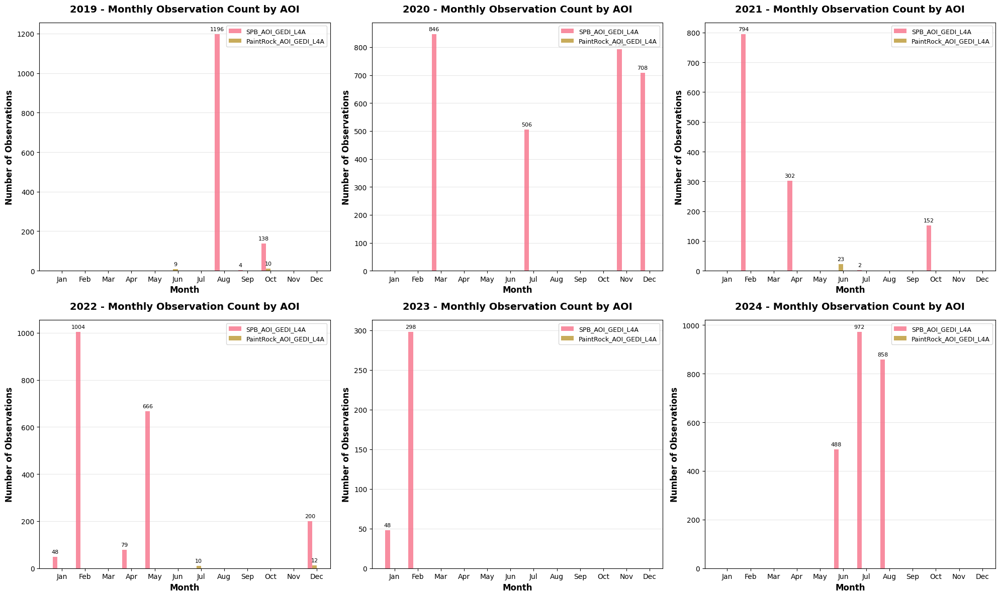

Yearly monthly breakdown

2019:
AOI    PaintRock_AOI_GEDI_L4A  SPB_AOI_GEDI_L4A
Jan                         0                 0
Feb                         0                 0
Mar                         0                 0
Apr                         0                 0
May                         0                 0
Jun                         9                 0
Jul                         0                 0
Aug                         0              1196
Sep                         0                 4
Oct                        10               138
Nov                         0                 0
Dec                         0                 0
Total                      19              1338

2020:
AOI    SPB_AOI_GEDI_L4A
Jan                   0
Feb                   0
Mar                 846
Apr                   0
May                   0
Jun                   0
Jul                 506
Aug                   0
Sep                   0
Oct                   0
Nov                 792
D

In [ ]:
# Create the yearly charts
yearly_charts = create_yearly_monthly_charts(geo_dfs)

In [ ]:
plt.close()

### Barplot per AOI of monthly observations across years
Similarly plot a figure representing observation counts per month and year, but with one figure for each AOI. Multiple bars demonstrate the availability of each year for the AOI. Gather statistics for peak months and total observations which can be particularly useful if using GEDI as training or validation data.

In [ ]:
# Set up plotting
plt.style.use('default')
sns.set_palette("husl")
import ipywidgets as widgets
from IPython.display import display

def create_aoi_yearly_comparison_chart(geo_dfs, aoi_name):
    """Create a bar chart of monthly observations by year for a single AOI"""

    # -------------------------
    # Select AOI
    # -------------------------
    if aoi_name not in geo_dfs:
        raise ValueError(f"{aoi_name} not found in geo_dfs")

    gdf = geo_dfs[aoi_name]

    # Process AOI
    aoi_result = process_aoi_counts_by_year(gdf, aoi_name)
    if aoi_result.empty:
        print(f"No data for {aoi_name}")
        return pd.DataFrame()

    # -------------------------
    # Prepare data
    # -------------------------
    all_years = sorted(aoi_result['Year'].unique())
    month_names = ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun',
                   'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec']
    months = np.arange(1, 13)

    # Year colors
    year_colors = {}
    color_palette = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd',
                     '#8c564b', '#e377c2', '#7f7f7f', '#bcbd22', '#17becf']
    for i, year in enumerate(all_years):
        year_colors[year] = color_palette[i % len(color_palette)]

    # -------------------------
    # Create figure
    # -------------------------
    fig, ax = plt.subplots(figsize=(14, 8))

    n_years = len(all_years)
    bar_width = 0.8 / n_years

    for i, year in enumerate(all_years):
        year_data = aoi_result[aoi_result['Year'] == year].sort_values('Month')

        # Get counts for all 12 months
        month_counts = {row['Month']: row['Count'] for _, row in year_data.iterrows()}
        counts = [month_counts.get(month, 0) for month in range(1, 13)]

        positions = months + (i - (n_years-1)/2) * bar_width
        color = year_colors[year]

        bars = ax.bar(positions, counts, bar_width,
                      label=str(year), color=color, alpha=0.8)

        # Labels on top
        for bar, count in zip(bars, counts):
            if count > 0:
                ax.text(bar.get_x() + bar.get_width()/2.,
                        bar.get_height() + ax.get_ylim()[1]*0.01,
                        f'{int(count)}', ha='center', va='bottom', fontsize=8)

    ax.set_xlabel('Month', fontsize=14, fontweight='bold')
    ax.set_ylabel('Number of Observations', fontsize=14, fontweight='bold')
    ax.set_title(f'{aoi_name} - Monthly Observations by Year',
                 fontsize=16, fontweight='bold', pad=20)

    ax.set_xticks(months)
    ax.set_xticklabels(month_names)
    ax.grid(True, alpha=0.3, axis='y')
    ax.set_axisbelow(True)
    ax.legend(title='Year', loc='upper right', fontsize=11)
    ax.set_ylim(bottom=0)

    plt.tight_layout()
    plt.show()

    # Print breakdown
    print(f"\n{aoi_name} - Monthly breakdown:")
    pivot_table = aoi_result.pivot(index='Month', columns='Year', values='Count').fillna(0)
    pivot_table.index = [month_names[i-1] for i in pivot_table.index]
    pivot_table.loc["Total"] = pivot_table.sum()
    print(pivot_table.astype(int))

    return aoi_result


# -------------------------
# Interactive widget
# -------------------------
def pick_and_plot_aoi(geo_dfs):
    aoi_dropdown = widgets.Dropdown(
        options=list(geo_dfs.keys()),
        description="Select AOI:",
        style={'description_width': 'initial'},
        layout=widgets.Layout(width='50%')
    )

    out = widgets.Output()

    def on_change(change):
        if change['type'] == 'change' and change['name'] == 'value':
            out.clear_output(wait=True)
            with out:
                create_aoi_yearly_comparison_chart(geo_dfs, change['new'])

    aoi_dropdown.observe(on_change, names='value')

    display(aoi_dropdown, out)

# Usage:
pick_and_plot_aoi(geo_dfs)

Dropdown(description='Select AOI:', layout=Layout(width='50%'), options=('SPB_AOI_GEDI_L4A', 'PaintRock_AOI_GE…

Output()

In [ ]:
plt.close()

### Barplot per AOI of monthly observations across years by beam type
Building off the AOI figures plotting observation counts by month and year, create stacked bars for each bar representing how many of those observations belonged to each beam type. Multiple bars demonstrate the availability of each year for the AOI, with each bar summarizing power and coverage beam counts.

Should you later decide to remove particular beams, you can revisit these charts to understand the changes to sample distribution.

In [ ]:
def process_aoi_counts_by_beam(df, aoi_name):
    """Count observations per AOI by Year, Month, Beam_Type"""
    if df.empty:
        return pd.DataFrame()

    work_df = df.drop(columns=['geometry'], errors='ignore').copy()

    # Extract year & month
    date_info = work_df['date'].apply(safe_extract_date_info)
    work_df['Year'] = [info[0] for info in date_info]
    work_df['Month'] = [info[1] for info in date_info]

    # Count
    counts = (
        work_df.groupby(['AOI','Year','Month','Beam_Type'])
        .size()
        .reset_index(name='Count')
    )
    counts['AOI'] = aoi_name
    return counts

def adjust_color(color, factor=0.5):
    """Lighten color by mixing with white"""
    r, g, b, a = colors.to_rgba(color)
    return (r + (1-r)*factor, g + (1-g)*factor, b + (1-b)*factor, a)

def create_single_aoi_beam_chart(site, gdf):
    """Create stacked bar chart for a single AOI, broken down by Power vs Coverage"""

    gdf['AOI'] = site
    aoi_result = process_aoi_counts_by_beam(gdf, site)

    if aoi_result.empty:
        print(f"No data to process for {site}!")
        return pd.DataFrame()

    # Month names
    month_names = ['Jan','Feb','Mar','Apr','May','Jun',
                   'Jul','Aug','Sep','Oct','Nov','Dec']
    months = np.arange(1, 13) * 2.0  # spacing between months

    # Base palette (cycled for years)
    base_palette = plt.cm.tab10.colors

    aoi_data = aoi_result
    years = sorted(aoi_data['Year'].unique())
    n_years = len(years)
    bar_width = 1.0 / n_years

    fig, ax = plt.subplots(figsize=(14,8))

    for i, year in enumerate(years):
        year_data = aoi_data[aoi_data['Year']==year]

        # Pivot to get Power & Coverage per month
        pivot = (
            year_data.pivot(index='Month', columns='Beam_Type', values='Count')
            .fillna(0)
        )
        power = [pivot.loc[m,'Power'] if 'Power' in pivot.columns and m in pivot.index else 0 for m in range(1,13)]
        coverage = [pivot.loc[m,'Coverage'] if 'Coverage' in pivot.columns and m in pivot.index else 0 for m in range(1,13)]

        positions = months + (i - (n_years-1)/2) * bar_width

        # Colors: dark for Power, light for Coverage
        base_color = base_palette[i % len(base_palette)]
        power_color = base_color
        coverage_color = adjust_color(base_color, factor=0.6)

        bars_power = ax.bar(positions, power, bar_width,
                            label=f'{year} Power', color=power_color)
        bars_cov = ax.bar(positions, coverage, bar_width, bottom=power,
                          label=f'{year} Coverage', color=coverage_color)

        # Add labels for each stacked part
        for bar, count in zip(bars_power, power):
            if count > 0:
                ax.text(bar.get_x() + bar.get_width()/2,
                        count/2,  # middle of the power bar
                        str(int(count)),
                        ha='center', va='center', fontsize=10,
                        color='black', fontweight='bold', rotation=45)

        for bar, p_count, c_count in zip(bars_cov, power, coverage):
            if c_count > 0:
                ax.text(bar.get_x() + bar.get_width()/2,
                        p_count + c_count/2,  # middle of coverage bar
                        str(int(c_count)),
                        ha='center', va='center', fontsize=10,
                        color='black', fontweight='bold', rotation=45)

    # Month separators
    for m in months:
        ax.axvline(x=m+0.5, color='gray', linestyle='--', alpha=0.3, linewidth=0.8)

    ax.set_xlabel("Month", fontsize=14, fontweight='bold')
    ax.set_ylabel("Observations", fontsize=14, fontweight='bold')
    ax.set_title(f"{site} - Monthly Observations by Year (Power vs Coverage)",
                 fontsize=16, fontweight='bold', pad=20)

    ax.set_xticks(months)
    ax.set_xticklabels(month_names)

    ax.legend(title="Year / Beam Type", bbox_to_anchor=(1.05,1), loc="upper left")
    ax.grid(True, alpha=0.3, axis='y')
    ax.set_axisbelow(True)

    plt.tight_layout()
    plt.show()

    # --- SUMMARY TABLE ---
    summary = (
        aoi_data.groupby(['Year','Month','Beam_Type'], dropna=False)['Count']
        .sum()
        .unstack(fill_value=0)
    )
    summary['Total'] = summary.sum(axis=1)

    # Make month names readable
    summary.index = summary.index.set_levels(
        [summary.index.levels[0],
          [month_names[m-1] for m in summary.index.levels[1]]],
        level=[0,1]
    )

    print(f"\nSummary for {site}:")
    print(summary)

    return aoi_data

def create_aoi_beam_charts(geo_dfs):
    """Create stacked bar charts for each AOI, broken down by Power vs Coverage"""

    all_results = []
    for site, gdf in geo_dfs.items():
        gdf['AOI'] = site
        aoi_result = process_aoi_counts_by_beam(gdf, site)
        if not aoi_result.empty:
            all_results.append(aoi_result)

    if not all_results:
        print("No data to process!")
        return pd.DataFrame()

    combined_data = pd.concat(all_results, ignore_index=True)

    # Month names
    month_names = ['Jan','Feb','Mar','Apr','May','Jun',
                   'Jul','Aug','Sep','Oct','Nov','Dec']
    months = np.arange(1, 13) * 2.0  # spacing between months

    # Base palette (cycled for years)
    base_palette = plt.cm.tab10.colors

    # Iterate AOIs
    for site in geo_dfs.keys():
        aoi_data = combined_data[combined_data['AOI']==site]
        if aoi_data.empty:
            continue

        years = sorted(aoi_data['Year'].unique())
        n_years = len(years)
        bar_width = 1.0 / n_years

        fig, ax = plt.subplots(figsize=(14,8))

        for i, year in enumerate(years):
            year_data = aoi_data[aoi_data['Year']==year]

            # Pivot to get Power & Coverage per month
            pivot = (
                year_data.pivot(index='Month', columns='Beam_Type', values='Count')
                .fillna(0)
            )
            power = [pivot.loc[m,'Power'] if 'Power' in pivot.columns and m in pivot.index else 0 for m in range(1,13)]
            coverage = [pivot.loc[m,'Coverage'] if 'Coverage' in pivot.columns and m in pivot.index else 0 for m in range(1,13)]

            positions = months + (i - (n_years-1)/2) * bar_width

            # Colors: dark for Power, light for Coverage
            base_color = base_palette[i % len(base_palette)]
            power_color = base_color
            coverage_color = adjust_color(base_color, factor=0.6)

            bars_power = ax.bar(positions, power, bar_width,
                                label=f'{year} Power', color=power_color)
            bars_cov = ax.bar(positions, coverage, bar_width, bottom=power,
                              label=f'{year} Coverage', color=coverage_color)

            # Add labels for each stacked part
            for bar, count in zip(bars_power, power):
                if count > 0:
                    ax.text(bar.get_x() + bar.get_width()/2,
                            count/2,  # middle of the power bar
                            str(int(count)),
                            ha='center', va='center', fontsize=10,
                            color='black', fontweight='bold', rotation=45)

            for bar, p_count, c_count in zip(bars_cov, power, coverage):
                if c_count > 0:
                    ax.text(bar.get_x() + bar.get_width()/2,
                            p_count + c_count/2,  # middle of coverage bar
                            str(int(c_count)),
                            ha='center', va='center', fontsize=10,
                            color='black', fontweight='bold', rotation=45)

        # Month separators
        for m in months:
            ax.axvline(x=m+0.5, color='gray', linestyle='--', alpha=0.3, linewidth=0.8)

        ax.set_xlabel("Month", fontsize=14, fontweight='bold')
        ax.set_ylabel("Observations", fontsize=14, fontweight='bold')
        ax.set_title(f"{site} - Monthly Observations by Year (Power vs Coverage)",
                     fontsize=16, fontweight='bold', pad=20)

        ax.set_xticks(months)
        ax.set_xticklabels(month_names)

        ax.legend(title="Year / Beam Type", bbox_to_anchor=(1.05,1), loc="upper left")
        ax.grid(True, alpha=0.3, axis='y')
        ax.set_axisbelow(True)

        plt.tight_layout()
        plt.show()

        # --- SUMMARY TABLE ---
        summary = (
            aoi_data.groupby(['Year','Month','Beam_Type'], dropna=False)['Count']
            .sum()
            .unstack(fill_value=0)
        )
        summary['Total'] = summary.sum(axis=1)

        # Make month names readable
        summary.index = summary.index.set_levels(
            [summary.index.levels[0],
              [month_names[m-1] for m in summary.index.levels[1]]],
            level=[0,1]
        )

        print(f"\nSummary for {site}:")
        print(summary)

    return combined_data

# -------------------------
# Interactive widget
# -------------------------
def pick_and_plot_aoi(geo_dfs):
    aoi_dropdown = widgets.Dropdown(
        options=list(geo_dfs.keys()),
        description="Select AOI:",
        style={'description_width': 'initial'},
        layout=widgets.Layout(width='50%')
    )

    out = widgets.Output()

    def on_change(change):
        if change['type'] == 'change' and change['name'] == 'value':
            out.clear_output(wait=True)
            with out:
                site = change['new']
                gdf = geo_dfs[site]
                create_single_aoi_beam_chart(site, gdf)

    aoi_dropdown.observe(on_change, names='value')

    display(aoi_dropdown, out)

# Usage examples:
# For interactive widget:
pick_and_plot_aoi(geo_dfs)

# For plotting all AOIs at once:
# create_aoi_beam_charts(geo_dfs)

Dropdown(description='Select AOI:', layout=Layout(width='50%'), options=('SPB_AOI_GEDI_L4A', 'PaintRock_AOI_GE…

Output()

In [ ]:
plt.close()

Check which beams were retained in the original data across each AOI. Some beams may have been left out due to spatial subsetting, or did not originally exist for that file.

In [ ]:
print("\nBeam values found:")
for site, gdf in geo_dfs.items():
    if not gdf.empty and 'Beam' in gdf.columns:
        unique_beams = gdf['Beam'].unique()
        print(f"{site}: {sorted(unique_beams)}")
    else:
        print(f"{site}: No beam data available")


Beam values found:
SPB_AOI_GEDI_L4A: ['BEAM0000', 'BEAM0001', 'BEAM0010', 'BEAM0011', 'BEAM0101', 'BEAM0110', 'BEAM1000', 'BEAM1011']
PaintRock_AOI_GEDI_L4A: ['BEAM0010', 'BEAM0011', 'BEAM0101', 'BEAM0110', 'BEAM1011']


### Barplot per AOI of monthly observations across years by beam type and quality flag

The quality flag is a convenient filter set by the GEDI missions team to help retain shots of baseline quality from the overall original dataset downloaded. A `quality_flag=1` indicates the laser shot meets criteria
based on energy, sensitivity, amplitude, and real-time surface tracking quality. It is general guidance only, and may not be necessary, or may need to be paired with additional quality processing techniques.

In [ ]:
def process_aoi_counts_by_var(df, aoi_name, var):
    """Count observations per AOI by Year, Month, Beam_Type, Quality"""
    if df.empty: return pd.DataFrame()

    work_df = df.drop(columns=['geometry'], errors='ignore').copy()
    dt = pd.to_datetime(work_df['date'], errors='coerce')
    work_df['Year'] = dt.dt.year
    work_df['Month'] = dt.dt.month

    return (work_df.groupby(['AOI','Year','Month','Beam_Type',var])
            .size().reset_index(name='Count'))

In [ ]:
def create_aoi_beam_charts_quality(site, gdf):
    """Two subplots for a single AOI: Power vs Coverage, stacked by quality, with month grids"""

    gdf['AOI'] = site
    var = gdf['l4_quality_flag']  # GEDI L4A quality flag
    res = process_aoi_counts_by_var(gdf, site, var)
    if res.empty:
        print(f"No data for {site}")
        return pd.DataFrame()

    data = res.copy()
    month_names = ['Jan','Feb','Mar','Apr','May','Jun',
                   'Jul','Aug','Sep','Oct','Nov','Dec']
    base_palette = plt.cm.tab10.colors

    years = sorted(data['Year'].dropna().unique())
    n_years = len(years)
    bar_width = 0.8 / n_years
    months = np.arange(1,13)

    fig, axes = plt.subplots(1,2,figsize=(16,6),sharey=True)
    for bi, beam_type in enumerate(['Power','Coverage']):
        ax = axes[bi]
        for i, year in enumerate(years):
            subset = data[(data['Year']==year)&(data['Beam_Type']==beam_type)]
            q0 = [subset[(subset['Month']==m)&(subset['l4_quality_flag']==0)]['Count'].sum() for m in months]
            q1 = [subset[(subset['Month']==m)&(subset['l4_quality_flag']==1)]['Count'].sum() for m in months]

            pos = months + (i-(n_years-1)/2)*bar_width
            ax.bar(pos, q0, bar_width, label=f'{year} Low Quality', color=base_palette[i%10], alpha=0.5)
            ax.bar(pos, q1, bar_width, bottom=q0, label=f'{year} High Quality', color=base_palette[i%10])

        # Month separators
        for m in months:
            ax.axvline(x=m+0.5, color='gray', linestyle='--', alpha=0.4, linewidth=0.8)

        ax.set_xticks(months)
        ax.set_xticklabels(month_names, rotation=45)
        ax.set_title(f"{beam_type} Beams")
        ax.set_xlabel("Month")
        ax.grid(True, axis='y', alpha=0.3)
        if bi==0: ax.set_ylabel("Observations")

    handles, labels = axes[0].get_legend_handles_labels()
    fig.legend(handles, labels, title="Year / Quality", bbox_to_anchor=(1.05,1), loc="upper left")
    fig.suptitle(f"{site} - Monthly Observations by Year & Quality", fontsize=14, fontweight='bold')
    plt.tight_layout()
    plt.show()

    yearly_summary = (
        data.groupby(['Year','l4_quality_flag'])['Count']
        .sum().unstack(fill_value=0)
    )
    yearly_summary.columns = ['Quality=0','Quality=1']
    yearly_summary['Total'] = yearly_summary.sum(axis=1)

    print(f"\nSummary for {site}:")
    print(yearly_summary)

    return data


# -------------------------
# Interactive widget
# -------------------------
def pick_and_plot_aoi(geo_dfs):
    aoi_dropdown = widgets.Dropdown(
        options=list(geo_dfs.keys()),
        description="Select AOI:",
        style={'description_width': 'initial'},
        layout=widgets.Layout(width='50%')
    )

    out = widgets.Output()

    def on_change(change):
        if change['type'] == 'change' and change['name'] == 'value':
            out.clear_output(wait=True)
            with out:
                site = change['new']
                gdf = geo_dfs[site]
                create_aoi_beam_charts_quality(site, gdf)

    aoi_dropdown.observe(on_change, names='value')

    display(aoi_dropdown, out)

# Usage:
pick_and_plot_aoi(geo_dfs)


Dropdown(description='Select AOI:', layout=Layout(width='50%'), options=('SPB_AOI_GEDI_L4A', 'PaintRock_AOI_GE…

Output()

In [ ]:
plt.close()

### Barplot per AOI of monthly observations across years by degrade flag

The degrade flag is another convenient filter set by the GEDI missions team to help retain non-degraded shots from the overall original dataset downloaded. A `degrade_flag` of non-zero values indicates the laser shot occurred during a degraded period.

Plot the observations retained after the `degrade_flag` filter is applied to quantify the systematic and acquisition issues. This helps quantify the degrade conditions across time.

In [ ]:
def create_aoi_beam_charts_degrade(site, geo_dfs):
    """Two subplots for the selected AOI: Power vs Coverage, stacked by degrade, with month grids"""
    gdf = geo_dfs[site].copy()
    gdf['AOI'] = site

    # process counts
    res = process_aoi_counts_by_var(gdf, site, gdf['degrade_flag'])
    if res.empty:
        print(f"No data for {site}")
        return pd.DataFrame()

    combined = res
    month_names = ['Jan','Feb','Mar','Apr','May','Jun',
                   'Jul','Aug','Sep','Oct','Nov','Dec']
    base_palette = plt.cm.tab10.colors

    # only plot this AOI
    data = combined[combined['AOI']==site]
    if data.empty:
        return pd.DataFrame()

    years = sorted(data['Year'].dropna().unique())
    n_years = len(years)
    bar_width = 0.8 / n_years
    months = np.arange(1,13)

    fig, axes = plt.subplots(1,2,figsize=(16,6),sharey=True)
    for bi, beam_type in enumerate(['Power','Coverage']):
        ax = axes[bi]
        for i, year in enumerate(years):
            subset = data[(data['Year']==year)&(data['Beam_Type']==beam_type)]
            q0 = [subset[(subset['Month']==m)&(subset['degrade_flag']==0)]['Count'].sum() for m in months]
            q1 = [subset[(subset['Month']==m)&(subset['degrade_flag']!=0)]['Count'].sum() for m in months]

            pos = months + (i-(n_years-1)/2)*bar_width
            ax.bar(pos, q1, bar_width, label=f'{year} Degraded', color=base_palette[i%10], alpha=0.5)
            ax.bar(pos, q0, bar_width, bottom=q1, label=f'{year} Not degraded', color=base_palette[i%10])

        # Month separators
        for m in months:
            ax.axvline(x=m+0.5, color='gray', linestyle='--', alpha=0.4, linewidth=0.8)

        ax.set_xticks(months)
        ax.set_xticklabels(month_names, rotation=45)
        ax.set_title(f"{beam_type} Beams")
        ax.set_xlabel("Month")
        ax.grid(True, axis='y', alpha=0.3)
        if bi==0: ax.set_ylabel("Observations")

    handles, labels = axes[0].get_legend_handles_labels()
    fig.legend(handles, labels, title="Year / Degrade Flag", bbox_to_anchor=(1.05,1), loc="upper left")
    fig.suptitle(f"{site} - Monthly Observations by Year & Degrade Flag", fontsize=14, fontweight='bold')
    plt.tight_layout()
    plt.show()

    return combined


# -------------------------
# Interactive widget
# -------------------------
def pick_and_plot_aoi(geo_dfs):
    aoi_dropdown = widgets.Dropdown(
        options=list(geo_dfs.keys()),
        description="Select AOI:",
        style={'description_width': 'initial'},
        layout=widgets.Layout(width='50%')
    )

    out = widgets.Output()

    def on_change(change):
        if change['type'] == 'change' and change['name'] == 'value':
            out.clear_output(wait=True)
            with out:
                create_aoi_beam_charts_degrade(change['new'], geo_dfs)

    aoi_dropdown.observe(on_change, names='value')

    display(aoi_dropdown, out)

# Usage
pick_and_plot_aoi(geo_dfs)


Dropdown(description='Select AOI:', layout=Layout(width='50%'), options=('SPB_AOI_GEDI_L4A', 'PaintRock_AOI_GE…

Output()

In [ ]:
plt.close()

## Pairplot of the original subset data
This is a scatterplot matrix for numerical variables. Diagonal plots display distributions, spread, and potential skew of each independent variable.
The scatter plots help visualize correlations, any clustering, or outliers and trends between two variables.
Generating a detailed view of variable relationships can help with variable selection or understanding the quality and behavior of the original GEDI data prior to application-based pre-processing.
> Note: This plot may take a few minutes to generate.

Dropdown(description='Select AOI:', layout=Layout(width='50%'), options=('SPB_AOI_GEDI_L4A', 'PaintRock_AOI_GE…

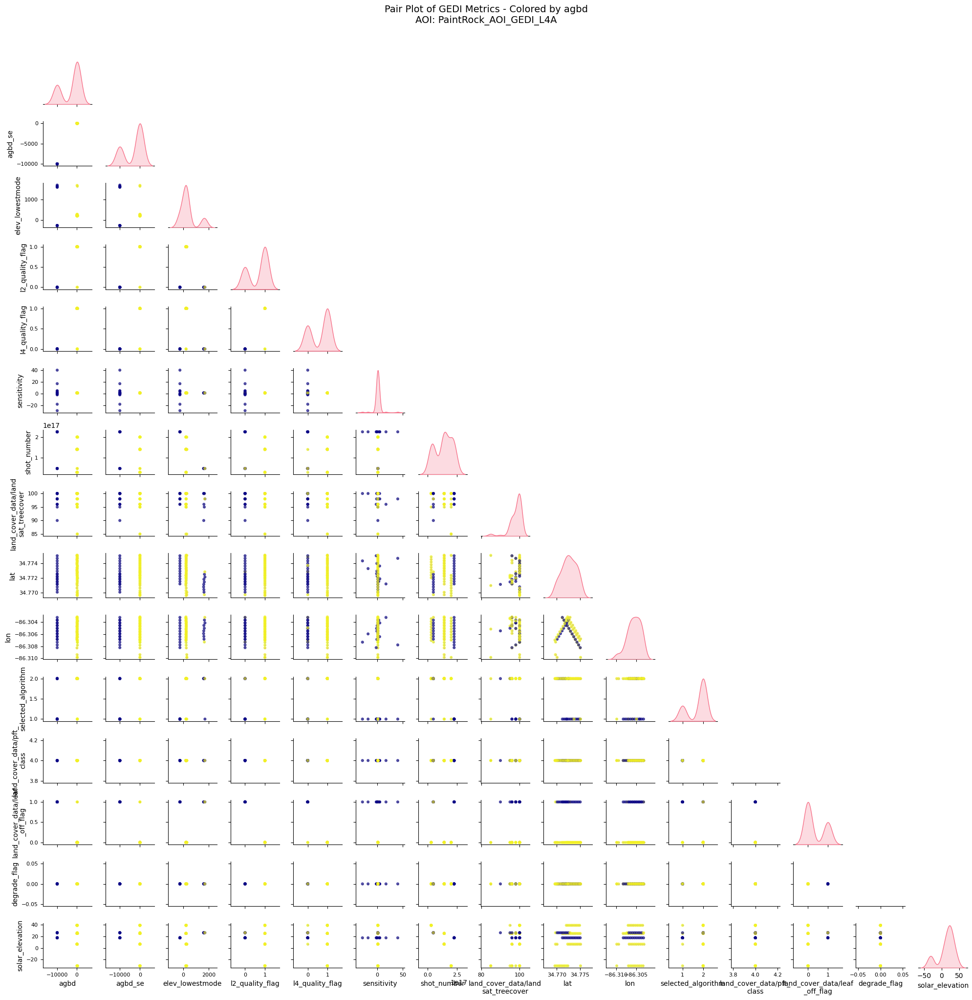

In [ ]:
# -------------------------
# Define the plotting function
# -------------------------

def plot_pairplot_for_aoi(aoi_name, geo_dfs):
    gdf = geo_dfs[aoi_name]

    # Check numeric columns
    numeric_cols = gdf.select_dtypes(include=[np.number]).columns.tolist()
    if 'agbd' not in numeric_cols or gdf.empty:
        print(f"{aoi_name} has no numeric data or is empty")
        return

    # Drop rows with missing values
    plot_df = gdf[numeric_cols].dropna()

    # Normalize for coloring
    cmap = plt.cm.plasma
    norm = Normalize(vmin=plot_df['agbd'].min(), vmax=plot_df['agbd'].max())
    colors = cmap(norm(plot_df['agbd'].values))

    # Create base pairplot
    pair_grid = sns.pairplot(
        plot_df,
        corner=True,
        diag_kind='kde',
        plot_kws={'s': 10, 'alpha': 0.5, 'color': 'gray'},
        diag_kws={'fill': True}
    )

    # Resize figure
    pair_grid.fig.set_size_inches(20, 20)

    # Overlay color-coded scatter
    for i, j in zip(*np.tril_indices_from(pair_grid.axes, -1)):
        ax = pair_grid.axes[i, j]
        if ax:
            x = plot_df.iloc[:, j]
            y = plot_df.iloc[:, i]
            ax.scatter(x, y, c=colors, s=12, alpha=0.6)

            ax.set_xlabel(textwrap.fill(plot_df.columns[j], 20), fontsize=10)
            ax.set_ylabel(textwrap.fill(plot_df.columns[i], 20), fontsize=10)
            ax.tick_params(labelsize=8)

    # Colorbar
    sm = ScalarMappable(norm=norm, cmap=cmap)
    sm.set_array([])
    # You can add the colorbar if needed:
    # pair_grid.fig.colorbar(sm, ax=pair_grid.fig.axes, label='agbd', shrink=0.7, pad=0.02)

    # Title
    pair_grid.fig.suptitle(
        f"Pair Plot of GEDI Metrics - Colored by agbd\nAOI: {aoi_name}",
        fontsize=14, y=1.02
    )
    pair_grid.fig.subplots_adjust(top=0.95, wspace=0.3, hspace=0.3)
    plt.tight_layout()
    plt.show()


# -------------------------
# The widget selector
# -------------------------
def make_aoi_selector(geo_dfs, plot_func, description="Select AOI:"):
    dropdown = widgets.Dropdown(
        options=list(geo_dfs.keys()),
        description=description,
        layout=widgets.Layout(width="50%")
    )

    def on_change(change):
        if change['type'] == 'change' and change['name'] == 'value':
            plot_func(change['new'], geo_dfs)

    dropdown.observe(on_change)

    # Display dropdown
    display(dropdown)


# -------------------------
# Run it for pairplots
# -------------------------
make_aoi_selector(geo_dfs, plot_pairplot_for_aoi)


In [ ]:
plt.close()

## Histogram of specific degrade flag occurances

The `degrade flag = 0` means the shot is not degraded. Non-zero
tens digits indicate degraded attitude, while non-zero units digit = degraded trajectory. The histogram will help reveal which degradation statuses are largely influencing the data.


Total degraded count:  436
Total non-degraded count:  9665
degrade_flag
0     9665
70     200
5      154
30      82
Name: count, dtype: int64


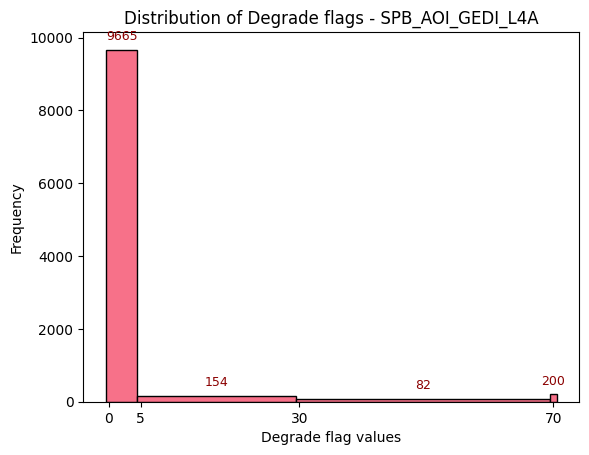

Total degraded count:  0
Total non-degraded count:  64
degrade_flag
0    64
Name: count, dtype: int64


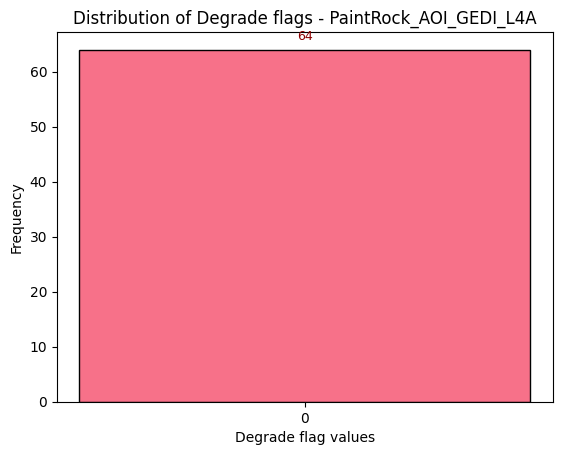

In [ ]:
for site, gdf in geo_dfs.items():
  #Summarize values found in the degrade flag
  deg = (gdf['degrade_flag'] != 0).sum()
  nodeg = (gdf['degrade_flag'] == 0).sum()
  print('Total degraded count: ', deg)
  print('Total non-degraded count: ', nodeg)
  print(gdf['degrade_flag'].value_counts())

  unique_vals = sorted(gdf['degrade_flag'].unique())

  # Plot the histogram
  values, bins, bars = plt.hist(gdf['degrade_flag'], bins=[x - 0.5 for x in unique_vals] + [unique_vals[-1] + 0.5],
        edgecolor="black")
  plt.bar_label(bars, fmt='%d', fontsize=9, color='darkred', padding=5)

  plt.title(f'Distribution of Degrade flags - {site}')
  plt.xlabel('Degrade flag values')
  plt.ylabel('Frequency')
  plt.xticks(unique_vals)

  plt.show()


## Histogram of beam sensitivity
> Sensitivity is "*the percentage of canopy cover through which we expect to be able to detect the ground 90% of the time.*" (Duncanson et al., 2020).

Beam sensitivity is a fundamental indicator of GEDI data quality, particularly in dense canopies and during the daytime, with denser canopies likely requiring higher sensitivity thresholds. Sensitivity thresholds may differ across locations, and power beams tend to have higher sensitivity than coverage beams.
> Note: Applying the quality_flag filter automatically threshold sensitivities greater than 0.9.

Variations in sensitivity could provide insights on how GEDI performs for that particular vegetation type or AOI.

SPB_AOI_GEDI_L4A
Sensitivity value counts:
[357.79020786 243.97702217  90.78627229 ...  95.86499929  95.58308721
  98.85372519]


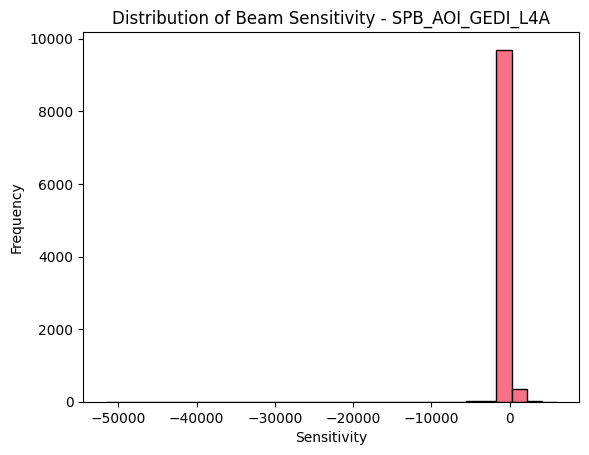

PaintRock_AOI_GEDI_L4A
Sensitivity value counts:
[   98.99786115    98.82145524    97.9336679     96.21393681
    97.62321711    96.03967667    97.84703255    98.99132848
    98.45514894    98.66141081    98.45648408    98.51340055
    92.10765362    96.96235657    95.82062364    97.56749272
    97.70615101    96.92970514    96.94257379    96.99847698
    95.02283335    98.86028171    97.15927839    96.42502069
    96.52146697    96.13660574    95.55109143    95.57173252
    88.10883164    97.49996662    96.13514543  -231.83045387
  3993.4803009  -2928.58505249   -97.46784568   438.07196617
 -1828.29246521   -98.43174815  -153.74393463   -42.57240593
   475.06914139   282.05668926  1682.98091888    96.88258171
    99.05062318    98.62200022    98.88766408    98.89853001
    98.82111549    98.95012975    99.07556772    98.87427092
    98.98673296    96.77107334    97.52786756    98.09478521
    97.93773293    94.14180517    96.83308005    97.98800945
    98.20352197    97.49049544    98

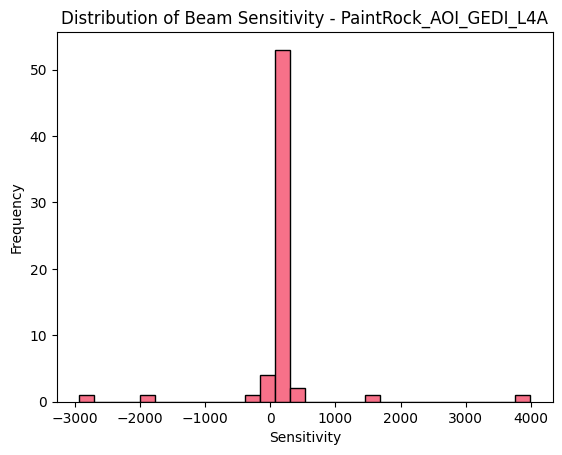

In [ ]:
for site, gdf in geo_dfs.items():
  print(site)

  #Summarize values found in the degrade flag
  if 'sensitivity' in gdf.columns:
      print("Sensitivity value counts:")

      sensitivity = gdf['sensitivity'].dropna() * 100
      print(sensitivity.unique())

      # Plot the histogram
      plt.figure() # Create a new figure for each AOI
      plt.hist(sensitivity, bins=30, edgecolor="black") # Use a reasonable number of bins for continuous data and drop NaN


      plt.title(f'Distribution of Beam Sensitivity - {site}')
      plt.xlabel('Sensitivity')
      plt.ylabel('Frequency')

      plt.show()
  else:
      print(f"'{site}': 'sensitivity' column not found")


## Histogram of selected L4A algorithm setting group
Algorithm setting groups are different configurations for how the lidar waveform was interpreted to derive metrics. Each shot has an associated algorithm setting group whose performance was evaluated. Some of the setting groups are optimized for particular vegetation covers, others for noisy data and outliers, etc. Investigate the selected group(s) for the given AOIs.

SPB_AOI_GEDI_L4A
selected_algorithm counts:
selected_algorithm
1    5088
2    5013
Name: count, dtype: int64
[1 2]


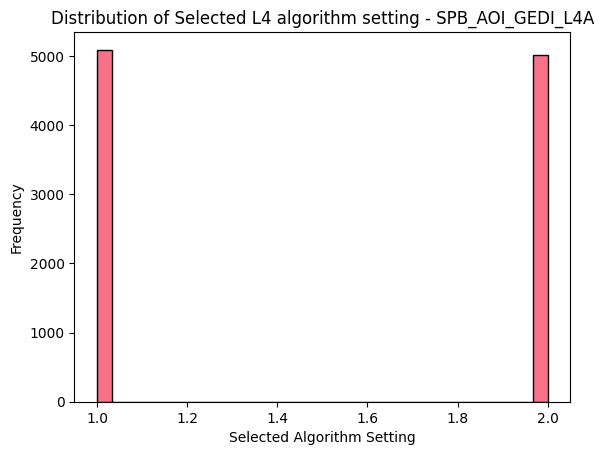

PaintRock_AOI_GEDI_L4A
selected_algorithm counts:
selected_algorithm
2    47
1    17
Name: count, dtype: int64
[2 1]


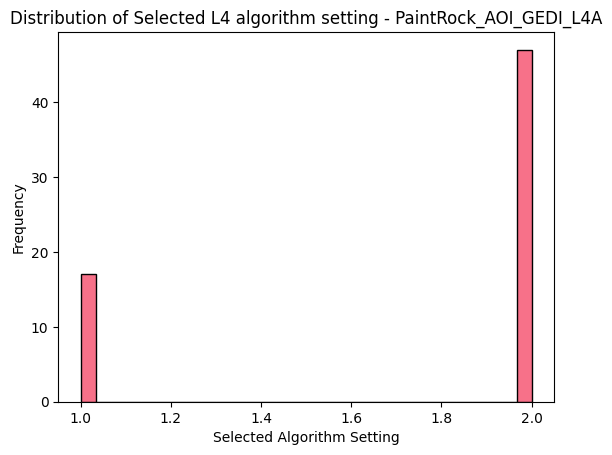

In [ ]:
for site, gdf in geo_dfs.items():
  print(site)

  #Summarize values found in the degrade flag
  if 'selected_algorithm' in gdf.columns:
      print("selected_algorithm counts:")
      print(gdf['selected_algorithm'].value_counts())
      print(gdf['selected_algorithm'].unique())

      # Plot the histogram
      plt.figure() # Create a new figure for each AOI
      plt.hist(gdf['selected_algorithm'], bins=30, edgecolor="black") # Use a reasonable number of bins for continuous data and drop NaN

      plt.title(f'Distribution of Selected L4 algorithm setting - {site}')
      plt.xlabel('Selected Algorithm Setting')
      plt.ylabel('Frequency')

      plt.show()
  else:
      print(f"'{site}': 'selected_algorithm' column not found")

## Heatmap of observations retained across GEDI data variables per quality filter applied

### **Define the possible filters**
These filters will be iteratively applied to the dataset to observe interdependencies and other patterns across each data variable once the filter is applied. Consider singular quality considerations against combined filters. The suggested iterations were found across what has been applied in research literature.

In [ ]:
# Define the filters as functions for flexibility
filters = {
    "Only High Quality=1": lambda gf: gf[gf['l4_quality_flag'] == 1],
    "Only Not Degraded": lambda gf: gf[gf['degrade_flag'] == 0],
    "Only Sensitivity ≥ 0.9": lambda gf: gf[gf['sensitivity'] >= 0.9],
    "Only Sensitivity ≥ 0.95": lambda gf: gf[gf['sensitivity'] >= 0.95],
    "Only Sensitivity ≥ 0.98": lambda gf: gf[gf['sensitivity'] >= 0.98],
    "Only Nighttime": lambda gf: gf[gf['solar_elevation'] < 0],
    "Only Leaf-on": lambda gf: gf[gf['land_cover_data/leaf_off_flag'] == 0],

    "Valid data & High Quality": lambda gf: gf[
        (gf['agbd'] != -9999) & (gf['agbd_se'] != -9999)
        & (gf['l4_quality_flag'] == 1)],

    "Valid data, High Quality, Not degraded": lambda gf: gf[
        (gf['agbd'] != -9999) & (gf['agbd_se'] != -9999)
        & (gf['l4_quality_flag'] == 1) & (gf['degrade_flag'] == 0)],

    "Valid data, High Quality, Not degraded, Nighttime": lambda gf: gf[
        (gf['agbd'] != -9999) & (gf['agbd_se'] != -9999)
        & (gf['l4_quality_flag'] == 1)  & (gf['degrade_flag'] == 0) & (gf['solar_elevation'] < 0)],

    "Valid data, High Quality, Not degraded, Sens >95%": lambda gf: gf[
        (gf['agbd'] != -9999) & (gf['agbd_se'] != -9999)
        & (gf['l4_quality_flag'] == 1) & (gf['degrade_flag'] == 0) & (gf['sensitivity'] >= 0.95)],

    "Valid data, High Quality, Not degraded, Sens >98%": lambda gf: gf[
        (gf['agbd'] != -9999) & (gf['agbd_se'] != -9999)
        & (gf['l4_quality_flag'] == 1)  & (gf['degrade_flag'] == 0) & (gf['sensitivity'] >= 0.98)],

    "Valid data, High Quality, Not degraded, Leaf-on": lambda gf: gf[
        (gf['agbd'] != -9999) & (gf['agbd_se'] != -9999)
        & (gf['l4_quality_flag'] == 1)  & (gf['degrade_flag'] == 0) & (gf['land_cover_data/leaf_off_flag'] == 0)],

    "Valid data, High Quality, Not degraded, Nighttime, Sens >95%": lambda gf: gf[
        (gf['agbd'] != -9999) & (gf['agbd_se'] != -9999)
        & (gf['l4_quality_flag'] == 1)  & (gf['degrade_flag'] == 0) & (gf['solar_elevation'] < 0) & (gf['sensitivity'] >= 0.95)],

    "Valid data, High Quality, Not degraded, Nighttime, Sens >98%": lambda gf: gf[
        (gf['agbd'] != -9999) & (gf['agbd_se'] != -9999)
        & (gf['l4_quality_flag'] == 1) & (gf['degrade_flag'] == 0) & (gf['solar_elevation'] < 0) & (gf['sensitivity'] >= 0.98)],

    "Valid data, High Quality, Not degraded, Nighttime, Leaf-on": lambda gf: gf[
        (gf['agbd'] != -9999) & (gf['agbd_se'] != -9999)
        & (gf['l4_quality_flag'] == 1) & (gf['degrade_flag'] == 0) & (gf['solar_elevation'] < 0) & (gf['land_cover_data/leaf_off_flag'] == 0)],

    "Valid data, High Quality, Not degraded, Nighttime, Sens >95%, Leaf-on": lambda gf: gf[
        (gf['agbd'] != -9999) & (gf['agbd_se'] != -9999)
        & (gf['l4_quality_flag'] == 1)  & (gf['degrade_flag'] == 0) & (gf['sensitivity'] >= 0.95) & (gf['solar_elevation'] < 0) & (gf['land_cover_data/leaf_off_flag'] == 0)],

    "Valid data, High Quality, Not degraded, Nighttime, Sens >98%, Leaf-on": lambda gf: gf[
        (gf['agbd'] != -9999) & (gf['agbd_se'] != -9999)
        & (gf['l4_quality_flag'] == 1) & (gf['degrade_flag'] == 0) & (gf['sensitivity'] >= 0.98) & (gf['solar_elevation'] < 0) & (gf['land_cover_data/leaf_off_flag'] == 0)]
}

In [ ]:
# Variable conditions for tracking the impact of filtering

def summarize_vars(gf):
    return {
        "Quality": {
            "High": (gf['l4_quality_flag'] == 1).sum(),
            "Low": (gf['l4_quality_flag'] == 0).sum()
        },
        "Degraded": {
            "Yes": (gf['degrade_flag'] != 0).sum(),
            "No": (gf['degrade_flag'] == 0).sum()
        },
        "Sensitivity": {
            "<0.9": (gf['sensitivity'] < 0.9).sum(),
            "≥0.9": (gf['sensitivity'] >= 0.9).sum(),
            "≥0.95": (gf['sensitivity'] >= 0.95).sum(),
            "≥0.98": (gf['sensitivity'] >= 0.98).sum()
        },
        "Time": {
            "Day": (gf['solar_elevation'] >= 0).sum(),
            "Night": (gf['solar_elevation'] < 0).sum()
        },
        "Leaf Status": {
            "On": (gf['land_cover_data/leaf_off_flag'] == 0).sum(),
            "Off": (gf['land_cover_data/leaf_off_flag'] == 1).sum()
        },
        "agbd": {
            "Valid": (gf['agbd'] != -9999).sum(),
            "No data": (gf['agbd'] == -9999).sum()
        },
        "agbd_se": {
            "Valid": (gf['agbd_se'] != -9999).sum(),
            "No data": (gf['agbd_se'] == -9999).sum()
        }
    }

In [ ]:
# -------------------------
# Helper to build heatmap data
# -------------------------
def build_heatmap_data(data, filters, summarize_vars):
    base_summary = summarize_vars(data)
    heatmap_data = {}

    for filt_name, filt_func in filters.items():
        filtered = filt_func(data)
        filt_summary = summarize_vars(filtered)

        row_vals = {}
        for var_name, categories in base_summary.items():
            for cat_name in categories:
                base_count = base_summary[var_name][cat_name]
                filt_count = filt_summary[var_name][cat_name]
                perc_retained = (filt_count / base_count * 100) if base_count > 0 else 0
                row_vals[f"{var_name}: {cat_name}"] = perc_retained

        heatmap_data[filt_name] = row_vals

    return pd.DataFrame(heatmap_data).transpose()

# -------------------------
# Plot heatmaps for a single AOI
# -------------------------
def plot_heatmaps_for_aoi(geo_dfs, aoi_name, filters, summarize_vars):
    gdf = geo_dfs[aoi_name]

    # Data
    df_heatmap_all = build_heatmap_data(gdf, filters, summarize_vars)
    gf_power = gdf[gdf['Beam_Type'] == 'Power']
    df_heatmap_power = build_heatmap_data(gf_power, filters, summarize_vars)

    # Figure with subplots
    fig, axes = plt.subplots(
        1, 2, figsize=(27, max(6, len(df_heatmap_all) / 2)),
        sharey=True
    )

    # Left heatmap (All Beams)
    sns.heatmap(
        df_heatmap_all, annot=True, fmt=".1f", cmap="magma",
        cbar=False, ax=axes[0], xticklabels=df_heatmap_all.columns
    )
    axes[0].set_title(f"{aoi_name} - All Beams", fontsize=14)
    axes[0].set_ylabel("")
    axes[0].set_xlabel("Variable")
    axes[0].tick_params(axis='x', rotation=45)
    axes[0].set_xticks([x + 0.5 for x in range(len(df_heatmap_all.columns))])
    axes[0].set_xticklabels(df_heatmap_all.columns, rotation=45, ha="right")

    # Right heatmap (Power beams only)
    sns.heatmap(
        df_heatmap_power, annot=True, fmt=".1f", cmap="magma",
        cbar=True, ax=axes[1], xticklabels=df_heatmap_power.columns
    )
    axes[1].set_title(f"{aoi_name} - Power Beams Only", fontsize=14)
    axes[1].set_ylabel("")
    axes[1].set_xlabel("Variable")
    axes[1].tick_params(axis='x', rotation=45)
    axes[1].set_xticks([x + 0.5 for x in range(len(df_heatmap_power.columns))])
    axes[1].set_xticklabels(df_heatmap_power.columns, rotation=45, ha="right")

    # Layout
    fig.suptitle(f"{aoi_name} - % Observations Retained per Filter", fontsize=16)
    plt.tight_layout(rect=[0.05, 0, 1, 0.95])
    plt.show()

# -------------------------
# Interactive widget
# -------------------------
def pick_and_plot_heatmap(geo_dfs, filters, summarize_vars):
    aoi_dropdown = widgets.Dropdown(
        options=list(geo_dfs.keys()),
        description="Select AOI:",
        style={'description_width': 'initial'},
        layout=widgets.Layout(width='50%')
    )

    out = widgets.Output()

    def on_change(change):
        if change['type'] == 'change' and change['name'] == 'value':
            out.clear_output(wait=True)
            with out:
                plot_heatmaps_for_aoi(geo_dfs, change['new'], filters, summarize_vars)

    aoi_dropdown.observe(on_change, names='value')

    display(aoi_dropdown, out)



# -------------------------
# Usage
# -------------------------
pick_and_plot_heatmap(geo_dfs, filters, summarize_vars)

Dropdown(description='Select AOI:', layout=Layout(width='50%'), options=('SPB_AOI_GEDI_L4A', 'PaintRock_AOI_GE…

Output()

In [ ]:
plt.close()

## Heatmap of Pearson's Correlation by beam type across variables
Get correlations between variables by beam type configurations for the original dataset.

In [ ]:
# -------------------------
# Helper: Drop irrelevant columns
# -------------------------
def drop_columns(corr_mtx, cols):
    cols_exist = [c for c in cols if c in corr_mtx.columns]
    return corr_mtx.drop(columns=cols_exist, index=cols_exist)

# -------------------------
# Plot correlations for a single AOI
# -------------------------
def plot_correlation_heatmaps(geo_dfs, aoi_name):
    gdf = geo_dfs[aoi_name]

    if gdf.empty:
        print(f"⚠️ Could not generate plot for {aoi_name}: dataframe is empty")
        return

    # Split into Power and Coverage
    power = gdf[gdf['Beam_Type'] == 'Power']
    coverage = gdf[gdf['Beam_Type'] == 'Coverage']

    # Compute correlations
    drop_cols = ['l4_quality_flag', 'degrade_flag']
    co_mtx0 = drop_columns(gdf.corr(numeric_only=True), drop_cols)
    co_mtx  = drop_columns(power.corr(numeric_only=True), drop_cols)
    co_mtx2 = drop_columns(coverage.corr(numeric_only=True), drop_cols)

    # Plot side-by-side heatmaps
    fig, axes = plt.subplots(2, 2, figsize=(22, 13), sharey=True)

    sns.heatmap(co_mtx0, ax=axes[0, 0], cmap="magma", annot=True, cbar=False, xticklabels=False)
    axes[0, 0].set_title("All Beams")

    axes[0, 1].axis('off')

    sns.heatmap(co_mtx, ax=axes[1, 0], cmap="magma", annot=True, cbar=False)
    axes[1, 0].set_title("Power Beams")

    sns.heatmap(co_mtx2, ax=axes[1, 1], cmap="magma", annot=True)
    axes[1, 1].set_title("Coverage Beams")

    plt.suptitle(f"Pearson's Correlation Heatmap for {aoi_name}")
    plt.tight_layout()
    plt.show()

# -------------------------
# Interactive widget
# -------------------------
def pick_and_plot_correlation(geo_dfs):
    aoi_dropdown = widgets.Dropdown(
        options=list(geo_dfs.keys()),
        description="Select AOI:",
        style={'description_width': 'initial'},
        layout=widgets.Layout(width='50%')
    )

    out = widgets.Output()

    def on_change(change):
        if change['type'] == 'change' and change['name'] == 'value':
            out.clear_output(wait=True)
            with out:
                plot_correlation_heatmaps(geo_dfs, change['new'])

    aoi_dropdown.observe(on_change, names='value')

    display(aoi_dropdown, out)

# -------------------------
# Usage
# -------------------------
pick_and_plot_correlation(geo_dfs)


Dropdown(description='Select AOI:', layout=Layout(width='50%'), options=('SPB_AOI_GEDI_L4A', 'PaintRock_AOI_GE…

Output()

In [ ]:
plt.close()

## Scatterplot of the values with and without no-data values removed
What would AGBD look like by filtering -9999 values?

In [ ]:
# -------------------------
# Plot AGBD before vs. after filtering for one AOI
# -------------------------
def plot_agbd_filter_comparison(geo_dfs, aoi_name):
    gdf = geo_dfs[aoi_name]

    if gdf.empty or 'agbd' not in gdf.columns:
        print(f"⚠️ Could not generate plot for {aoi_name}: missing or empty 'agbd'")
        return

    # Filter out -9999 values
    gdf_agbd_filtered = gdf[gdf['agbd'] != -9999]

    # Create 1x2 subplot grid
    fig, axes = plt.subplots(1, 2, figsize=(16, 6))

    # Plot 1: AGBD Before Filtering
    axes[0].scatter(gdf.index, gdf['agbd'], c='darkorange', alpha=0.6)
    axes[0].set_title('AGBD Before Filtering (-9999 present)', fontsize=12)
    axes[0].set_ylabel('AGBD')
    axes[0].set_xlabel('Index')
    axes[0].grid(True)

    # Plot 2: AGBD After Filtering
    axes[1].scatter(gdf_agbd_filtered.index, gdf_agbd_filtered['agbd'], c='gold', alpha=0.6)
    axes[1].set_title('AGBD After Filtering (-9999 removed)', fontsize=12)
    axes[1].set_ylabel('AGBD')
    axes[1].set_xlabel('Index')
    axes[1].grid(True)

    # Main title and layout
    fig.suptitle(f'Comparison of AGBD {aoi_name} (Before vs. After Filtering -9999)', fontsize=16)
    plt.tight_layout(rect=[0, 0, 1, 0.96])
    plt.show()

# -------------------------
# Interactive widget
# -------------------------
def pick_and_plot_agbd(geo_dfs):
    aoi_dropdown = widgets.Dropdown(
        options=list(geo_dfs.keys()),
        description="Select AOI:",
        style={'description_width': 'initial'},
        layout=widgets.Layout(width='50%')
    )

    out = widgets.Output()

    def on_change(change):
        if change['type'] == 'change' and change['name'] == 'value':
            out.clear_output(wait=True)
            with out:
                plot_agbd_filter_comparison(geo_dfs, change['new'])

    aoi_dropdown.observe(on_change, names='value')

    display(aoi_dropdown, out)


# -------------------------
# Usage
# -------------------------
pick_and_plot_agbd(geo_dfs)


Dropdown(description='Select AOI:', layout=Layout(width='50%'), options=('SPB_AOI_GEDI_L4A', 'PaintRock_AOI_GE…

Output()

In [ ]:
plt.close()



---


# Step 5) Generate the final filtered dataset

## Tutorial Overview
<ol>
  <li>Setup your environment and directories</li>
  <li>Access, filter and download the raw GEDI HDF5 files:
    <ol type="a">
      <li>Authenticate your EarthData Access login</li>
      <li>Create the Harmony API data product, spatial, and temporal request parameters and download the files</li>
    </ol>
  </li>
  <li>Subset the desired GEDI variables and convert the data to GeoDataFrame and CSV formats</li>
  </li>
  <li>Explore data quality filtering techniques</li>
  </li>
  <li><strong>Generate the final filtered dataset</strong></li>
  </li>
  <li>Plot and explore the data</li>
  </li>
</ol>

## Create a filtered dataset: only removing no-data values
In the previous step, we explored the original subsetted dataset. Based on that exploration, let's further investigate the data with by dropping -9999 no data values to visualize and compare against other quality processing techniques.

In [ ]:
filtered_geo_dfs = {}

for site, gdf in geo_dfs.items():
    # Ensure required columns exist before filtering
    #? Change data variables if using a different gedi product
    required_cols = ['agbd']
    if all(col in gdf.columns for col in required_cols):
        filtered = gdf[
            (gdf['agbd'] != -9999)

        ].copy()
        filtered_geo_dfs[site] = filtered
        print(f'{site} dataframe size: ', filtered_geo_dfs[site].shape)
    else:
        print(f"{site}: missing one or more required columns, skipped.")

SPB_AOI_GEDI_L4A dataframe size:  (7668, 23)
PaintRock_AOI_GEDI_L4A dataframe size:  (44, 23)


## Pairplot of the resulting dataset with no-data values removed
>Note: Pairplot may take a few minutes to generate.

In [ ]:
# Quick diagnostic
for site, gdf in filtered_geo_dfs.items():
    print(f"\n{site} diagnostic:")
    print(f"  Shape: {gdf.shape}")
    print(f"  Columns: {list(gdf.columns)}")

    # Check each column individually
    for col in gdf.columns:
        non_null = gdf[col].notnull().sum()
        total = len(gdf)
        print(f"  {col}: {non_null}/{total} non-null values, dtype: {gdf[col].dtype}")

    # Try dropna on just a few columns at a time
    if 'agbd' in gdf.columns:
        agbd_only = gdf[['agbd']].dropna()
        print(f"  After dropping NaN from agbd only: {len(agbd_only)} rows")

    break  # Just check first site


SPB_AOI_GEDI_L4A diagnostic:
  Shape: (7668, 23)
  Columns: ['agbd', 'agbd_se', 'elev_lowestmode', 'l2_quality_flag', 'l4_quality_flag', 'sensitivity', 'shot_number', 'land_cover_data/landsat_treecover', 'lat', 'lon', 'selected_algorithm', 'predict_stratum', 'land_cover_data/pft_class', 'land_cover_data/leaf_off_flag', 'degrade_flag', 'solar_elevation', 'product', 'Beam', 'fileName', 'date', 'geometry', 'Beam_Type', 'AOI']
  agbd: 7668/7668 non-null values, dtype: float64
  agbd_se: 7668/7668 non-null values, dtype: float64
  elev_lowestmode: 7668/7668 non-null values, dtype: float64
  l2_quality_flag: 7668/7668 non-null values, dtype: int64
  l4_quality_flag: 7668/7668 non-null values, dtype: int64
  sensitivity: 7668/7668 non-null values, dtype: float64
  shot_number: 7668/7668 non-null values, dtype: int64
  land_cover_data/landsat_treecover: 7668/7668 non-null values, dtype: float64
  lat: 7668/7668 non-null values, dtype: float64
  lon: 7668/7668 non-null values, dtype: float64
 

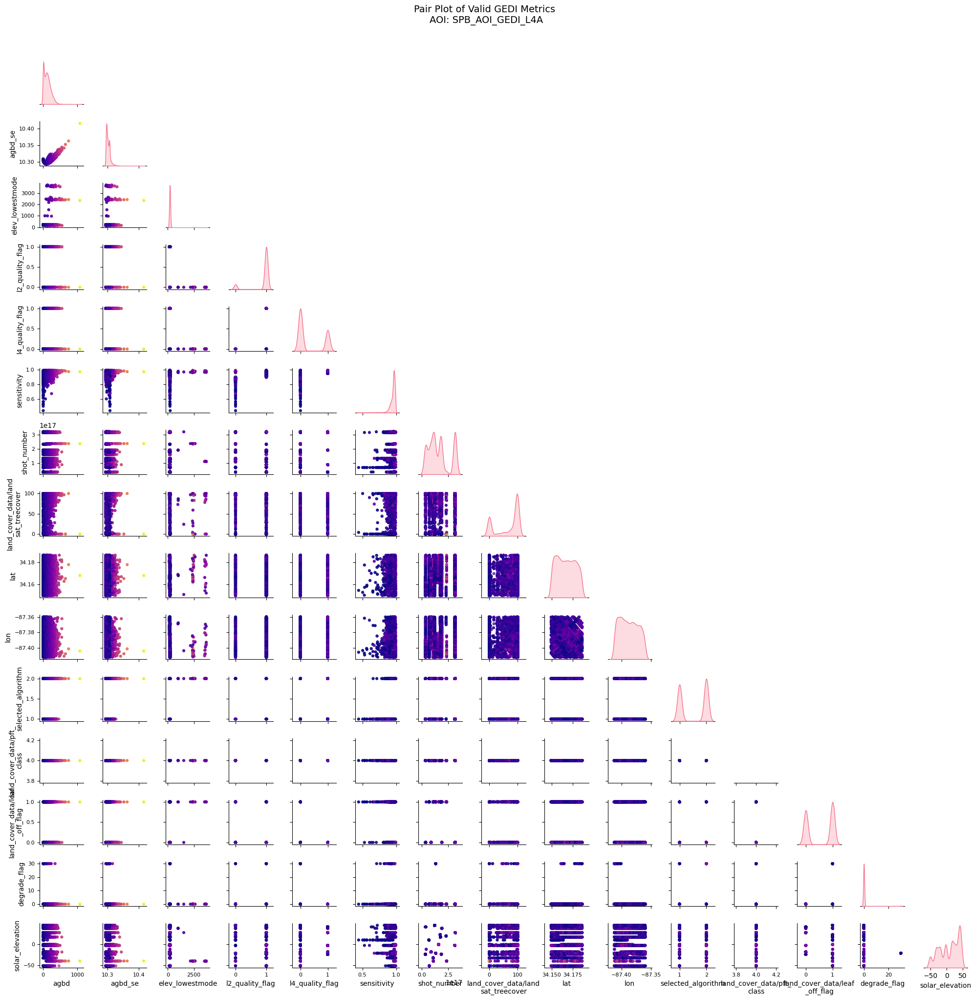

In [ ]:
# -------------------------
# Plot Pairplot for a given AOI
# -------------------------
def plot_pairplot_for_aoi(filtered_geo_dfs, site):
    if site not in filtered_geo_dfs:
        print(f"⚠️ {site} not found in filtered_geo_dfs")
        return

    gdf = filtered_geo_dfs[site]

    # Check numeric columns
    numeric_cols = gdf.select_dtypes(include=[np.number]).columns.tolist()
    if 'agbd' not in numeric_cols or gdf.empty:
        print(f"⚠️ {site} has no numeric data or is missing 'agbd'")
        return

    # Clean data
    plot_df = gdf[numeric_cols].dropna()
    cmap = mpl.colormaps['plasma']

    # Normalize for coloring
    norm = Normalize(vmin=plot_df['agbd'].min(), vmax=plot_df['agbd'].max())
    colors = cmap(norm(plot_df['agbd'].values))

    # Create base pairplot
    pair_grid = sns.pairplot(
        plot_df,
        corner=True,
        diag_kind='kde',
        plot_kws={'s': 10, 'alpha': 0.5, 'color': 'gray'},
        diag_kws={'fill': True}
    )
    pair_grid.fig.set_size_inches(20, 20)

    # Overlay color-coded scatter
    for i, j in zip(*np.tril_indices_from(pair_grid.axes, -1)):
        ax = pair_grid.axes[i, j]
        if ax is not None:
            x = plot_df.iloc[:, j]
            y = plot_df.iloc[:, i]
            ax.scatter(x, y, c=colors, s=12, alpha=0.6)
            ax.set_xlabel(textwrap.fill(plot_df.columns[j], 20), fontsize=10)
            ax.set_ylabel(textwrap.fill(plot_df.columns[i], 20), fontsize=10)
            ax.tick_params(labelsize=8)

    # Optional colorbar
    sm = ScalarMappable(norm=norm, cmap=cmap)
    sm.set_array([])
    # Uncomment to show colorbar
    # pair_grid.fig.colorbar(sm, ax=pair_grid.fig.axes, label='agbd', shrink=0.7, pad=0.02)

    # Title & layout
    pair_grid.fig.suptitle(
        f"Pair Plot of Valid GEDI Metrics \nAOI: {site}",
        fontsize=14, y=1.02
    )
    pair_grid.fig.subplots_adjust(top=0.95, wspace=0.3, hspace=0.3)
    plt.tight_layout()
    plt.show()

# -------------------------
# Interactive widget
# -------------------------
def pick_and_plot_pairplot(filtered_geo_dfs):
    aoi_dropdown = widgets.Dropdown(
        options=list(filtered_geo_dfs.keys()),
        description="Select AOI:",
        style={'description_width': 'initial'},
        layout=widgets.Layout(width='50%')
    )

    out = widgets.Output()

    def on_change(change):
        if change['type'] == 'change' and change['name'] == 'value':
            out.clear_output(wait=True)
            with out:
                plot_pairplot_for_aoi(filtered_geo_dfs, change['new'])

    aoi_dropdown.observe(on_change, names='value')

    display(aoi_dropdown, out)


# -------------------------
# Usage
# -------------------------
pick_and_plot_pairplot(filtered_geo_dfs)


In [ ]:
plt.close()

## Create a filtered dataset: remove no data and apply the filters of your choice
Optionally play around with other combinations of quality filters in the `filtered` variable below.

In [ ]:
#? Play around with additional filters of your choice and plot/evaluate
filt_geo_dfs = {}
for site, gdf in geo_dfs.items():
    #? Ensure required columns exist before filtering, replace variables if using a different gedi product
    required_cols = ['agbd', 'agbd_se', 'l4_quality_flag', 'degrade_flag']
    if all(col in gdf.columns for col in required_cols):
        filtered = gdf[
            (gdf['agbd'] != -9999) &
            (gdf['agbd_se'] != -9999) &
            (gdf['l4_quality_flag'] == 1) &
            (gdf['degrade_flag'] == 0)

        ].copy()
        filt_geo_dfs[site] = filtered
        print(f'{site} dataframe size: ', filt_geo_dfs[site].shape)
    else:
        print(f"{site}: missing one or more required columns, skipped.")

SPB_AOI_GEDI_L4A dataframe size:  (2534, 23)
PaintRock_AOI_GEDI_L4A dataframe size:  (40, 23)


## Pairplot of the final filtered dataset
> Note: Pairplot may take several minutes to generate.

In [ ]:
# -------------------------
# Function to plot pairplot for a selected AOI
# -------------------------
def plot_pairplot_filtered(filtered_geo_dfs, site):
    if site not in filtered_geo_dfs:
        print(f"⚠️ {site} not found in filtered_geo_dfs")
        return

    gdf = filtered_geo_dfs[site]

    # Check numeric columns
    numeric_cols = gdf.select_dtypes(include=[np.number]).columns.tolist()
    if 'agbd' not in numeric_cols or gdf.empty:
        print(f"⚠️ {site} has no numeric data or is missing 'agbd'")
        return

    # Clean data
    plot_df = gdf[numeric_cols].dropna()
    cmap = mpl.colormaps['plasma']

    # Normalize for coloring
    norm = Normalize(vmin=plot_df['agbd'].min(), vmax=plot_df['agbd'].max())
    colors = cmap(norm(plot_df['agbd'].values))

    # Create base pairplot
    pair_grid = sns.pairplot(
        plot_df,
        corner=True,
        diag_kind='kde',
        plot_kws={'s': 10, 'alpha': 0.5, 'color': 'gray'},
        diag_kws={'fill': True}
    )
    pair_grid.fig.set_size_inches(20, 20)

    # Overlay color-coded scatter
    for i, j in zip(*np.tril_indices_from(pair_grid.axes, -1)):
        ax = pair_grid.axes[i, j]
        if ax is not None:
            x = plot_df.iloc[:, j]
            y = plot_df.iloc[:, i]
            ax.scatter(x, y, c=colors, s=12, alpha=0.6)
            ax.set_xlabel(textwrap.fill(plot_df.columns[j], 20), fontsize=10)
            ax.set_ylabel(textwrap.fill(plot_df.columns[i], 20), fontsize=10)
            ax.tick_params(labelsize=8)

    # Optional colorbar
    sm = ScalarMappable(norm=norm, cmap=cmap)
    sm.set_array([])
    # Uncomment to show colorbar
    # pair_grid.fig.colorbar(sm, ax=pair_grid.fig.axes, label='agbd', shrink=0.7, pad=0.02)

    # Title & layout
    pair_grid.fig.suptitle(
        f"Pair Plot of GEDI Metrics Fully Filtered Dataset \nAOI: {site}",
        fontsize=14, y=1.02
    )
    pair_grid.fig.subplots_adjust(top=0.95, wspace=0.3, hspace=0.3)
    plt.tight_layout()
    plt.show()

# -------------------------
# Interactive widget
# -------------------------
def pick_and_plot_pairplot_filtered(filtered_geo_dfs):
    aoi_dropdown = widgets.Dropdown(
        options=list(filtered_geo_dfs.keys()),
        description="Select AOI:",
        style={'description_width': 'initial'},
        layout=widgets.Layout(width='50%')
    )

    out = widgets.Output()

    def on_change(change):
        if change['type'] == 'change' and change['name'] == 'value':
            out.clear_output(wait=True)
            with out:
                plot_pairplot_filtered(filtered_geo_dfs, change['new'])

    aoi_dropdown.observe(on_change, names='value')

    display(aoi_dropdown, out)

# -------------------------
# Usage
# -------------------------
pick_and_plot_pairplot_filtered(filtered_geo_dfs)


Dropdown(description='Select AOI:', layout=Layout(width='50%'), options=('SPB_AOI_GEDI_L4A', 'PaintRock_AOI_GE…

Output()

**Designate a dataframe for each AOI with the final filtered dataset**

In [ ]:
SPB_AOI_filt = filt_geo_dfs.get('SPB_AOI_' + gedi_product, gp.GeoDataFrame())
PaintRock_AOI_filt = filt_geo_dfs.get('PaintRock_AOI_' + gedi_product, gp.GeoDataFrame())
#NewMexico_Pinyon_filt = filt_geo_dfs.get('NewMexico_Pinyon_' + gedi_product, gp.GeoDataFrame())
#Guatemala_SanBartolo_Flooded_filt = filt_geo_dfs.get('Guatemala_SanBartolo_Flooded_' + gedi_product, gp.GeoDataFrame())
#Midwest_corn_filt = filt_geo_dfs.get('Midwest_corn_' + gedi_product, gp.GeoDataFrame())
#CentralValley_Almonds_filt = filt_geo_dfs.get('CentralValley_Almonds_' + gedi_product, gp.GeoDataFrame())
#Nepal_Chitwan_filt = filt_geo_dfs.get('Nepal_Chitwan_' + gedi_product, gp.GeoDataFrame())

SPB_AOI_filt.head()

,agbd,agbd_se,elev_lowestmode,l2_quality_flag,l4_quality_flag,sensitivity,shot_number,land_cover_data/landsat_treecover,lat,lon,...,land_cover_data/leaf_off_flag,degrade_flag,solar_elevation,product,Beam,fileName,date,geometry,Beam_Type,AOI
9,174.542160,10.301247,204.099472,1,1,0.963590,38660000300205577,99.0,34.183556,-87.369061,...,0,0,40.234627,GEDI_L4A,BEAM0000,GEDI04_A_2019230201557_O03866_03_T02897_02_002...,2019-08-18,POINT (-87.36906 34.18356),Coverage,SPB_AOI_GEDI_L4A
10,226.702530,10.303423,211.603348,1,1,0.963120,38660000300205578,100.0,34.183201,-87.368614,...,0,0,40.234318,GEDI_L4A,BEAM0000,GEDI04_A_2019230201557_O03866_03_T02897_02_002...,2019-08-18,POINT (-87.36861 34.1832),Coverage,SPB_AOI_GEDI_L4A
11,258.325745,10.312532,212.408203,1,1,0.970620,38660000300205579,87.0,34.182846,-87.368166,...,0,0,40.234005,GEDI_L4A,BEAM0000,GEDI04_A_2019230201557_O03866_03_T02897_02_002...,2019-08-18,POINT (-87.36817 34.18285),Coverage,SPB_AOI_GEDI_L4A
12,298.861328,10.316467,211.301636,1,1,0.952631,38660000300205580,83.0,34.182491,-87.367717,...,0,0,40.233696,GEDI_L4A,BEAM0000,GEDI04_A_2019230201557_O03866_03_T02897_02_002...,2019-08-18,POINT (-87.36772 34.18249),Coverage,SPB_AOI_GEDI_L4A
15,145.003906,10.298490,210.361511,1,1,0.960100,38660000300205583,99.0,34.181426,-87.366371,...,0,0,40.232761,GEDI_L4A,BEAM0000,GEDI04_A_2019230201557_O03866_03_T02897_02_002...,2019-08-18,POINT (-87.36637 34.18143),Coverage,SPB_AOI_GEDI_L4A


## Map to compare the data with and without the selected filter(s)

Map the data for one AOI at a time. Visualize the spatial spread and locational characteristics impacted by different quality considerations.

> Note: Map may take several minutes to generate and may need to re-run if it times out.

In [ ]:
#? change variables used if using a different gedi product for data, normalization, titles, and names.

# Pick one AOI dataframe by name (replace with the one you want)
site_name = "SPB_AOI_" + str(gedi_product)   #? <--- change this to your AOI name

df = filtered_geo_dfs[site_name]
dff = filt_geo_dfs[site_name]

# Initialize map centered on this dataframe's coordinates
map_center = [df['lat'].mean(), df['lon'].mean()]
m = folium.Map(location=map_center, zoom_start=10)

# Define colormap and normalization just from this dataframe
norm_agbd = Normalize(vmin=df['agbd'].min(), vmax=df['agbd'].max())
norm_agbd_se = Normalize(vmin=df['agbd_se'].min(), vmax=df['agbd_se'].max())

norm_agbdf = Normalize(vmin=dff['agbd'].min(), vmax=dff['agbd'].max())
norm_agbd_sef = Normalize(vmin=dff['agbd_se'].min(), vmax=dff['agbd_se'].max())

cmap = plt.get_cmap('viridis')

# Create feature groups
fg_agbd = folium.FeatureGroup(name=f"{site_name} - agbd valid data")
fg_agbd_se = folium.FeatureGroup(name=f"{site_name} - agbd_se valid data")

fg_agbdf = folium.FeatureGroup(name=f"{site_name} - agbd filtered")
fg_agbd_sef = folium.FeatureGroup(name=f"{site_name} - agbd_se filtered")

# Add markers for the data
for _, row in df.iterrows():
    lat, lon = row['lat'], row['lon']

    # marker 1
    agbd_value = row['agbd']
    if pd.notnull(agbd_value):
        color_agbd = to_hex(cmap(norm_agbd(agbd_value)))
        folium.Circle(
            location=(lat, lon),
            radius=25,
            color=color_agbd,
            fill=True,
            fill_color=color_agbd,
            fill_opacity=0.8,
            weight=2,
            popup=f"agbd: {agbd_value:.2f}"
        ).add_to(fg_agbd)

    # marker 2
    agbd_se_value = row['agbd_se']
    if pd.notnull(agbd_se_value):
        color_agbd_se = to_hex(cmap(norm_agbd_se(agbd_se_value)))
        folium.Circle(
            location=(lat, lon),
            radius=25,
            color=color_agbd_se,
            fill=True,
            fill_color=color_agbd_se,
            fill_opacity=0.8,
            popup=f"agbd_se: {agbd_se_value:.2f}"
        ).add_to(fg_agbd_se)

# Do the same for the fully filtered dataset to compare
for _, row in dff.iterrows():
    lat, lon = row['lat'], row['lon']

    # marker 1
    agbdf_value = row['agbd']
    if pd.notnull(agbdf_value):
        color_agbdf = to_hex(cmap(norm_agbdf(agbdf_value)))
        folium.Circle(
            location=(lat, lon),
            radius=25,
            color=color_agbdf,
            fill=True,
            fill_color=color_agbdf,
            fill_opacity=0.8,
            weight=2,
            popup=f"agbd: {agbdf_value:.2f}"
        ).add_to(fg_agbdf)

    # marker 2
    agbd_sef_value = row['agbd_se']
    if pd.notnull(agbd_sef_value):
        color_agbd_sef = to_hex(cmap(norm_agbd_sef(agbd_sef_value)))
        folium.Circle(
            location=(lat, lon),
            radius=25,
            color=color_agbd_sef,
            fill=True,
            fill_color=color_agbd_sef,
            fill_opacity=0.8,
            popup=f"agbd_se: {agbd_sef_value:.2f}"
        ).add_to(fg_agbd_sef)


# Add feature groups to map
fg_agbd.add_to(m)
fg_agbd_se.add_to(m)

fg_agbdf.add_to(m)
fg_agbd_sef.add_to(m)

# Add layer control
folium.LayerControl(collapsed=False).add_to(m)

# Save and display
#m.save(f"{site_name}_fhd_pai_map.html")
m

**Check which beams are retained in each AOI**

In [ ]:
print("\nBeam values found:")
for site, gdf in filt_geo_dfs.items():
    if not gdf.empty and 'Beam' in gdf.columns:
        unique_beams = gdf['Beam'].unique()
        print(f"{site}: {sorted(unique_beams)}")
    else:
        print(f"{site}: No beam data available")


Beam values found:
SPB_AOI_GEDI_L4A: ['BEAM0000', 'BEAM0001', 'BEAM0010', 'BEAM0011', 'BEAM0101', 'BEAM0110', 'BEAM1000', 'BEAM1011']
PaintRock_AOI_GEDI_L4A: ['BEAM0010', 'BEAM0011', 'BEAM0101', 'BEAM0110', 'BEAM1011']


## Optional: Save to drive the final filtered datasets CSVs
The rest of the tutorial is not dependent on these exported csvs, this is an optional step for each if you wish to export to data to handle across platforms and to compare to the original dataset optionally exported earlier.

In [ ]:
#? Path in Google Drive where you want to save the CSVs
drive_save_dir = "/content/drive/MyDrive/GEDI_L4a" #?
os.makedirs(drive_save_dir, exist_ok=True)

# Loop over each key, GeoDataFrame pair in the dictionary
for site, gdf in filt_geo_dfs.items():
    if gdf is not None and not gdf.empty:
        # Drop geometry before saving
        gdf_no_geom = gdf.drop(columns='geometry')

        # Construct a clean filename
        csv_filename = f"{site}_{gedi_product}_filt.csv"
        csv_path = os.path.join(drive_save_dir, csv_filename)

        # Save to CSV
        gdf_no_geom.to_csv(csv_path, index=False)
        print(f"✅ Saved to Google Drive: {csv_path}")
    else:
        print(f"⚠️ Skipped: {site} (GeoDataFrame is empty or missing)")

✅ Saved to Google Drive: /content/drive/MyDrive/GEDI_L4a/SPB_AOI_GEDI_L4A_GEDI_L4A_filt.csv
✅ Saved to Google Drive: /content/drive/MyDrive/GEDI_L4a/PaintRock_AOI_GEDI_L4A_GEDI_L4A_filt.csv




---


# Step 6) Plot and explore the data

## Tutorial Overview
<ol>
  <li>Setup your environment and directories</li>
  <li>Access, filter and download the raw GEDI HDF5 files:
    <ol type="a">
      <li>Authenticate your EarthData Access login</li>
      <li>Create the Harmony API data product, spatial, and temporal request parameters and download the files</li>
    </ol>
  </li>
  <li>Subset the desired GEDI variables and convert the data to GeoDataFrame and CSV formats</li>
  </li>
  <li>Explore data quality filtering techniques</li>
  </li>
  <li>Generate the final dataset</li>
  </li>
  <li><strong>Plot and explore the data</strong></li>
  </li>
</ol>

## Heatmap of Pearson's Correlation by beam type across variables
Get correlations between variables depending on beam configurations for the final filtered dataset.

In [ ]:
# -------------------------
# Helper: Drop specified columns safely
# -------------------------
def drop_columns(corr_mtx, cols):
    cols_exist = [c for c in cols if c in corr_mtx.columns]
    return corr_mtx.drop(columns=cols_exist, index=cols_exist)

# -------------------------
# Plot correlation heatmaps for one AOI
# -------------------------
def plot_correlation_heatmaps(filt_geo_dfs, site):
    if site not in filt_geo_dfs:
        print(f"⚠️ {site} not found in filt_geo_dfs")
        return

    gdf = filt_geo_dfs[site]

    if gdf.empty:
        print(f"⚠️ Could not generate plot for {site}: dataframe is empty")
        return

    # Split into Power and Coverage
    power = gdf[gdf['Beam_Type'] == 'Power']
    coverage = gdf[gdf['Beam_Type'] == 'Coverage']

    # Columns to drop from correlation
    drop_cols = ['l4_quality_flag', 'degrade_flag']

    # Compute correlations
    co_mtx0 = drop_columns(gdf.corr(numeric_only=True), drop_cols)
    co_mtx  = drop_columns(power.corr(numeric_only=True), drop_cols)
    co_mtx2 = drop_columns(coverage.corr(numeric_only=True), drop_cols)

    # Plot side-by-side heatmaps
    fig, axes = plt.subplots(2, 2, figsize=(22, 13), sharey=True)

    sns.heatmap(co_mtx0, ax=axes[0, 0], cmap="magma", annot=True, cbar=False, xticklabels=False)
    axes[0, 0].set_title("All Beams")

    axes[0, 1].axis('off')

    sns.heatmap(co_mtx, ax=axes[1, 0], cmap="magma", annot=True, cbar=False)
    axes[1, 0].set_title("Power Beams")

    sns.heatmap(co_mtx2, ax=axes[1, 1], cmap="magma", annot=True)
    axes[1, 1].set_title("Coverage Beams")

    plt.suptitle(f"Pearson's Correlation Heatmap of Final Dataset for {site}", fontsize=16)
    plt.tight_layout()
    plt.show()

# -------------------------
# Interactive widget
# -------------------------
def pick_and_plot_correlation(filt_geo_dfs):
    aoi_dropdown = widgets.Dropdown(
        options=list(filt_geo_dfs.keys()),
        description="Select AOI:",
        style={'description_width': 'initial'},
        layout=widgets.Layout(width='50%')
    )

    out = widgets.Output()

    def on_change(change):
        if change['type'] == 'change' and change['name'] == 'value':
            out.clear_output(wait=True)
            with out:
                plot_correlation_heatmaps(filt_geo_dfs, change['new'])

    aoi_dropdown.observe(on_change, names='value')

    display(aoi_dropdown, out)

# -------------------------
# Usage
# -------------------------
pick_and_plot_correlation(filt_geo_dfs)


Dropdown(description='Select AOI:', layout=Layout(width='50%'), options=('SPB_AOI_GEDI_L4A', 'PaintRock_AOI_GE…

Output()

## Monthly summary violin plots
Visualize the actual data resulting from the applied pre-processing, how the values are distributed across the y-axis while the width of the violin describes amount of observations relating to that data value. Demonstrating the data distribution temporally can offer insights on the impacts of seasonality/phenology to what GEDI captures.

In [ ]:
# -------------------------
# Violin plot for a single AOI
# -------------------------
def plot_violin_for_aoi(geo_dfs, site, var):
    if site not in geo_dfs:
        print(f"⚠️ {site} not found in geo_dfs")
        return

    gdf = geo_dfs[site]
    if gdf.empty or var not in gdf.columns:
        print(f"⚠️ {site} is missing '{var}' or dataframe is empty")
        return

    month_names = ['Jan','Feb','Mar','Apr','May','Jun',
                   'Jul','Aug','Sep','Oct','Nov','Dec']
    palette = sns.color_palette('Set2', 12)
    month_colors = {i+1: palette[i] for i in range(12)}

    work_df = gdf.drop(columns=['geometry'], errors='ignore').copy()
    date_info = work_df['date'].apply(safe_extract_date_info)
    work_df['Year'] = [info[0] for info in date_info]
    work_df['Month'] = [info[1] for info in date_info]
    work_df['AOI'] = site

# --- Filter out negative values ---
    work_df = work_df[work_df[var] >= 0]
    years = sorted(work_df['Year'].dropna().unique())
    if not years:
      print(f"⚠️ {site} has no valid years")
      return

    n_years = len(years)
    ncols = 2
    nrows = int(np.ceil(n_years / ncols))

    fig, axes = plt.subplots(nrows, ncols, figsize=(16, 5*nrows), sharex=False)
    axes = axes.flatten()

    if n_years == 1:
        axes = [axes]

    for ax, year in zip(axes, years):
        year_data = work_df[work_df['Year']==year]
        available_months = sorted(year_data['Month'].dropna().unique())
        colors = [month_colors[month] for month in available_months]

        sns.violinplot(
            data=year_data,
            x='Month', y=var,
            order=range(1,13),
            density_norm='width',
            inner='quartile',
            palette=colors,
            hue='Month',
            legend=False,
            ax=ax,
            inner_kws=dict(linewidth=1.5)
        )

        ax.set_title(f"Data Distribution in {site} - {year}", fontsize=16, fontweight='bold')
        ax.set_xlabel("Month", fontsize=14)
        ax.set_ylabel(str(var), fontsize=14)
        ax.set_xticks(range(12))
        ax.set_xticklabels(month_names, rotation=45)

    plt.tight_layout()
    plt.show()

# -------------------------
# Interactive widget
# -------------------------
def pick_and_plot_violin(geo_dfs, var_options):
    aoi_dropdown = widgets.Dropdown(
        options=list(geo_dfs.keys()),
        description="Select AOI:",
        style={'description_width': 'initial'},
        layout=widgets.Layout(width='50%')
    )

    var_dropdown = widgets.Dropdown(
        options=var_options,
        description="Select Variable:",
        style={'description_width': 'initial'},
        layout=widgets.Layout(width='50%')
    )

    out = widgets.Output()

    def on_change(change):
        if change['type'] == 'change' and change['name'] == 'value':
            out.clear_output(wait=True)
            with out:
                plot_violin_for_aoi(geo_dfs, aoi_dropdown.value, var_dropdown.value)

    aoi_dropdown.observe(on_change, names='value')
    var_dropdown.observe(on_change, names='value')

    display(widgets.HBox([aoi_dropdown, var_dropdown]), out)

# -------------------------
# Usage example
# -------------------------
# Provide a list of numeric variables you want to allow in the widget
numeric_vars = ['agbd', 'agbd_se']  # replace with your available numeric columns
pick_and_plot_violin(geo_dfs, numeric_vars)


Output()

## 3-D Visualizations for each AOI
Interact with three-dimensional visualizations of the data. Use the different zoom effects to access viewpoints along each axis and direction.

**Define the 3-D scatter plot function**

In [ ]:
# Function to build a Scatter3D with auto z scaling + spectrum colors
def make_scatter3d(x, y, z, x_name, y_name, z_name, title):
    zmin, zmax = np.min(z), np.max(z) #true min and max of the z-axis data
    return hv.Scatter3D((x, y, z)).opts(
        opts.Scatter3D(
            title=title,
            color='z',              # color mapped to z-values
            cmap='fire',
            size=5,                 # marker size
            alpha=0.6,
            clim=(zmin, zmax),  # auto z color scaling
            zlim=(zmin, zmax),
            xlabel=x_name,
            ylabel=y_name,
            zlabel=z_name,
            width=600,
            height=600,
        )
    )

**Plot the data along the latitude and longitude**

In [ ]:
hv.extension('plotly')  # keep interactive


# -------------------------
# Function to plot 3D scatter for a single AOI
# -------------------------
def plot_3d_scatter_aoi(filt_geo_dfs, site):
    if site not in filt_geo_dfs:
        print(f"⚠️ {site} not found in filt_geo_dfs")
        return

    gdf = filt_geo_dfs[site]
    if gdf.empty:
        print(f"⚠️ {site} dataframe is empty")
        return

    # Filter out negative values if needed
    x = gdf['lat']
    y = gdf['lon']
    agbd = gdf['agbd']

    # Example: remove negative or invalid AGBD values
    valid_mask = agbd >= 0
    x = x[valid_mask]
    y = y[valid_mask]
    agbd = agbd[valid_mask]

    # Create 3D scatter
    scatter = hv.Scatter3D((x, y, agbd), kdims=['Latitude','Longitude','AGBD'], vdims='AGBD')
    scatter.opts(title=f"{site}: AGBD", width=700, height=500)

    display(scatter)

# -------------------------
# Interactive widget
# -------------------------
def pick_and_plot_3d(filt_geo_dfs):
    aoi_dropdown = widgets.Dropdown(
        options=list(filt_geo_dfs.keys()),
        description="Select AOI:",
        style={'description_width': 'initial'},
        layout=widgets.Layout(width='50%')
    )

    out = widgets.Output()

    def on_change(change):
        if change['type'] == 'change' and change['name'] == 'value':
            out.clear_output(wait=True)
            with out:
                plot_3d_scatter_aoi(filt_geo_dfs, change['new'])

    aoi_dropdown.observe(on_change, names='value')

    display(aoi_dropdown, out)

# -------------------------
# Usage
# -------------------------
pick_and_plot_3d(filt_geo_dfs)


<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W

Dropdown(description='Select AOI:', layout=Layout(width='50%'), options=('SPB_AOI_GEDI_L4A', 'PaintRock_AOI_GE…

Output()

**Plot static 3D plots comparing the data across AOIs**

In [ ]:
# -------------------------
# 3D plot for a single AOI
# -------------------------
def plot_3d_agbd_aoi(filt_geo_dfs, site):
    if site not in filt_geo_dfs:
        print(f"⚠️ {site} not found in filt_geo_dfs")
        return

    gdf = filt_geo_dfs[site]
    if gdf.empty:
        print(f"⚠️ {site} dataframe is empty")
        return

    # Filter out negative values
    gdf = gdf[gdf['agbd'] >= 0]

    x = gdf['lat']
    y = gdf['lon']
    z = gdf['agbd']

    # Global min/max for color normalization
    agbd_min = z.min()
    agbd_max = z.max()

    fig = plt.figure(figsize=(8, 6))
    ax = fig.add_subplot(111, projection='3d')
    scatter = ax.scatter(x, y, z, c=z, cmap='viridis', s=5, vmin=agbd_min, vmax=agbd_max)
    ax.set_xlabel('Latitude')
    ax.set_ylabel('Longitude')
    ax.set_zlabel('AGBD')
    ax.set_title(f"{site} - AGBD")
    ax.set_zlim(agbd_min, agbd_max)

    # Add colorbar
    cbar = plt.colorbar(scatter, ax=ax, shrink=0.5, pad=0.1)
    cbar.set_label('AGBD')

    plt.tight_layout()
    plt.show()

# -------------------------
# Widget to pick AOI
# -------------------------
def pick_and_plot_3d_agbd(filt_geo_dfs):
    aoi_dropdown = widgets.Dropdown(
        options=list(filt_geo_dfs.keys()),
        description="Select AOI:",
        style={'description_width': 'initial'},
        layout=widgets.Layout(width='50%')
    )

    out = widgets.Output()

    def on_change(change):
        if change['type'] == 'change' and change['name'] == 'value':
            out.clear_output(wait=True)
            with out:
                plot_3d_agbd_aoi(filt_geo_dfs, change['new'])

    aoi_dropdown.observe(on_change, names='value')
    display(aoi_dropdown, out)

# -------------------------
# Usage
# -------------------------
pick_and_plot_3d_agbd(filt_geo_dfs)


Dropdown(description='Select AOI:', layout=Layout(width='50%'), options=('SPB_AOI_GEDI_L4A', 'PaintRock_AOI_GE…

Output()

## Variables Key for Understand Forest Ecosystems

**Core Biomass Variables:**

*   'agbd' (Aboveground Biomass Density): essential for quantifying carbon storage and monitoring forest biomass changes over time.
*   'agbd_se' (AGBD Standard Error): this uncertainty measure is crucial for assessing data reliability and confidence intervals in biomass estimates.

**Quality Control Variables:**
*    l2_quality_flag: Essential for filtering high-quality observations.
*   l4_quality_flag: Critical for ensuring biomass predictions are appropriate for the given forest type.
*   degrade_flag - Indicates potential data degradation issues that could affect biomass estimate accuracy.

**Geolocation and Terrain Variables:**
*   lat_lowestmode, lon_lowestmode - Precise geographic coordinates of each measurement, essential for spatial analysis and change detection studies.
*   elev_lowestmode - Ground elevation data that helps correct for topographic effects on biomass estimates and enables terrain-corrected analyses.
*   shot_number - Unique identifier for each laser pulse, crucial for data tracking, quality control, and linking measurements across different processing levels.

**Algorithm and Processing Variables:**
* selected_algorithm - Indicates which biomass estimation model was used, important because the outputs of parameters and variables from the L4A models used to generate AGBD predictions
*   predict_stratum - Identifies the ecological stratum or forest type category used in the prediction model, essential for understanding model applicability and accuracy.
*   sensitivity - Measures the laser's ability to penetrate the canopy and detect the ground, affecting the quality of biomass estimates, particularly in dense forests.

**Environmental Context Variables:**
*   land_cover_data/pft_class (Plant Functional Type) -  crucial for applying appropriate biomass models and understanding ecosystem characteristics.
*   land_cover_data/leaf_off_flag - Indicates whether measurements were taken during leaf-on or leaf-off conditions, affecting biomass estimates in deciduous forests.
* geolocation/solar_elevation - Sun angle during measurement, which can affect waveform quality and processing algorithms.
* geolocation/local_beam_elevation - GEDI beam angle relative to local terrain, important for understanding measurement geometry and potential biases.

##**"How does tree cover relate to aboveground biomass density (AGBD) across different areas of interest?**

Dropdown(description='Select AOI to visualize Tree Cover & Biomass:', layout=Layout(width='60%'), options=('SP…

Output()

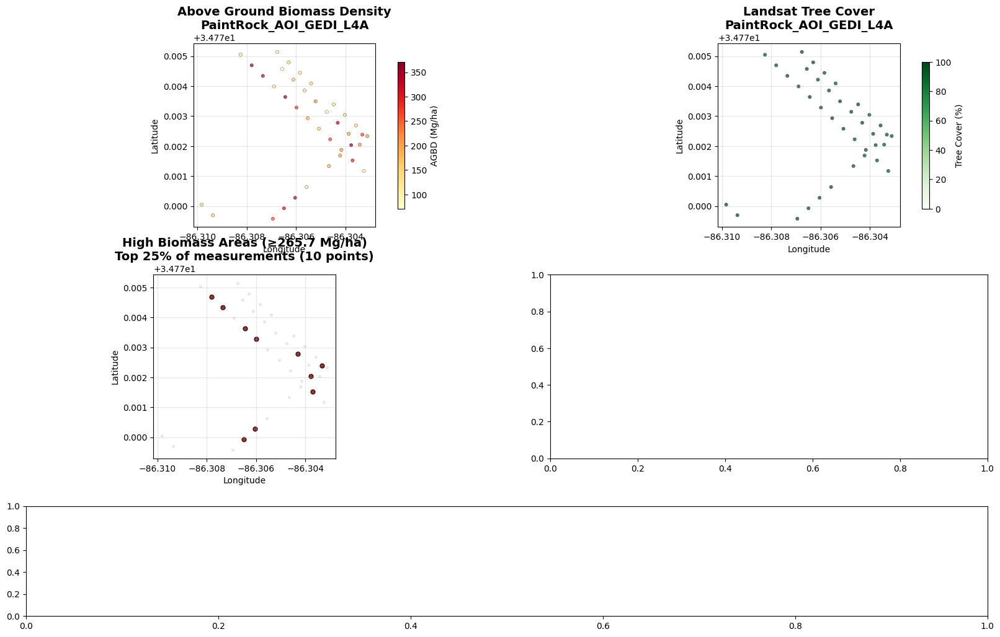

In [ ]:
# ---------------------------
# Function: Create Tree Cover vs Biomass Maps
# ---------------------------
def create_tree_cover_biomass_maps(gdf, site_name="Study Area", remove_outliers=True):
    """
    Create side-by-side maps comparing tree cover and biomass with correlation analysis
    """
    print(f"\n=== Creating Tree Cover vs Biomass Maps for {site_name} ===")

    required_cols = ['agbd', 'land_cover_data/landsat_treecover']
    missing_cols = [col for col in required_cols if col not in gdf.columns]
    if missing_cols:
        print(f"❌ Missing columns: {missing_cols}")
        return

    # Working copy
    plot_gdf = gdf.copy()
    plot_gdf = plot_gdf.rename(columns={'land_cover_data/landsat_treecover': 'tree_cover'})

    # Remove invalid values
    initial_count = len(plot_gdf)
    plot_gdf = plot_gdf[
        (plot_gdf['agbd'] >= 0) & (plot_gdf['agbd'] != -9999) &
        (plot_gdf['tree_cover'] >= 0) & (plot_gdf['tree_cover'] <= 100) &
        (~plot_gdf['agbd'].isna()) & (~plot_gdf['tree_cover'].isna())
    ]
    cleaned_count = len(plot_gdf)
    print(f"Data cleaning: {initial_count} → {cleaned_count} points ({cleaned_count/initial_count*100:.1f}% retained)")

    if plot_gdf.empty:
        print("❌ No valid data remaining after cleaning")
        return

    # Optional outlier removal
    if remove_outliers:
        def remove_outliers_iqr(df, column, factor=1.5):
            Q1 = df[column].quantile(0.25)
            Q3 = df[column].quantile(0.75)
            IQR = Q3 - Q1
            lower_bound = Q1 - factor * IQR
            upper_bound = Q3 + factor * IQR
            mask = (df[column] >= lower_bound) & (df[column] <= upper_bound)
            return df[mask], (~mask).sum()

        plot_gdf, agbd_outliers = remove_outliers_iqr(plot_gdf, 'agbd')
        plot_gdf, tc_outliers = remove_outliers_iqr(plot_gdf, 'tree_cover')
        if agbd_outliers > 0 or tc_outliers > 0:
            print(f"Outliers removed: {agbd_outliers} AGBD, {tc_outliers} Tree Cover")
            print(f"Final data points: {len(plot_gdf)}")

    if len(plot_gdf) < 10:
        print("❌ Insufficient data points for meaningful analysis")
        return

    # Statistics
    agbd_stats = plot_gdf['agbd'].describe()
    tc_stats = plot_gdf['tree_cover'].describe()

    # Check for constant arrays before calculating correlation
    agbd_var = plot_gdf['agbd'].var()
    tc_var = plot_gdf['tree_cover'].var()

    # Skip visualization if data is too uniform for meaningful analysis
    if agbd_var == 0 and tc_var == 0:
        print(f"❌ Both AGBD and Tree Cover are constant - no meaningful analysis possible")
        print(f"   AGBD: {agbd_stats['mean']:.1f} Mg/ha (all values identical)")
        print(f"   Tree Cover: {tc_stats['mean']:.1f}% (all values identical)")
        return
    elif agbd_var == 0:
        print(f"❌ All AGBD values are constant ({agbd_stats['mean']:.1f} Mg/ha) - no meaningful scatter plot possible")
        print(f"   Cannot analyze relationship when one variable has no variation")
        return
    elif tc_var == 0:
        print(f"❌ All Tree Cover values are constant ({tc_stats['mean']:.1f}%) - no meaningful scatter plot possible")
        print(f"   Cannot analyze relationship when one variable has no variation")
        return
    else:
        try:
            correlation, p_value = pearsonr(plot_gdf['agbd'], plot_gdf['tree_cover'])
            correlation_status = f"r = {correlation:.3f}, p = {p_value:.3e}"
        except Exception as e:
            print(f"⚠️ Warning: Correlation calculation failed: {e}")
            correlation, p_value = np.nan, np.nan
            correlation_status = "Cannot calculate (error)"

    print(f"AGBD range: {agbd_stats['min']:.1f}-{agbd_stats['max']:.1f} Mg/ha (mean: {agbd_stats['mean']:.1f})")
    print(f"Tree Cover range: {tc_stats['min']:.1f}-{tc_stats['max']:.1f}% (mean: {tc_stats['mean']:.1f})")
    print(f"Correlation: {correlation_status}")

    # Ensure CRS
    if plot_gdf.crs is None:
        plot_gdf = plot_gdf.set_crs(epsg=4326)
    elif plot_gdf.crs.to_epsg() != 4326:
        plot_gdf = plot_gdf.to_crs(epsg=4326)

    # Check data availability for specialized plots
    high_biomass_threshold = plot_gdf['agbd'].quantile(0.75)
    high_biomass_gdf = plot_gdf[plot_gdf['agbd'] >= high_biomass_threshold]
    high_tc_gdf = plot_gdf[plot_gdf['tree_cover'] >= 75]

    # Determine which plots to create based on data availability
    has_high_biomass = not high_biomass_gdf.empty
    has_high_tc = not high_tc_gdf.empty

    # Print warnings for empty categories
    if not has_high_biomass:
        print(f"⚠️ No high biomass points ≥{high_biomass_threshold:.1f} Mg/ha found in this AOI")
    if not has_high_tc:
        print(f"⚠️ No high tree cover points ≥75% found in this AOI")

    # Adjust subplot layout based on what we can plot
    if has_high_biomass and has_high_tc:
        # Full layout: all 4 maps + scatter plot
        fig = plt.figure(figsize=(20, 12))
        gs = fig.add_gridspec(3, 2, height_ratios=[2, 2, 1.2], hspace=0.3, wspace=0.2)
        ax1 = fig.add_subplot(gs[0,0])
        ax2 = fig.add_subplot(gs[0,1])
        ax3 = fig.add_subplot(gs[1,0])
        ax4 = fig.add_subplot(gs[1,1])
        ax5 = fig.add_subplot(gs[2,:])
    elif has_high_biomass and not has_high_tc:
        # Only high biomass available: basic maps + high biomass + scatter
        fig = plt.figure(figsize=(18, 12))
        gs = fig.add_gridspec(3, 2, height_ratios=[2, 2, 1.2], hspace=0.3, wspace=0.2)
        ax1 = fig.add_subplot(gs[0,0])
        ax2 = fig.add_subplot(gs[0,1])
        ax3 = fig.add_subplot(gs[1,:])  # High biomass takes full width
        ax5 = fig.add_subplot(gs[2,:])  # Scatter plot
        ax4 = None
    elif not has_high_biomass and has_high_tc:
        # Only high tree cover available: basic maps + high tree cover + scatter
        fig = plt.figure(figsize=(18, 12))
        gs = fig.add_gridspec(3, 2, height_ratios=[2, 2, 1.2], hspace=0.3, wspace=0.2)
        ax1 = fig.add_subplot(gs[0,0])
        ax2 = fig.add_subplot(gs[0,1])
        ax4 = fig.add_subplot(gs[1,:])  # High tree cover takes full width
        ax5 = fig.add_subplot(gs[2,:])  # Scatter plot
        ax3 = None
    else:
        # Minimal layout: just basic maps + scatter plot
        fig = plt.figure(figsize=(16, 10))
        gs = fig.add_gridspec(2, 2, height_ratios=[2, 1.2], hspace=0.3, wspace=0.2)
        ax1 = fig.add_subplot(gs[0,0])
        ax2 = fig.add_subplot(gs[0,1])
        ax5 = fig.add_subplot(gs[1,:])  # Scatter plot takes full width
        ax3 = None
        ax4 = None

    # --- Map 1: AGBD (always shown) ---
    agbd_norm = Normalize(vmin=plot_gdf['agbd'].quantile(0.02), vmax=plot_gdf['agbd'].quantile(0.98))
    plot_gdf.plot(column='agbd', ax=ax1, cmap='YlOrRd', norm=agbd_norm,
                  markersize=15, alpha=0.7, edgecolors='black', linewidth=0.3)
    ax1.set_title(f'Above Ground Biomass Density\n{site_name}', fontsize=14, fontweight='bold')
    ax1.set_xlabel('Longitude'); ax1.set_ylabel('Latitude'); ax1.grid(True, alpha=0.3)
    sm1 = plt.cm.ScalarMappable(cmap='YlOrRd', norm=agbd_norm)
    sm1.set_array([]); plt.colorbar(sm1, ax=ax1, shrink=0.8, label='AGBD (Mg/ha)')

    # --- Map 2: Tree Cover (always shown) ---
    tc_norm = Normalize(vmin=0, vmax=100)
    plot_gdf.plot(column='tree_cover', ax=ax2, cmap='Greens', norm=tc_norm,
                  markersize=15, alpha=0.7, edgecolors='black', linewidth=0.3)
    ax2.set_title(f'Landsat Tree Cover\n{site_name}', fontsize=14, fontweight='bold')
    ax2.set_xlabel('Longitude'); ax2.set_ylabel('Latitude'); ax2.grid(True, alpha=0.3)
    sm2 = plt.cm.ScalarMappable(cmap='Greens', norm=tc_norm)
    sm2.set_array([]); plt.colorbar(sm2, ax=ax2, shrink=0.8, label='Tree Cover (%)')

    # --- Create specialized maps only when data is available ---
    if has_high_biomass and ax3 is not None:
        # Map 3: High Biomass
        low_biomass_gdf = plot_gdf[plot_gdf['agbd'] < high_biomass_threshold]
        low_biomass_gdf.plot(ax=ax3, color='lightgray', markersize=8, alpha=0.4)
        high_biomass_gdf.plot(ax=ax3, color='darkred', markersize=25, alpha=0.8, edgecolors='black')
        ax3.set_title(f'High Biomass Areas (≥{high_biomass_threshold:.1f} Mg/ha)\nTop 25% of measurements ({len(high_biomass_gdf)} points)',
                      fontsize=14, fontweight='bold')
        ax3.set_xlabel('Longitude'); ax3.set_ylabel('Latitude'); ax3.grid(True, alpha=0.3)

    if has_high_tc and ax4 is not None:
        # Map 4: High Tree Cover
        low_tc_gdf = plot_gdf[plot_gdf['tree_cover'] < 75]

        # Why 75%? It marks a point where tree cover is “substantially dense.” Ecologists often use ≥75% as a simple cutoff for “high canopy cover” versus moderate or sparse forest.
        # Anything lower, say 50%, could include areas that are only partially forested or mixed land use, which might dilute the signal when comparing to biomass.
        #50%: Would include too many moderate-density areas, making the “high tree cover” map less distinctive
        # 90%+: Might exclude too many points, leaving too few for visualization or correlation analysis.

        low_tc_gdf.plot(ax=ax4, color='lightgray', markersize=8, alpha=0.4)
        high_tc_gdf.plot(ax=ax4, color='darkgreen', markersize=25, alpha=0.8, edgecolors='black')
        ax4.set_title(f'High Tree Cover Areas (≥75%)\n{len(high_tc_gdf)} of {len(plot_gdf)} measurements',
                      fontsize=14, fontweight='bold')
        ax4.set_xlabel('Longitude'); ax4.set_ylabel('Latitude'); ax4.grid(True, alpha=0.3)

    # --- Scatter Plot: Tree Cover vs AGBD ---
    scatter = ax5.scatter(plot_gdf['tree_cover'], plot_gdf['agbd'], c=plot_gdf['tree_cover'],
                         cmap='RdYlGn', alpha=0.6, s=30, edgecolors='black', linewidth=0.3)

    # Set proper axis limits based on actual data range
    ax5.set_xlim(plot_gdf['tree_cover'].min() - 2, plot_gdf['tree_cover'].max() + 2)
    ax5.set_ylim(plot_gdf['agbd'].min() - 2, max(plot_gdf['agbd'].max() + 2, 5))  # Ensure min height of 5

    # Only add trend line if correlation is valid
    if not np.isnan(correlation):
        try:
            z = np.polyfit(plot_gdf['tree_cover'], plot_gdf['agbd'], 1)
            p = np.poly1d(z)
            tc_sorted = plot_gdf['tree_cover'].sort_values()
            ax5.plot(tc_sorted, p(tc_sorted),
                     "r--", alpha=0.8, linewidth=2, label=f'Trend line (r = {correlation:.3f})')
            ax5.legend()
        except Exception as e:
            print(f"⚠️ Warning: Could not fit trend line: {e}")

    ax5.set_xlabel('Landsat Tree Cover (%)'); ax5.set_ylabel('AGBD (Mg/ha)')
    ax5.set_title(f'Tree Cover vs Biomass Relationship\n{site_name} (n = {len(plot_gdf):,} measurements)',
                  fontsize=14, fontweight='bold')
    ax5.grid(True, alpha=0.3)

    # Statistics textbox with conditional correlation display
    if not np.isnan(correlation):
        corr_text = f"r = {correlation:.3f} (p = {p_value:.2e})"
    else:
        corr_text = correlation_status

    stats_text = f'''Statistics:
Correlation: {corr_text}
AGBD: {agbd_stats['mean']:.1f} ± {agbd_stats['std']:.1f} Mg/ha
Tree Cover: {tc_stats['mean']:.1f} ± {tc_stats['std']:.1f}%
Data Points: {len(plot_gdf):,}'''
    ax5.text(0.02, 0.98, stats_text, transform=ax5.transAxes,
             bbox=dict(boxstyle="round,pad=0.5", facecolor="wheat", alpha=0.8),
             verticalalignment='top', fontsize=10, fontfamily='monospace')

    # Overall title
    fig.suptitle(f'Tree Cover vs Biomass Analysis: {site_name}',
                 fontsize=16, fontweight='bold', y=0.95)
    #plt.tight_layout()
    plt.show()

    # Summary insights
    print(f"\n=== Analysis Summary ===")
    if not np.isnan(correlation):
        strength = 'Strong' if abs(correlation) > 0.7 else 'Moderate' if abs(correlation) > 0.4 else 'Weak'
        print(f"• {strength} correlation between tree cover and biomass (r = {correlation:.3f})")
    else:
        print(f"• Correlation analysis not possible: {correlation_status}")

    if has_high_biomass:
        print(f"• High biomass areas (≥{high_biomass_threshold:.1f} Mg/ha): {len(high_biomass_gdf)} locations")
    else:
        print(f"• No high biomass areas found (threshold: {high_biomass_threshold:.1f} Mg/ha, max: {plot_gdf['agbd'].max():.1f} Mg/ha)")

    if has_high_tc:
        print(f"• High tree cover areas (≥75%): {len(high_tc_gdf)} locations")
    else:
        print(f"• No high tree cover areas found (threshold: 75%, max: {plot_gdf['tree_cover'].max():.1f}%)")

    if has_high_biomass and has_high_tc:
        try:
            overlap = len(gpd.sjoin(high_biomass_gdf, high_tc_gdf, how='inner', predicate='intersects'))
            print(f"• Overlap between high biomass & high tree cover: {overlap} locations")
        except Exception as e:
            print(f"• Could not calculate overlap: {e}")

    return plot_gdf

# -------------------------
# Widget to pick AOI and visualize Tree Cover vs Biomass
# -------------------------
def pick_and_plot_tree_cover_biomass(filt_geo_dfs):
    aoi_dropdown = widgets.Dropdown(
        options=list(filt_geo_dfs.keys()),
        description="Select AOI to visualize Tree Cover & Biomass:",
        style={'description_width': 'initial'},
        layout=widgets.Layout(width='60%')
    )

    out = widgets.Output()

    def on_change(change):
        if change['type'] == 'change' and change['name'] == 'value':
            out.clear_output(wait=True)
            with out:
                site_name = change['new']
                print(f"\n🔹 Visualizing Tree Cover vs Biomass for AOI: {site_name}")
                create_tree_cover_biomass_maps(filt_geo_dfs[site_name], site_name=site_name)

    aoi_dropdown.observe(on_change, names='value')
    display(aoi_dropdown, out)

# -------------------------
# Usage
# -------------------------
pick_and_plot_tree_cover_biomass(filt_geo_dfs)

##**“What is the distribution of plant functional types (PFTs) within this AOI?”**

This chart shows how many GEDI L4A measurements fall into each PFT class, summarizing which vegetation types dominate this area according to GEDI PFT classification.

In [ ]:
# --------------------------
# Function to plot PFT distribution
# --------------------------
def plot_pft_distribution(df, site_name="Study Area"):
    """
    Plot the frequency of GEDI PFT classes for a given dataframe.
    """
    # Map GEDI PFT classes to names
    pft_mapping = {
        1: "Evergreen Needleleaf Trees (ENT)",
        2: "Evergreen Broadleaf Trees (EBT)",
        3: "Deciduous Needleleaf Trees (DNT)",
        4: "Deciduous Broadleaf Trees (DBT)",
        5: "Grasses/Shrubs/Woodlands (GSW)",
        6: "Grasses/Shrubs/Woodlands (GSW)"
    }

    if "land_cover_data/pft_class" not in df.columns:
        print(f"❌ Column 'land_cover_data/pft_class' not found in {site_name}")
        return

    # Extract and map PFT data
    pft_data = df["land_cover_data/pft_class"].dropna().astype(int)
    pft_named = pft_data.map(pft_mapping)

    # Count frequency of each class
    pft_counts = pft_named.value_counts().sort_values(ascending=False)

    # Plot bar chart
    plt.figure(figsize=(12, 6))
    bars = plt.bar(pft_counts.index, pft_counts.values, color="forestgreen", edgecolor="black")

    plt.xticks(rotation=30, ha="right")
    plt.xlabel("Plant Functional Type (PFT) Class", fontsize=12)
    plt.ylabel("Frequency", fontsize=12)
    plt.title(f"Distribution of Plant Functional Types (GEDI L4A) - {site_name}", fontsize=14)

    # Add counts above bars
    for bar in bars:
        height = bar.get_height()
        plt.text(bar.get_x() + bar.get_width()/2, height, f"{height:,}",
                 ha='center', va='bottom', fontsize=10)

    plt.tight_layout()
    plt.show()

# --------------------------
# Widget to select AOI and visualize PFT distribution
# --------------------------
def pick_and_plot_pft(filt_geo_dfs):
    """
    Create a dropdown to select an AOI and plot its PFT distribution.
    """
    aoi_dropdown = widgets.Dropdown(
        options=list(filt_geo_dfs.keys()),
        description="Select AOI to visualize PFT:",
        style={'description_width': 'initial'},
        layout=widgets.Layout(width='60%')
    )

    out = widgets.Output()

    def on_change(change):
        if change['type'] == 'change' and change['name'] == 'value':
            out.clear_output(wait=True)
            with out:
                site_name = change['new']
                print(f"\n🔹 Visualizing PFT distribution for AOI: {site_name}")
                plot_pft_distribution(filt_geo_dfs[site_name], site_name=site_name)

    aoi_dropdown.observe(on_change, names='value')
    display(aoi_dropdown, out)

# --------------------------
# Usage
# --------------------------
# filt_geo_dfs should be a dict of AOI names → GeoDataFrames
pick_and_plot_pft(filt_geo_dfs)


Dropdown(description='Select AOI to visualize PFT:', layout=Layout(width='60%'), options=('SPB_AOI_GEDI_L4A', …

Output()

##**“How does aboveground biomass density (AGBD) vary between leaf-on and leaf-off conditions at different Areas of Interest (AOIs)?”**

Compare biomass under different leaf conditions, highlighting the impact of seasonal leaf phenology across multiple regions.

In [ ]:
# --------------------------
# Function to plot leaf phenology for a given AOI
# --------------------------
def plot_leaf_agbd(df_aoi, aoi_name="AOI"):
    """
    Plot AGBD differences between leaf-on and leaf-off conditions for a given AOI.
    """
    # Clean data
    df_aoi = df_aoi.dropna(subset=["agbd", "land_cover_data/leaf_off_flag"])
    df_aoi = df_aoi[df_aoi["agbd"] > 0]

    # Map leaf-off flag
    leaf_map = {0: "Leaf-On", 1: "Leaf-Off"}
    df_aoi["leaf_condition"] = df_aoi["land_cover_data/leaf_off_flag"].map(leaf_map)

    # Aggregate statistics
    leaf_stats = df_aoi.groupby("leaf_condition").agg(
        mean_agbd=("agbd", "mean"),
        se_agbd=("agbd", "sem")
    ).dropna()

    # Plot
    plt.figure(figsize=(8, 6))
    bars = plt.bar(
        leaf_stats.index,
        leaf_stats["mean_agbd"],
        yerr=leaf_stats["se_agbd"],
        capsize=5,
        color=["forestgreen", "goldenrod"],
        edgecolor="black"
    )

    plt.ylabel("Aboveground Biomass Density (Mg/ha)")
    plt.title(f"AGBD Differences: Leaf-On vs Leaf-Off ({aoi_name})")

    for bar in bars:
        height = bar.get_height()
        plt.text(
            bar.get_x() + bar.get_width()/2,
            height + 0.02*height,  # offset slightly above bar
            f"{height:.1f}",
            ha='center', va='bottom', fontsize=10
        )
    plt.tight_layout()
    plt.show()


# --------------------------
# Widget to select AOI and visualize leaf phenology
# --------------------------
def pick_and_plot_leaf_agbd(filt_geo_dfs):
    """
    Create a dropdown to select an AOI and plot AGBD differences between leaf-on and leaf-off conditions.
    filt_geo_dfs: dict of AOI names -> DataFrames
    """
    aoi_dropdown = widgets.Dropdown(
        options=list(filt_geo_dfs.keys()),
        description="Select AOI:",
        style={'description_width': 'initial'},
        layout=widgets.Layout(width='60%')
    )

    out = widgets.Output()

    def on_change(change):
        if change['type'] == 'change' and change['name'] == 'value':
            out.clear_output(wait=True)
            with out:
                aoi_name = change['new']
                print(f"\n🔹 Visualizing Leaf Phenology for AOI: {aoi_name}")
                plot_leaf_agbd(filt_geo_dfs[aoi_name], aoi_name=aoi_name)

    aoi_dropdown.observe(on_change, names='value')
    display(aoi_dropdown, out)


# --------------------------
# Usage
# --------------------------
# filt_geo_dfs should be a dict of AOI names -> DataFrames
pick_and_plot_leaf_agbd(filt_geo_dfs)


Dropdown(description='Select AOI:', layout=Layout(width='60%'), options=('SPB_AOI_GEDI_L4A', 'PaintRock_AOI_GE…

Output()

If the chart only shows one bar (Leaf-On), that strongly suggests that there are no observations in your dataset where leaf_off_flag = 1 for that AOI.

Leaf-On (flag = 0) exists → bar is drawn.

Leaf-Off (flag = 1) does not exist → no data to calculate mean or standard error → no bar is shown.

You can double-check this by running a quick count for that AOI:
If it only shows 0, then there truly are no leaf-off measurements for that site.

In [ ]:
#df_aoi = filt_geo_dfs["NewMexico_Pinyon_GEDI_L4A"] #?
#df_aoi["land_cover_data/leaf_off_flag"].value_counts()



##**Analyzing and visualizing the elevation distribution of GEDI data for different Areas of Interest**
GEDI reports elevations relative to the WGS84 ellipsoid, not mean sea level (MSL)

In [ ]:
# --------------------------
# Clean data
# --------------------------
df = df.dropna(subset=["agbd", "elev_lowestmode", "lon", "lat"])
df = df[df["agbd"] > 0]  # remove invalid AGBD values

# --------------------------
# Remove elevation outliers
# --------------------------
# Keep the 1st to 99th percentile range
lower, upper = df["elev_lowestmode"].quantile([0.01, 0.75])
df = df[(df["elev_lowestmode"] >= lower) & (df["elev_lowestmode"] <= upper)]
print(f"Filtered elevation range: {df['elev_lowestmode'].min():.1f} - {df['elev_lowestmode'].max():.1f} m")

# --------------------------
# Widget to select AOI and visualize elevation distribution
# --------------------------
def plot_elevation_distribution(data, site_name):
    """Plot elevation distribution for a given AOI."""
    plt.figure(figsize=(10, 6))

    # Create histogram
    plt.hist(data["elev_lowestmode"], bins=50, color='lightgreen', alpha=0.7, edgecolor='black')
    plt.xlabel("Elevation (m)")
    plt.ylabel("Frequency")
    plt.title(f"Elevation Distribution for {site_name}")
    plt.grid(True, alpha=0.3)

    # Add statistics text
    mean_elev = data["elev_lowestmode"].mean()
    std_elev = data["elev_lowestmode"].std()
    plt.axvline(mean_elev, color='red', linestyle='--', linewidth=2,
                label=f'Mean: {mean_elev:.1f}m')
    plt.axvline(mean_elev + std_elev, color='orange', linestyle='--', alpha=0.7,
                label=f'+1 SD: {mean_elev + std_elev:.1f}m')
    plt.axvline(mean_elev - std_elev, color='orange', linestyle='--', alpha=0.7,
                label=f'-1 SD: {mean_elev - std_elev:.1f}m')

    plt.legend()
    plt.tight_layout()
    plt.show()

    # Print summary statistics
    print(f"📊 Elevation Statistics for {site_name}:")
    print(f"   Mean: {mean_elev:.1f} m")
    print(f"   Std Dev: {std_elev:.1f} m")
    print(f"   Min: {data['elev_lowestmode'].min():.1f} m")
    print(f"   Max: {data['elev_lowestmode'].max():.1f} m")
    print(f"   Sample size: {len(data):,} points")

def pick_and_plot_elevation(filt_geo_dfs):
    """
    Create a dropdown to select an AOI and plot its elevation distribution.
    """
    aoi_dropdown = widgets.Dropdown(
        options=[('Select an AOI...', None)] + [(name, name) for name in filt_geo_dfs.keys()],
        value=None,
        description="Select AOI to visualize elevation:",
        style={'description_width': 'initial'},
        layout=widgets.Layout(width='60%')
    )

    out = widgets.Output()

    def on_change(change):
        if change['type'] == 'change' and change['name'] == 'value':
            out.clear_output(wait=True)
            with out:
                site_name = change['new']
                if site_name is not None:
                    print(f"\n🏔️ Visualizing elevation distribution for AOI: {site_name}")
                    plot_elevation_distribution(filt_geo_dfs[site_name], site_name=site_name)

    aoi_dropdown.observe(on_change, names='value')
    display(aoi_dropdown, out)

# --------------------------
# Call the widget function
# --------------------------
# Uncomment the line below when you have your filt_geo_dfs dictionary ready
pick_and_plot_elevation(filt_geo_dfs)

Filtered elevation range: 157.9 - 208.1 m


Dropdown(description='Select AOI to visualize elevation:', layout=Layout(width='60%'), options=(('Select an AO…

Output()

I encourage you to continue to test out different visualizations and analysis related to the extracted GEDI variables! But for now, lets move on:

## **Next, let's investigate GEDI L4B Gridded Aboveground Biomass Density, Version 2.1 for Processing and Analysis**

This portion of the notebook demonstrates how to access, process, and visualize GEDI Level 4B (L4B) Gridded Aboveground Biomass Density data. The GEDI L4B product provides estimates of aboveground biomass density at a 1 km x 1 km resolution globally.

The process involves:
1.  Searching for and downloading GEDI L4B granules.
2.  Clipping the data to a specific Area of Interest (AOI).
3.  Applying quality and coverage filters.
4.  Performing basic analysis and generating visualizations (e.g., heatmaps, latitudinal trends).

**Portions of this section rely on imports, naming conventions, and variables defined above. Ensure you complete the top portion first. **

**Defining Output Directories in Google Drive for L4B datasets**

We define the base directory in Google Drive (`BASE_DRIVE_DIR`) where all data will be saved. We then create specific output directories (`OUTPUT_DIR` for downloaded files) within this base directory. `os.makedirs(..., exist_ok=True)` ensures these directories exist.

In [ ]:
# Define the base directory in your Google Drive where you want to save the files
# You can change 'gedi_data' to any folder name you prefer in your Drive
BASE_DRIVE_DIR = "/content/drive/MyDrive/gedi_data_L4B"

# Update the output directories to be within the Google Drive directory
OUTPUT_DIR = os.path.join(BASE_DRIVE_DIR, "gedi_L4B")

# Ensure the output directories exist
os.makedirs(OUTPUT_DIR, exist_ok=True)

print(f"Output files will be saved to: {OUTPUT_DIR}")


Output files will be saved to: /content/drive/MyDrive/gedi_data_L4B/gedi_L4B


## 3. Define Spatial and Temporal Parameters

This section sets the geographic bounding box and time range for the data search.

**Bounding Box and Time Range:**

We define the minimum and maximum longitude and latitude coordinates (`MIN_LON`, `MIN_LAT`, `MAX_LON`, `MAX_LAT`) that define our Area of Interest (AOI). We also specify the start (`TIME_START`) and end (`TIME_END`) dates for the data search. These parameters will be used to query for GEDI granules within this spatio-temporal extent.

In [ ]:
# Time range #? Update if you change dates.
# Example looks at one year to reduce memory and processing time
TIME_START = "2019-06-01T00:00:00Z"
TIME_END   = "2019-12-31T23:59:59Z"

# Collection ID for footprint-level L4B (GEDI04_B)
COLLECTION = "C2792577683-ORNL_CLOUD"

In [ ]:

# -----------------------------------
# Spatial extent: Pick or Add an AOI
# -----------------------------------

# Example geo_dfs = {"AOI_name": GeoDataFrame, ...}
# You already have this in your workflow
# geo_dfs = {...}

# Output area for map/feedback
out = widgets.Output()

# Globals for Harmony filtering (will update dynamically)
MIN_LON, MIN_LAT, MAX_LON, MAX_LAT = None, None, None, None

def get_bounds_from_gdf(filt_geo_dfs):
    """Return bounding box (minx, miny, maxx, maxy) from a GeoDataFrame."""
    bounds = filt_geo_dfs.total_bounds  # [minx, miny, maxx, maxy]
    return bounds[0], bounds[1], bounds[2], bounds[3]

def update_bbox(min_lon, min_lat, max_lon, max_lat, label="Custom BBox"):
    """Updates global bbox variables for Harmony calls."""
    global MIN_LON, MIN_LAT, MAX_LON, MAX_LAT
    MIN_LON, MIN_LAT, MAX_LON, MAX_LAT = min_lon, min_lat, max_lon, max_lat

    with out:
        clear_output(wait=True)
        print(f"AOI: {label}")
        print(f"Updated BBox → Lon: {MIN_LON} to {MAX_LON}, Lat: {MIN_LAT} to {MAX_LAT}")

        # Show on map
        bbox_coords = [
            (MIN_LON, MIN_LAT),
            (MAX_LON, MIN_LAT),
            (MAX_LON, MAX_LAT),
            (MIN_LON, MAX_LAT),
            (MIN_LON, MIN_LAT)
        ]
        bbox_polygon = shapely.geometry.Polygon(bbox_coords)
        center_lon = (MIN_LON + MAX_LON) / 2
        center_lat = (MIN_LAT + MAX_LAT) / 2
        m = folium.Map(location=[center_lat, center_lon], zoom_start=7, tiles="OpenStreetMap")
        GeoJson(bbox_polygon.__geo_interface__, name="Bounding Box").add_to(m)
        folium.LayerControl().add_to(m)
        display(m)

# Dropdown for AOIs
aoi_dropdown = widgets.Dropdown(
    options=list(filt_geo_dfs.keys()) + ["Custom BBox"],
    description="Select AOI:",
    style={'description_width': 'initial'},
    layout=widgets.Layout(width='50%')
)

# FloatText inputs for custom bbox
min_lon = widgets.FloatText(description="Min Lon:")
min_lat = widgets.FloatText(description="Min Lat:")
max_lon = widgets.FloatText(description="Max Lon:")
max_lat = widgets.FloatText(description="Max Lat:")
apply_button = widgets.Button(description="Apply Custom BBox", button_style='success')

# Event handlers
def on_dropdown_change(change):
    if change["type"] == "change" and change["name"] == "value":
        selected = change["new"]
        if selected != "Custom BBox":
            gdf = filt_geo_dfs[selected]
            minx, miny, maxx, maxy = get_bounds_from_gdf(gdf)
            update_bbox(minx, miny, maxx, maxy, label=selected)

def on_apply_click(b):
    update_bbox(min_lon.value, min_lat.value, max_lon.value, max_lat.value, label="Custom BBox")

aoi_dropdown.observe(on_dropdown_change, names="value")
apply_button.on_click(on_apply_click)

# Layout
bbox_box = widgets.HBox([min_lon, min_lat, max_lon, max_lat, apply_button])
ui = widgets.VBox([aoi_dropdown, bbox_box, out])
display(ui)

# -----
# Bounding box for filtering # Belize
#? You can continue using the AOI's from before or test a different region as shown here

#MIN_LON, MIN_LAT = -89.3, 15.8 #? Update if you change AOIs
#MAX_LON, MAX_LAT = -87.4, 18.6 #? Update if you change AOIs# -----

## 4. Search and Download GEDI Granules

This section uses the defined parameters to search for and download GEDI L4B data granules.

**Searching for Granules in CMR:**

This cell queries NASA's Common Metadata Repository (CMR) to find GEDI L4B granules (`COLLECTION`) that intersect with the defined temporal and spatial (`bounding_box`) parameters. It uses the CMR API to search for granules and retrieves a list of matching granule entries.

**Downloading GEDI L4B Granules (TIFFs and other related files):**

This code iterates through the list of found granules. For each granule, it loops through the associated download links. It identifies links pointing to data files (specifically targeting `.tif` files representing different variables like MU, SE, QF, etc., and potentially other related files like `.pdf` or `.json`) and downloads them to the specified `OUTPUT_DIR` in your Google Drive. It checks if the file already exists locally to avoid re-downloading.

*Note: This code was adjusted to potentially download various file types based on their names.*

In [ ]:
# Step 1: Make sure widget selection has been done
# The widget sets MIN_LON, MIN_LAT, MAX_LON, MAX_LAT

# Step 2: Now run your CMR request
cmr_url = "https://cmr.earthdata.nasa.gov/search/granules.json"
params = {
    "collection_concept_id": COLLECTION,
    "temporal": f"{TIME_START},{TIME_END}",
    "bounding_box": f"{MIN_LON},{MIN_LAT},{MAX_LON},{MAX_LAT}",
    "page_size": 2000,
}
resp = requests.get(cmr_url, params=params)
resp.raise_for_status()
granules = resp.json()["feed"]["entry"]
print(f"Found {len(granules)} granules")

# ---------------------------
# Step 2: Loop through granules and download MU, SE, QF
# ---------------------------
for g in granules:
    print(f"\nProcessing granule: {g['title']}")

    for link in g.get("links", []):
        href = link["href"]
        rel = link.get("rel", "")
        type_ = link.get("type", "")

        # Only download the actual data files (skip metadata)
        if "data" in rel or "https" in href:
            # Determine variable type from filename
            if "_MU" in href:
                var = "MU"
            elif "_SE" in href:
                var = "SE"
            elif "_QF" in href:
                var = "QF"
            elif "_V2" in href:
                var = "V2"
            elif "_NS" in href:
                var = "NS"
            elif "_MI" in href:
                var = "MI"
            elif "_PE" in href:
                var = "PE"
            elif "_V1" in href:
                var = "V1"
            elif "_PS" in href:
                var = "PS"
            elif "_NC" in href:
                var = "NC"
            else:
                continue  # skip unrelated files

            filename = os.path.join(OUTPUT_DIR, os.path.basename(href))
            if not os.path.exists(filename):
                print(f"Downloading {var} -> {filename}")
                r = requests.get(href)
                r.raise_for_status()
                with open(filename, "wb") as f:
                    f.write(r.content)
            else:
                print(f"{filename} already exists, skipping.")


Found 10 granules

Processing granule: GEDI_L4B_Gridded_Biomass_V2_1.GEDI04_B_MW019MW223_02_002_02_R01000M_SE.tif
/content/drive/MyDrive/gedi_data_L4B/gedi_L4B/GEDI04_B_MW019MW223_02_002_02_R01000M_SE.tif already exists, skipping.
/content/drive/MyDrive/gedi_data_L4B/gedi_L4B/GEDI04_B_MW019MW223_02_002_02_R01000M_SE.tif.sha256 already exists, skipping.
/content/drive/MyDrive/gedi_data_L4B/gedi_L4B/GEDI_L4B_Gridded_Biomass_V2_1.html already exists, skipping.
/content/drive/MyDrive/gedi_data_L4B/gedi_L4B/GEDI_L4B_ATBD_V2.0.pdf already exists, skipping.
/content/drive/MyDrive/gedi_data_L4B/gedi_L4B/gedi_l4b_excluded_granules_v21.json already exists, skipping.
/content/drive/MyDrive/gedi_data_L4B/gedi_L4B/GEDI_L4B_Gridded_Biomass_V2_1.pdf already exists, skipping.
/content/drive/MyDrive/gedi_data_L4B/gedi_L4B/search?q=GEDI_L4B_Gridded_Biomass_V2_1_2299&ac=true already exists, skipping.
/content/drive/MyDrive/gedi_data_L4B/gedi_L4B/GEDI_L4B_Gridded_Biomass_V2_1_2299.zip already exists, skip

Here's a breakdown of what each downloaded file type represents:

**..._MU.tif:** This file contains the Mean Unbiased estimate of aboveground biomass density (Mg/ha) for each 1 km x 1 km cell. This is often the primary variable of interest from the L4B product.

**..._QF.tif:** This file contains the Quality Flag for the gridded biomass estimates. It provides information about the quality and usability of the data in each cell.

**..._SE.tif:** This file contains the Standard Error of the aboveground biomass density estimate for each 1 km x 1 km cell. It gives an indication of the uncertainty associated with the mean estimate.

**..._NS.tif:** This file likely relates to the Number of Shots used to generate the gridded product in each cell.

**..._MI.tif:** This file might contain Metadata Index information related to the gridded product.

**..._PE.tif:** This file could represent Prediction Error related to the biomass estimates.

**..._V1.tif and ..._V2.tif:** These might represent different versions or related variables within the L4B product suite.

**..._PS.tif:** This could potentially relate to Processing Status or similar internal flags.

**..._NC.tif:** This might be a NetCDF version or related data structure, although the extension is .tif.

The .sha256 files that are being downloaded alongside the .tif files are checksum files.

These checksum files are provided by data providers like NASA's Earthdata as a way for users to verify the integrity of the downloaded data.

After you download a .tif file, you can calculate its SHA-256 hash and compare it to the hash provided in the .sha256 file. If the two hashes match, it confirms that the downloaded data file is exactly the same as the one on the server and has not been corrupted or altered during transmission.

In short, the .sha256 files are there to help you ensure that your downloaded data is complete and undamaged.

## 5. Visualize global mean MU by latitude.

Visualizing global mean MU by latitude shows the distribution of forest biomass and carbon storage across climate zones, validates ecological patterns, and highlights GEDI’s role in mapping the tropical biomass peak.

Processing GEDI04_B_MW019MW223_02_002_02_R01000M_MU.tif row by row to save memory...


/tmp/ipython-input-2644071137.py:35: RuntimeWarning:

Mean of empty slice



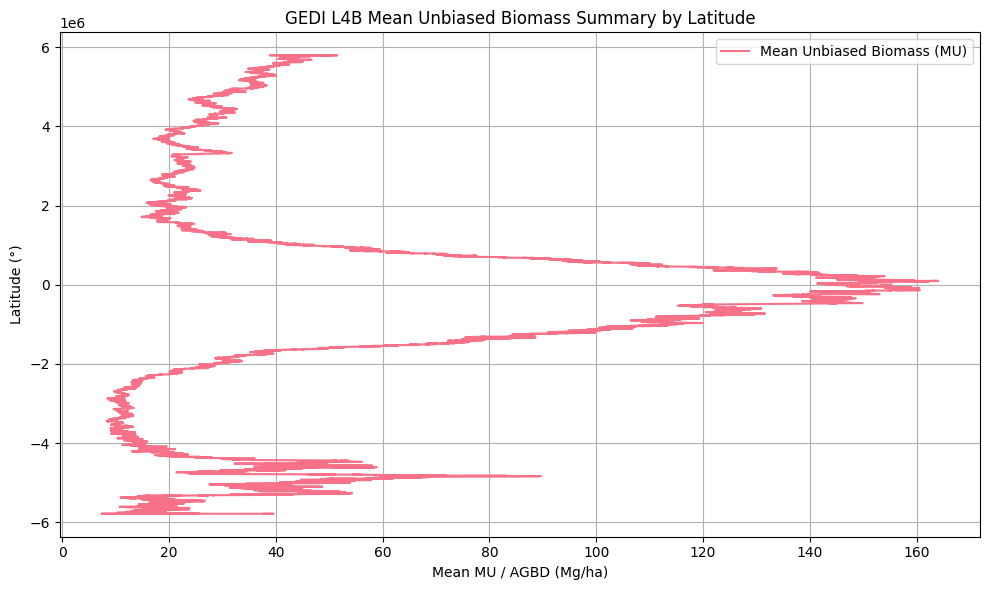

In [ ]:
# ---------------------------
TIF_DIR = OUTPUT_DIR  # Folder containing L4B GeoTIFFs

# ---------------------------
# Step 1: Find the MU.tif file and compute mean MU by latitude (processing row by row)
# ---------------------------
plt.figure(figsize=(10,6))

mu_tif_file = None
for tif_file in os.listdir(TIF_DIR):
    if tif_file.endswith(".tif") and "_MU.tif" in tif_file:
        mu_tif_file = tif_file
        break

if mu_tif_file:
    print(f"Processing {mu_tif_file} row by row to save memory...")
    file_path = os.path.join(TIF_DIR, mu_tif_file)

    try:
        with rasterio.open(file_path) as src:
            nrows, ncols = src.shape
            latitudes = np.linspace(src.bounds.top, src.bounds.bottom, nrows)
            mean_mu_by_lat = [] # List to store mean MU for each row

            # Process data row by row
            for row_index in range(nrows):
                # Read one row of data
                row_data = src.read(1, window=rasterio.windows.Window(0, row_index, ncols, 1))[0]

                # Mask no-data values
                if src.nodata is not None:
                     row_data = np.where(row_data == src.nodata, np.nan, row_data)

                # Compute mean for the row (ignoring NaNs)
                mean_row = np.nanmean(row_data)
                mean_mu_by_lat.append(mean_row)

            # Convert the list to a numpy array
            mean_mu_by_lat = np.array(mean_mu_by_lat)

            plt.plot(mean_mu_by_lat, latitudes, label="Mean Unbiased Biomass (MU)")

        # ---------------------------
        # Step 2: Customize plot
        # ---------------------------
        plt.xlabel("Mean MU / AGBD (Mg/ha)")
        plt.ylabel("Latitude (°)")
        plt.title("GEDI L4B Mean Unbiased Biomass Summary by Latitude")
        plt.legend()
        plt.grid(True)
        plt.tight_layout()
        plt.show()

    except Exception as e:
        print(f"Error processing {mu_tif_file}: {e}")

else:
    print(f"No '_MU.tif' file found in {TIF_DIR}.")

Tropical latitudes (roughly 10°N–10°S) generally have the highest MU because they contain dense tropical forests.

Mid-latitudes (20–40°) show lower MU, reflecting savannas, croplands, and temperate forests.

High latitudes (>50°) show very low MU, since boreal forests are less dense and tundra dominates.

Check out this comprehensive synthesis of how different global biomass datasets represent these latitudinal patterns:

Cherrington, E. A., Evans, C. A., Limaye, A. S., Anderson, E. R., and Flores-Anderson, A. I.: Reviews and syntheses: One forest carbon model to rule them all? Utilizing ensembles of forest cover and biomass datasets to determine carbon budgets of the world’s forest ecosystems, EGUsphere [preprint], https://doi.org/10.5194/egusphere-2024-1179, 2024.



## 6. Define a bounding box for analysis

Update the MIN_LON, MIN_LAT, MAX_LON, and MAX_LAT variables to define the coordinates of your bounding box & display the interactive map in the notebook output, showing the location and extent of your bounding box over the selected basemap.

In [ ]:
# Make sure MIN_LON, MIN_LAT, MAX_LON, MAX_LAT were set by the widget

# Create a list of tuples representing the vertices of the bounding box polygon
bbox_coords = [
    (MIN_LON, MIN_LAT),  # Bottom-left
    (MAX_LON, MIN_LAT),  # Bottom-right
    (MAX_LON, MAX_LAT),  # Top-right
    (MIN_LON, MAX_LAT),  # Top-left
    (MIN_LON, MIN_LAT)   # Closing the polygon
]

# Create a shapely Polygon object from the list of vertices
bbox_polygon = shapely.geometry.Polygon(bbox_coords)

# Calculate the center of the bounding box for map centering
center_lon = (MIN_LON + MAX_LON) / 2
center_lat = (MIN_LAT + MAX_LAT) / 2

# Create a Folium map centered on the bounding box
m = folium.Map(location=[center_lat, center_lon], zoom_start=8, tiles='OpenStreetMap')

# Add the bounding box as a GeoJson layer to the map
GeoJson(bbox_polygon.__geo_interface__, name='Bounding Box').add_to(m)

m.fit_bounds([[MIN_LAT, MIN_LON], [MAX_LAT, MAX_LON]])

# Add layer control to toggle the bounding box layer
folium.LayerControl().add_to(m)

# Display the map
display(m)

## 7. Reduce the GEDI data to that of the bounding box to reduce RAM


In [ ]:
# Define the base directory in your Google Drive where your files are saved
BASE_DRIVE_DIR = "/content/drive/MyDrive/gedi_data_L4B"
OUTPUT_DIR = os.path.join(BASE_DRIVE_DIR, "gedi_L4B")

# --- Use the bounding box from the AOI widget selection ---
# Ensure MIN_LON, MIN_LAT, MAX_LON, MAX_LAT are already set by the widget
if any(v is None for v in [MIN_LON, MIN_LAT, MAX_LON, MAX_LAT]):
    raise ValueError("Bounding box not set. Please select an AOI in the widget first.")

# Create a list of tuples representing the vertices of the bounding box polygon
bbox_coords = [
    (MIN_LON, MIN_LAT),
    (MAX_LON, MIN_LAT),
    (MAX_LON, MAX_LAT),
    (MIN_LON, MAX_LAT),
    (MIN_LON, MIN_LAT)
]

bbox_polygon = shapely.geometry.Polygon(bbox_coords)

# Paths for clipped output files
clipped_mu_output_path = os.path.join(OUTPUT_DIR, "gedi_l4b_clipped_newaoi.tif") #? update so you dont overwrite anything

# Find the MU.tif file
mu_tif_file_path = None
for tif_file in os.listdir(OUTPUT_DIR):
    if tif_file.endswith(".tif") and "_MU.tif" in tif_file:
        mu_tif_file_path = os.path.join(OUTPUT_DIR, tif_file)

if not mu_tif_file_path:
    print(f"No '_MU.tif' file found in {OUTPUT_DIR}.")
if not bbox_polygon:
    print("Bounding box polygon not defined. Please select an AOI first.")

# Create a GeoDataFrame from the bounding box polygon
gdf_bbox = gp.GeoDataFrame([1], geometry=[bbox_polygon], crs="EPSG:4326")

# --- Clip MU.tif ---
if mu_tif_file_path and bbox_polygon:
    print(f"\nClipping {os.path.basename(mu_tif_file_path)} to selected AOI bounding box...")

    try:
        with rasterio.open(mu_tif_file_path) as src:
            print("\nSource MU raster properties:")
            print(f"  CRS: {src.crs}")
            print("-" * 20)

            # Reproject bounding box to raster CRS
            gdf_bbox_reprojected = gdf_bbox.to_crs(src.crs)

            # Get bounds of reprojected bbox
            reprojected_bounds = gdf_bbox_reprojected.geometry.total_bounds  # minx, miny, maxx, maxy

            # Calculate window in the source raster
            window = from_bounds(
                reprojected_bounds[0],
                reprojected_bounds[1],
                reprojected_bounds[2],
                reprojected_bounds[3],
                src.transform
            )
            print(f"\nCalculated window for MU clipping: {window}")

            # Read data within window
            out_image = src.read(1, window=window)

            # Update metadata
            out_meta = src.meta.copy()
            out_meta.update({
                "driver": "GTiff",
                "height": out_image.shape[0],
                "width": out_image.shape[1],
                "transform": src.window_transform(window),
                "crs": src.crs
            })

            # Save clipped raster
            with rasterio.open(clipped_mu_output_path, "w", **out_meta) as dest:
                dest.write(out_image, 1)

            print(f"Clipped MU raster saved to: {clipped_mu_output_path}")

    except Exception as e:
        print(f"Error clipping MU raster: {e}")



Clipping GEDI04_B_MW019MW223_02_002_02_R01000M_MU.tif to selected AOI bounding box...

Source MU raster properties:
  CRS: EPSG:6933
--------------------

Calculated window for MU clipping: Window(col_off=np.float64(8743.47999999909), row_off=np.float64(4977.6218640597435), width=np.float64(183.15999999997803), height=np.float64(341.2913922189746))
Clipped MU raster saved to: /content/drive/MyDrive/gedi_data_L4B/gedi_L4B/gedi_l4b_clipped_newaoi.tif


Displaying clipped MU raster over selected AOI...



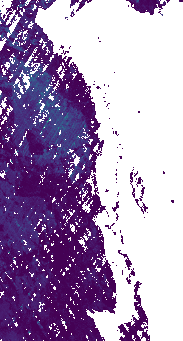

In [ ]:
# Ensure the raster exists
if os.path.exists(clipped_mu_output_path):
    print(f"Displaying clipped MU raster over selected AOI...")

    try:
        # Open the clipped raster
        with rasterio.open(clipped_mu_output_path) as src:
            mu_data = src.read(1)

            # Mask no-data values
            if src.nodata is not None:
                mu_data = np.where(mu_data == src.nodata, np.nan, mu_data)

            # Get bounds
            minx, miny, maxx, maxy = src.bounds

            # Normalize raster for visualization (0-1)
            valid = ~np.isnan(mu_data)
            if valid.any():
                mu_norm = (mu_data - mu_data[valid].min()) / (mu_data[valid].max() - mu_data[valid].min())
            else:
                mu_norm = mu_data

            # Convert to RGBA using matplotlib colormap
            cmap = plt.cm.viridis
            mu_rgba = cmap(mu_norm, bytes=True)  # returns RGBA uint8

            # Flip vertically for correct display
            mu_rgba = np.flipud(mu_rgba)

            # Create Folium map centered on AOI
            center_lon = (MIN_LON + MAX_LON) / 2
            center_lat = (MIN_LAT + MAX_LAT) / 2
            m = folium.Map(location=[center_lat, center_lon], zoom_start=8, tiles='OpenStreetMap')

            # Add raster as image overlay
            img_overlay = ImageOverlay(
                image=mu_rgba,
                bounds=[[miny, minx], [maxy, maxx]],
                opacity=0.7,
                interactive=True,
                name="Clipped MU Raster"
            )
            img_overlay.add_to(m)

            # Add AOI bounding box
            folium.GeoJson(bbox_polygon.__geo_interface__, name="Selected AOI",
                           style_function=lambda x: {"color": "red", "weight": 2, "fill": False}).add_to(m)

            # Add layer control
            folium.LayerControl().add_to(m)

            display(m)

    except Exception as e:
        print(f"Error displaying map: {e}")

else:
    print(f"Clipped MU raster file not found at {clipped_mu_output_path}.")

## 8. Visualize the MU over your aoi to better understand the biomass coverage and distribution.

In this example, the bounding box covers the Central American Country of Belize. In the plot, the Mountain Pine Ridge Forest Reserve is easily identified by the increase in biomass estimates (green to yellow) in the central region.


Visualizing clipped MU raster...
Original data range: [0.0, 1176.877197265625]
Using percentile range [0.00, 328.61] for visualization


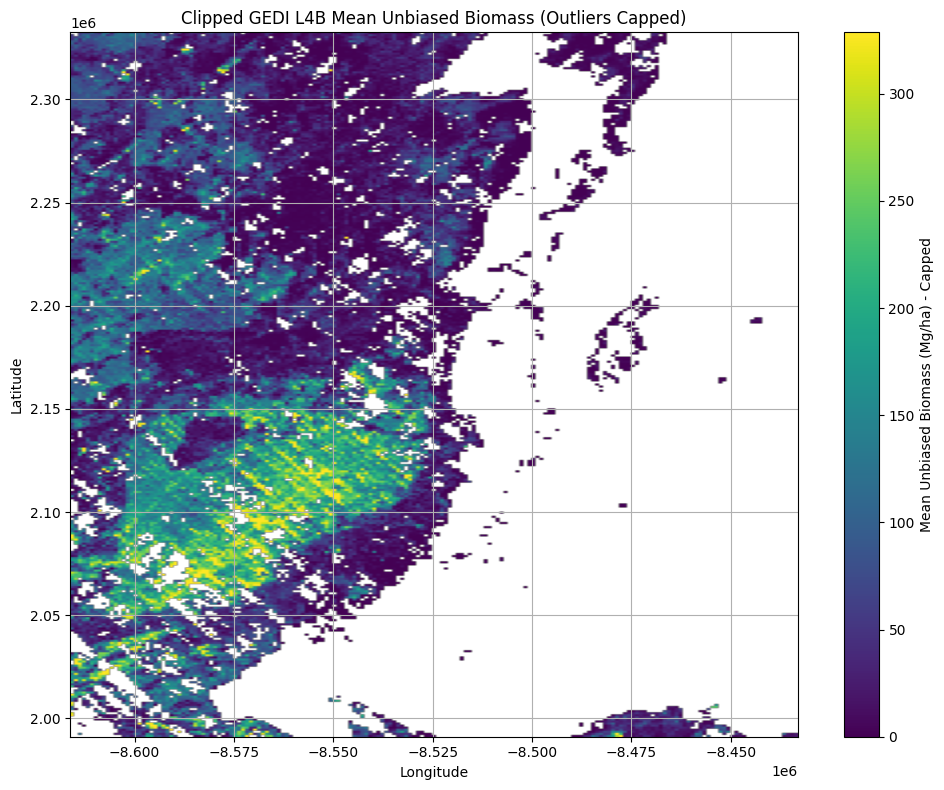

In [ ]:
# Define the base directory in your Google Drive where your files are saved
BASE_DRIVE_DIR = "/content/drive/MyDrive/gedi_data_L4B" #?
OUTPUT_DIR = os.path.join(BASE_DRIVE_DIR, "gedi_L4B")

# Path to the clipped MU raster file
clipped_mu_raster_path = os.path.join(OUTPUT_DIR, "gedi_l4b_clipped_newaoi.tif") #? update

if os.path.exists(clipped_mu_raster_path):
    print(f"Visualizing clipped MU raster...")

    try:
        # Open the clipped MU raster
        with rasterio.open(clipped_mu_raster_path) as src_mu:

            # Read data from the MU raster
            clipped_mu_data = src_mu.read(1)

            # Mask no-data values
            if src_mu.nodata is not None:
                 clipped_mu_data = np.where(clipped_mu_data == src_mu.nodata, np.nan, clipped_mu_data)

            # --- Outlier Removal and Color Scheme Adjustment ---

            # Identify and remove outliers based on percentiles
            # Calculate lower and upper percentiles (e.g., 1st and 99th)
            # Ignore NaN values when calculating percentiles
            valid_mu_data = clipped_mu_data[~np.isnan(clipped_mu_data)]

            if valid_mu_data.size > 0:
                mu_lower = np.percentile(valid_mu_data, 1) # Adjust percentiles
                mu_upper = np.percentile(valid_mu_data, 99)

                print(f"Original data range: [{np.nanmin(clipped_mu_data)}, {np.nanmax(clipped_mu_data)}]")
                print(f"Using percentile range [{mu_lower:.2f}, {mu_upper:.2f}] for visualization")

                # Cap values outside the percentile range for visualization
                # We will create a copy for visualization so the original data is untouched
                mu_viz_data = np.copy(clipped_mu_data)
                mu_viz_data[mu_viz_data < mu_lower] = mu_lower
                mu_viz_data[mu_viz_data > mu_upper] = mu_upper

                # Adjust colormap and normalization
                cmap = plt.cm.viridis # Using a perceptually uniform colormap
                # Normalize colorbar based on the capped range
                mu_norm = Normalize(vmin=mu_lower, vmax=mu_upper)

                # Get spatial extent for plotting
                mu_extent = [src_mu.bounds.left, src_mu.bounds.right, src_mu.bounds.bottom, src_mu.bounds.top]

                # --- Create Single Plot ---
                plt.figure(figsize=(10, 8)) # Create a single figure

                # --- MU Heatmap Plot ---
                im1 = plt.imshow(mu_viz_data, extent=mu_extent, origin='upper', cmap=cmap, norm=mu_norm, aspect='auto') # Use plt.imshow for single plot
                plt.title("Clipped GEDI L4B Mean Unbiased Biomass (Outliers Capped)")
                plt.xlabel("Longitude")
                plt.ylabel("Latitude")
                plt.colorbar(im1, label="Mean Unbiased Biomass (Mg/ha) - Capped") # Use plt.colorbar
                plt.grid(True)

                plt.tight_layout()
                plt.show()
            else:
                print("No valid data found in the clipped raster after masking nodata.")


    except Exception as e:
        print(f"Error visualizing clipped raster: {e}")

else:
    print(f"Clipped MU raster file not found at {clipped_mu_raster_path}.")
    print("Please ensure the clipping step (cell 10016ca6) was successful.")

## Visualize Masked Mean Unbiased (MU) and Standard Error (SE) with Coverage Filter

This section of the script loads the downloaded Mean Unbiased (MU), Standard Error (SE), and potentially a Coverage TIFF file. It clips these rasters to the defined bounding box and then applies a coverage mask (if a coverage file is found and meets a minimum coverage threshold) to the MU and SE data. Finally, it generates side-by-side heatmaps of the masked MU and SE data, with outlier values capped and color schemes adjusted for better visualization.

**Supporting Background:**

When comparing MU (biomass estimates) and SE (uncertainty), you must use the Coverage layer to filter out poorly sampled cells (Coverage < 2). Without this filter, SE values can be invalid or misleading, undermining the reliability of your analysis.

- NASA ORNL DAAC GEDI L4B Data Product Guide:
“The coverage layer represents the number of valid GEDI footprints used in the gridded biomass estimate. Users should consult the coverage data to identify areas where the biomass and standard error estimates are statistically meaningful.”

- GEDI L4B Algorithm Theoretical Basis Document (ATBD):
“Standard errors (SE) are only valid in cells where more than one footprint contributes to the estimate. Users are strongly encouraged to apply the coverage layer when interpreting L4B biomass maps.”
(Dubayah et al., 2022, GEDI L4B ATBD, NASA GSFC).


Using MU file: GEDI04_B_MW019MW223_02_002_02_R01000M_MU.tif
Using SE file: GEDI04_B_MW019MW223_02_002_02_R01000M_SE.tif
Using Coverage file: GEDI04_B_MW019MW223_02_002_02_R01000M_NC.tif

Clipping rasters to selected AOI...

Visualizing clipped rasters...


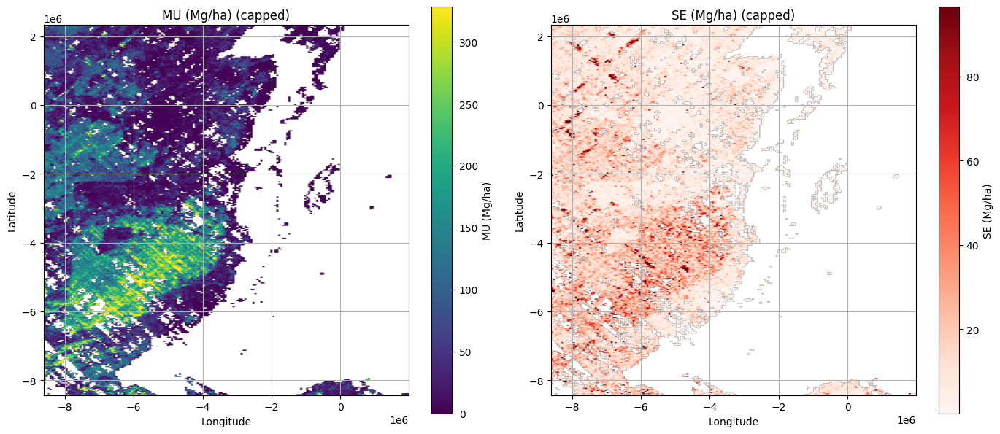

Raster saved to: /content/drive/MyDrive/gedi_data_L4B/gedi_L4B/gedi_l4b_clipped_mu.tif
Raster saved to: /content/drive/MyDrive/gedi_data_L4B/gedi_L4B/gedi_l4b_clipped_se.tif
Raster saved to: /content/drive/MyDrive/gedi_data_L4B/gedi_L4B/gedi_l4b_clipped_cov.tif


In [ ]:
# --- Directories ---
BASE_DRIVE_DIR = "/content/drive/MyDrive/gedi_data_L4B"
OUTPUT_DIR = os.path.join(BASE_DRIVE_DIR, "gedi_L4B")
TIF_DIR = OUTPUT_DIR  # folder containing L4B GeoTIFFs

# --- Ensure AOI bounding box from widget is set ---
if any(v is None for v in [MIN_LON, MIN_LAT, MAX_LON, MAX_LAT]):
    raise ValueError("Bounding box not set. Please select an AOI in the widget first.")

# --- Create bounding box geometry from widget ---
bbox = [MIN_LON, MIN_LAT, MAX_LON, MAX_LAT]
geom = box(*bbox)
gdf_bbox = gp.GeoDataFrame({"geometry": [geom]}, crs="EPSG:4326")
clip_geometries = [geom for geom in gdf_bbox.geometry]

# --- Find MU, SE, and Coverage files ---
MU_TIF = SE_TIF = COV_TIF = None
for tif_file in os.listdir(TIF_DIR):
    if tif_file.endswith(".tif"):
        if "_MU.tif" in tif_file:
            MU_TIF = os.path.join(TIF_DIR, tif_file)
        elif "_SE.tif" in tif_file:
            SE_TIF = os.path.join(TIF_DIR, tif_file)
        elif "_NC.tif" in tif_file:
            COV_TIF = os.path.join(TIF_DIR, tif_file)

if MU_TIF is None or SE_TIF is None:
    raise FileNotFoundError("Could not find required MU and SE raster files.")

print(f"Using MU file: {os.path.basename(MU_TIF)}")
print(f"Using SE file: {os.path.basename(SE_TIF)}")
if COV_TIF:
    print(f"Using Coverage file: {os.path.basename(COV_TIF)}")
else:
    print("No Coverage file found. Masking will be skipped.")

# --- Load rasters ---
mu = rioxarray.open_rasterio(MU_TIF, masked=True, chunks='auto').squeeze()
se = rioxarray.open_rasterio(SE_TIF, masked=True, chunks='auto').squeeze()
cov = rioxarray.open_rasterio(COV_TIF, masked=True, chunks='auto').squeeze() if COV_TIF else None

# --- Clip rasters to AOI ---
print("\nClipping rasters to selected AOI...")
mu_clip = mu.rio.clip(clip_geometries, gdf_bbox.crs)
se_clip = se.rio.clip(clip_geometries, gdf_bbox.crs)
cov_clip = cov.rio.clip(clip_geometries, gdf_bbox.crs) if cov is not None else None

# --- Mask low-coverage cells ---
MIN_COVERAGE = 2
if cov_clip is not None:
    mask = cov_clip >= MIN_COVERAGE
    mu_masked = mu_clip.where(mask, drop=False)
    se_masked = se_clip.where(mask, drop=False)
else:
    mu_masked = mu_clip
    se_masked = se_clip

# --- Plot MU and SE rasters ---
print("\nVisualizing clipped rasters...")
fig, axes = plt.subplots(1, 2, figsize=(14, 6))

def plot_raster(ax, data, title, cmap):
    valid_vals = data.values[~np.isnan(data.values)]
    if valid_vals.size > 0:
        lower, upper = np.percentile(valid_vals, [1, 99])
        data_viz = np.clip(data.values, lower, upper)
        norm = Normalize(vmin=lower, vmax=upper)
        im = ax.imshow(data_viz, extent=data.rio.bounds(), origin='upper', cmap=cmap, norm=norm)
        ax.set_title(f"{title} (capped)")
        ax.set_xlabel("Longitude")
        ax.set_ylabel("Latitude")
        fig.colorbar(im, ax=ax, label=title)
        ax.grid(True)
    else:
        ax.set_title(f"{title} (No valid data)")
        ax.set_xlabel("Longitude")
        ax.set_ylabel("Latitude")

plot_raster(axes[0], mu_masked, "MU (Mg/ha)", cmap="viridis")
plot_raster(axes[1], se_masked, "SE (Mg/ha)", cmap="Reds")

plt.tight_layout()
plt.show()

# --- Optional: Save clipped rasters ---
def save_raster_rioxarray(dataarray, output_path, driver="GTiff"):
    """
    Save a single-band RasterArray/DataArray to a GeoTIFF using rasterio.
    """
    meta = {
        "driver": driver,
        "height": dataarray.rio.height,
        "width": dataarray.rio.width,
        "count": 1,
        "dtype": dataarray.dtype,
        "crs": dataarray.rio.crs,
        "transform": dataarray.rio.transform(),
    }

    with rasterio.open(output_path, "w", **meta) as dst:
        dst.write(dataarray.values, 1)

    print(f"Raster saved to: {output_path}")

# Paths
mu_output_path = os.path.join(OUTPUT_DIR, "gedi_l4b_clipped_mu.tif")
se_output_path = os.path.join(OUTPUT_DIR, "gedi_l4b_clipped_se.tif")
cov_output_path = os.path.join(OUTPUT_DIR, "gedi_l4b_clipped_cov.tif") if cov_clip is not None else None

# Save rasters
save_raster_rioxarray(mu_masked, mu_output_path)
save_raster_rioxarray(se_masked, se_output_path)
if cov_clip is not None:
    save_raster_rioxarray(cov_clip, cov_output_path)

